# Used Car Prices CarGurus: Catboost GPU
## Weights & Biases Optuna Hyperparameter Optimization

## Set Up Environment, Read Data, Prepare for Modeling

# Quadro RTX 4000

In [ ]:
# Install/import dependencies
!pip install --upgrade pip
!pip install --upgrade -q wandb
!pip install catboost
!pip install optuna
!pip install plotly
!pip install eli5
!pip install shap
import os
import warnings
import random
import numpy as np
import cupy 
from cupy import asnumpy
import dask
from dask.distributed import Client, wait
from dask.diagnostics import ProgressBar
from dask_cuda import LocalCUDACluster
import dask_cudf
import urllib.request
from contextlib import contextmanager
import time
from datetime import datetime, timedelta
from timeit import default_timer as timer
import joblib
import cudf
import cuml
from sklearn.model_selection import train_test_split
from catboost import CatBoostRegressor, Pool
import optuna
from optuna import Trial
optuna.logging.set_verbosity(optuna.logging.WARNING) 
import wandb
from optuna.integration.wandb import WeightsAndBiasesCallback
import pickle
import pandas as pd
import plotly.offline as py
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
import matplotlib.pyplot as plt
import seaborn as sns
import eli5 
from eli5.sklearn import PermutationImportance 
import webbrowser
from eli5.formatters import format_as_dataframe
warnings.filterwarnings('ignore')
my_dpi = 96
os.environ['CUDA_VISIBLE_DEVICES'] = '0'
print('\n')
!nvidia-smi



Tue Jan 31 01:19:41 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 510.73.05    Driver Version: 510.73.05    CUDA Version: 11.6     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Quadro RTX 4000     Off  | 00000000:00:05.0 Off |                  N/A |
| 30%   39C    P8     6W / 125W |   1101MiB /  8192MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-----

In [ ]:
# Set seed 
seed_value = 42
os.environ['UsedCarsCarGurus_CatboostGPU'] = str(seed_value)
random.seed(seed_value)
np.random.seed(seed_value)

In [ ]:
# Set up local CUDA cluster for Dask
cluster = LocalCUDACluster(threads_per_worker=1, ip='', 
                           dashboard_address='8082') 
c = Client(cluster)

# Query the client for all connected workers
workers = c.has_what().keys()
n_workers = len(workers)
c

distributed.diskutils - INFO - Found stale lock file and directory '/notebooks/UsedCarsCarGurus/Models/ML/Catboost/Optuna/Notebooks_Scripts/dask-worker-space/worker-_pyo2qd_', purging
distributed.preloading - INFO - Import preload module: dask_cuda.initialize


Connection method: Cluster object,Cluster type: dask_cuda.LocalCUDACluster
Dashboard: http://10.42.88.176:8082/status,
Dashboard: http://10.42.88.176:8082/status,Workers: 1
Total threads: 1,Total memory: 26.44 GiB
Status: running,Using processes: True
Comm: tcp://10.42.88.176:45085,Workers: 1
Dashboard: http://10.42.88.176:8082/status,Total threads: 1
Started: Just now,Total memory: 26.44 GiB
Comm: tcp://10.42.88.176:46775,Total threads: 1
Dashboard: http://10.42.88.176:43587/status,Memory: 26.44 GiB
Nanny: tcp://10.42.88.176:35885,


In [ ]:
# Define function to time code blocks
@contextmanager
def timed(name):
    t0 = time.time()
    yield
    t1 = time.time()
    print('..%-24s:  %8.4f' % (name, t1 - t0))

In [ ]:
%cd /notebooks/UsedCarsCarGurus/Data/

/notebooks/UsedCarsCarGurus/Data


In [ ]:
# Read data 
trainDF = cudf.read_csv('usedCars_trainSet.csv', low_memory=False)
testDF = cudf.read_csv('usedCars_testSet.csv', low_memory=False)

# Define label and features
train_label = trainDF[['price']]
test_label = testDF[['price']]

train_features = trainDF.drop(columns = ['price'])
test_features = testDF.drop(columns = ['price'])

# Create dummy variables for categorical variables
train_features = cudf.get_dummies(train_features)
test_features = cudf.get_dummies(test_features)

(260305, 28)

In [ ]:
# Define label and features
train_Features, val_features, train_Label, val_label = train_test_split(train_features, 
                                                                        train_label, 
                                                                        test_size=0.2, 
                                                                        random_state=seed_value)

In [ ]:
# Convert data type for modeling
train_features = train_features.astype('float32')
train_label = train_label.astype('int32')
train_features = train_features.to_numpy()
train_label = train_label.to_numpy()

train_Features = train_Features.astype('float32')
train_Label = train_Label.astype('int32')
train_Features = train_Features.to_numpy()
train_Label = train_Label.to_numpy()

val_features = val_features.astype('float32')
val_label = val_label.astype('int32')
val_features = val_features.to_numpy()
val_label = val_label.to_numpy()

test_features = test_features.astype('float32')
test_label = test_label.astype('int32')
test_features = test_features.to_numpy()
test_label = test_label.to_numpy()

## 100 Trials Train/Test Pool

In [ ]:
# Create pool of train/test sets
train_data = Pool(train_features, train_label)
eval_data = Pool(test_features, test_label)

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/Catboost/Optuna/Model_PKL

/notebooks/UsedCarsCarGurus/Models/ML/Catboost/Optuna/Model_PKL


In [ ]:
# Set up wandb
wandb.login()

wandb_kwargs = {'project': 'usedCars_hpo', 'entity': 'aschultz', 
                'group': 'optuna_cat100gpu_RTX4000_trainTestPool_cuml', 
                'save_code': 'False', 
                'notes': 'optuna_cat100gpu_RTX4000_trainTestPool_cuml'}
wandbc = WeightsAndBiasesCallback(wandb_kwargs=wandb_kwargs, as_multirun=True)

wandb: Currently logged in as: aschultz. Use `wandb login --relogin` to force relogin


In [ ]:
# Set up WB callbacks
@wandbc.track_in_wandb()

# Define a function for optimization of hyperparameters
def objective(trial):
    """
    Objective function to tune a `CatBoostRegressor` model.
    """
    joblib.dump(study, 'Cat_Optuna_100_GPU_wb_trainTest_RTX4000_cuml.pkl')

# Define parameter grid
    catboost_tune_kwargs = {
        'random_state': seed_value,
        'task_type':'GPU',
        'n_estimators': trial.suggest_int('n_estimators', 100, 500),
        'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 0.3),       
        'depth': trial.suggest_int('depth', 3, 10),
        'l2_leaf_reg': trial.suggest_float('l2_leaf_reg', 1e-2, 1e0),
        'min_data_in_leaf': trial.suggest_int('min_data_in_leaf', 2, 20),
        'one_hot_max_size': trial.suggest_int('one_hot_max_size', 2, 20), 
        'boosting_type': trial.suggest_categorical('boosting_type', 
                                                   ['Ordered', 'Plain']),
        'bootstrap_type': trial.suggest_categorical('bootstrap_type', 
                                                    ['Bayesian', 'Bernoulli', 
                                                     'MVS'])
        }   

    # Conditional Hyperparameters
    if catboost_tune_kwargs['bootstrap_type'] == 'Bayesian':
      catboost_tune_kwargs['bagging_temperature'] = trial.suggest_float('bagging_temperature', 
                                                                        0, 10)
    elif catboost_tune_kwargs['bootstrap_type'] == 'Bernoulli':
      catboost_tune_kwargs['subsample'] = trial.suggest_float('subsample', 
                                                              0.1, 1)
    
    # Define model type
    model = CatBoostRegressor(loss_function='RMSE', 
                              early_stopping_rounds=10,
                              rsm=1, 
                              logging_level='Silent',
                              **catboost_tune_kwargs)

    # Start timer for each trial
    start = timer()
    
    # Train the model
    model.fit(X=train_data, eval_set=eval_data)    
    run_time = timer() - start

    # Predictions
    y_pred_val = model.predict(test_features)
    rmse = mean_squared_error(asnumpy(test_label), asnumpy(y_pred_val), 
                              squared=False)
    print('- Trial RMSE:', rmse)  
    
    return rmse

In [ ]:
# Begin HPO trials 
# Start timer for experiment
start_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
if os.path.isfile('Cat_Optuna_100_GPU_wb_trainTest_RTX4000_cuml.pkl'):
    study = joblib.load('Cat_Optuna_100_GPU_wb_trainTest_RTX4000_cuml.pkl')
else:
    study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=100, callbacks=[wandbc])

# End timer for experiment
end_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
print('%-20s %s' % ('End Time', end_time))
print(str(timedelta(seconds=(end_time-start_time).seconds)))
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Lowest RMSE', study.best_value)
wandb.finish()

Start Time           2023-01-13 01:12:10.217321


- Trial RMSE: 9350.421945959257


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,MVS
depth,5


- Trial RMSE: 7458.222935177158


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 4069.2755308059595


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 9391.363403571673


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,MVS
depth,10


- Trial RMSE: 3353.1732715526655


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 4187.513958325962


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 3609.7514631585595


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 6637.560725370129


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 9214.983430710425


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,MVS
depth,8


- Trial RMSE: 2749.1806165857383


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,0.20474
boosting_type,Plain


- Trial RMSE: 2721.1901983372104


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,0.30467
boosting_type,Plain


- Trial RMSE: 2790.0515760509


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,0.19892
boosting_type,Plain


- Trial RMSE: 2684.945186009043


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,0.37908
boosting_type,Plain


- Trial RMSE: 3325.142370580864


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,4.00314
boosting_type,Plain


- Trial RMSE: 3283.86280550145


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,9.47243
boosting_type,Plain


- Trial RMSE: 3076.250772081034


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,2.64554
boosting_type,Plain


- Trial RMSE: 2642.4664210013443


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,1.91023
boosting_type,Plain


- Trial RMSE: 7003.65505882028


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,2.78291
boosting_type,Plain


- Trial RMSE: 6545.008948451377


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,6.51971
boosting_type,Plain


- Trial RMSE: 3493.031559609506


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,2.19793
boosting_type,Plain


- Trial RMSE: 3235.7534214626344


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,5.57148
boosting_type,Plain


- Trial RMSE: 2555.0082361534164


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,0.02019
boosting_type,Plain


- Trial RMSE: 2877.691491195647


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,1.52039
boosting_type,Plain


- Trial RMSE: 2546.552640644983


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,1.4207
boosting_type,Plain


- Trial RMSE: 2815.618418463194


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,3.73977
boosting_type,Plain


- Trial RMSE: 3096.3030223260566


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,MVS
depth,9


- Trial RMSE: 2603.496045446145


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,1.52729
boosting_type,Plain


- Trial RMSE: 2645.455638474577


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,1.4694
boosting_type,Plain


- Trial RMSE: 2585.1366638052136


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,1.29138
boosting_type,Plain


- Trial RMSE: 3135.842718160624


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,MVS
depth,8


- Trial RMSE: 5186.4852681212205


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,7.86755
boosting_type,Plain


- Trial RMSE: 2636.3006661485056


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,1.27428
boosting_type,Plain


- Trial RMSE: 2752.975134443456


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,3.57001
boosting_type,Plain


- Trial RMSE: 8403.434044303394


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,1.15646
boosting_type,Plain


- Trial RMSE: 3091.655580291122


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,MVS
depth,6


- Trial RMSE: 2749.9711832915136


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,1.00419
boosting_type,Plain


- Trial RMSE: 2582.8517367657255


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 3281.2791184353155


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2852.7627234379015


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 3559.0619901848677


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 8719.82767757348


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2586.7284785610555


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2593.85394125961


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2616.166015351954


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2598.2398950964684


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2615.8296802018094


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2745.827370136855


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 4010.2895018367863


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2921.185932722115


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,MVS
depth,8


- Trial RMSE: 2613.991204812662


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 6991.818576781279


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2606.9824572472608


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2600.740951679803


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2565.9438503521455


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2513.5880796589713


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2569.149621193382


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2455.290520032484


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2436.5258174973287


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2435.059008531758


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2461.9774325508115


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2436.890973763013


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2431.1245583495297


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2449.629559067298


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2443.2810434921744


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2421.7102634272246


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2449.2536792557717


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2439.1711643179906


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2458.838431310509


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2532.7151535435805


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2440.6490139119496


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2664.789381578442


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2457.235911918182


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2439.047843357696


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2501.4875419695663


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2442.7050779773763


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2429.282958493625


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2639.8968270826354


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,MVS
depth,10


- Trial RMSE: 2438.4781372625266


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2446.7399614885917


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2533.268137016886


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2549.317916129836


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2431.8829227751626


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2420.1331065342756


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2446.900025153425


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2425.4932848425906


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2421.315903186868


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2642.5288857255


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,MVS
depth,10


- Trial RMSE: 2494.6394579388298


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2433.053823654042


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2518.384104894865


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2425.8303401501976


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2428.213571200791


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2964.7583521435286


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2457.9368030405612


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2491.8428578980615


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 3038.8077949808476


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2441.161312920171


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2428.367364710192


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2420.2300377914407


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 6530.949954507583


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,MVS
depth,10


Start Time           2023-01-13 01:12:10.217321
End Time             2023-01-13 02:04:33.277926
0:52:23


Number of finished trials: 100
Best trial: {'n_estimators': 491, 'learning_rate': 0.1692468446695709, 'depth': 10, 'l2_leaf_reg': 0.10865364065874268, 'min_data_in_leaf': 8, 'one_hot_max_size': 4, 'boosting_type': 'Plain', 'bootstrap_type': 'Bernoulli', 'subsample': 0.6593575604816039}
Lowest RMSE 2420.1331065342756


In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/Catboost/Optuna/trialOptions/

/notebooks/UsedCarsCarGurus/Models/ML/Catboost/Optuna/trialOptions


In [ ]:
# Output from HPO trials
trials_df = study.trials_dataframe()
trials_df.rename(columns={'number': 'iteration'}, inplace=True)
trials_df.rename(columns={'value': 'rmse'}, inplace=True)
trials_df.rename(columns={'params_bagging_temperature': 'bagging_temperature'}, 
                 inplace=True)
trials_df.rename(columns={'params_boosting_type': 'boosting_type'}, 
                 inplace=True)
trials_df.rename(columns={'params_bootstrap_type': 'bootstrap_type'}, 
                 inplace=True)
trials_df.rename(columns={'params_depth': 'depth'}, inplace=True)
trials_df.rename(columns={'params_l2_leaf_reg': 'l2_leaf_reg'}, inplace=True)
trials_df.rename(columns={'params_learning_rate': 'learning_rate'}, 
                 inplace=True)
trials_df.rename(columns={'params_min_data_in_leaf': 'min_data_in_leaf'}, 
                 inplace=True)
trials_df.rename(columns={'params_n_estimators': 'n_estimators'}, inplace=True)
trials_df.rename(columns={'params_one_hot_max_size': 'one_hot_max_size'}, 
                 inplace=True)
trials_df.rename(columns={'params_subsample': 'subsample'}, inplace=True)
trials_df = trials_df.sort_values('rmse', ascending=True)
print(trials_df) 

# Write processed data to csv
trials_df.to_csv('Catboost_Optuna_100_GPU_wb_trainTestPool_RTX4000_cuml.csv', 
                 index=False)

    iteration         rmse             datetime_start  \
82         82  2420.133107 2023-01-13 01:55:00.041096   
98         98  2420.230038 2023-01-13 02:03:31.138605   
85         85  2421.315903 2023-01-13 01:56:40.191723   
64         64  2421.710263 2023-01-13 01:45:05.799085   
84         84  2425.493285 2023-01-13 01:56:08.502497   
..        ...          ...                        ...   
33         33  8403.434044 2023-01-13 01:28:27.803323   
40         40  8719.827678 2023-01-13 01:32:12.079566   
8           8  9214.983431 2023-01-13 01:17:02.457225   
0           0  9350.421946 2023-01-13 01:12:10.219131   
3           3  9391.363404 2023-01-13 01:13:58.788706   

            datetime_complete               duration  bagging_temperature  \
82 2023-01-13 01:55:26.063957 0 days 00:00:26.022861                  NaN   
98 2023-01-13 02:03:56.152843 0 days 00:00:25.014238                  NaN   
85 2023-01-13 01:57:05.377379 0 days 00:00:25.185656                  NaN   
64 2023

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/Catboost/Optuna/Model_Explanations/

/notebooks/UsedCarsCarGurus/Models/ML/Catboost/Optuna/Model_Explanations


In [ ]:
# Plot_optimization_history: shows the scores from all trials as well as the best score so far at each point.
fig = optuna.visualization.plot_optimization_history(study)
py.plot(fig, filename='optimizationHistory_Catboost_Optuna_100_GPU_wb_trainTestPool_RTX4000_cuml.html')
fig.show()

In [ ]:
# plot_parallel_coordinate: interactively visualizes the hyperparameters and scores
fig = optuna.visualization.plot_parallel_coordinate(study)
py.plot(fig, filename='parallelCoordinate_Catboost_Optuna_100_GPU_wb_trainTestPool_RTX4000_cuml.html')
fig.show()

[W 2023-01-13 02:04:34,399] Your study has only completed trials with missing parameters.


In [ ]:
# plot_slice: shows the change of the hyperparameters space over the search. 
fig = optuna.visualization.plot_slice(study)
py.plot(fig, filename='slice_Catboost_Optuna_100_GPU_wb_trainTestPool_RTX4000_cuml.html')
fig.show()

In [ ]:
# plot_contour: plots parameter interactions on an interactive chart
fig = optuna.visualization.plot_contour(study, params=['depth', 
                                                       'subsample', 
                                                       'learning_rate', 
                                                       'subsample'])
py.plot(fig, filename='contour_Catboost_Optuna_100_GPU_wb_trainTestPool_RTX4000_cuml.html')
fig.show()

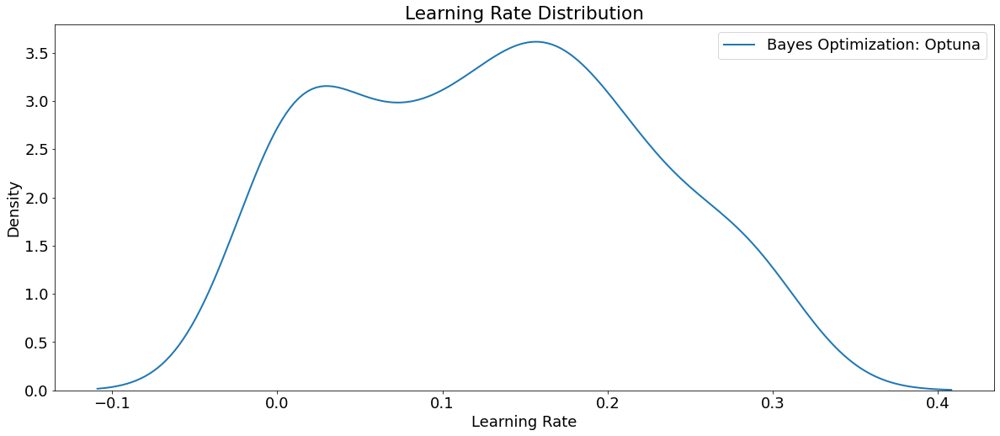

In [ ]:
# Density plots of the learning rate distributions 
plt.figure(figsize=(20,8))
plt.rcParams['font.size'] = 18
sns.kdeplot(trials_df['learning_rate'], label='Bayes Optimization: Optuna', 
            linewidth=2)
plt.legend(loc=1)
plt.xlabel('Learning Rate'); plt.ylabel('Density'); plt.title('Learning Rate Distribution');
plt.show()

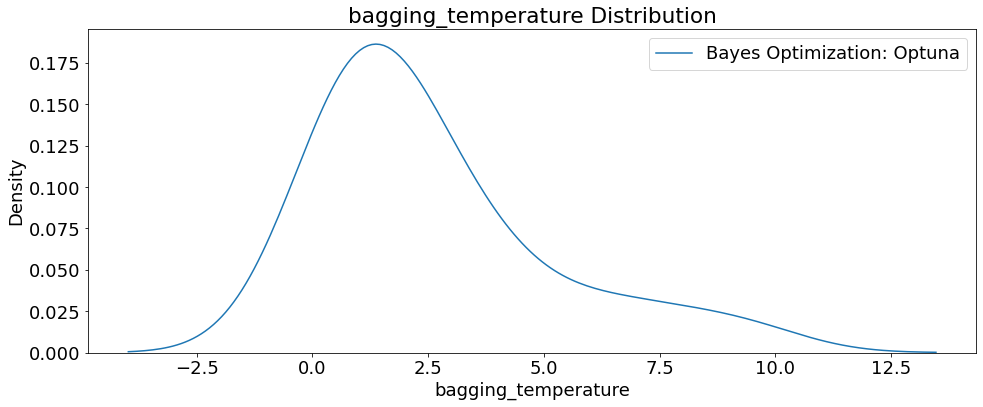

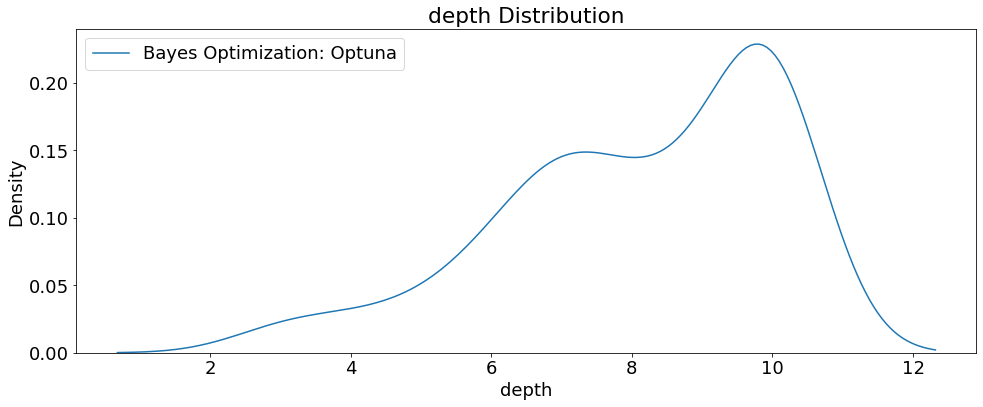

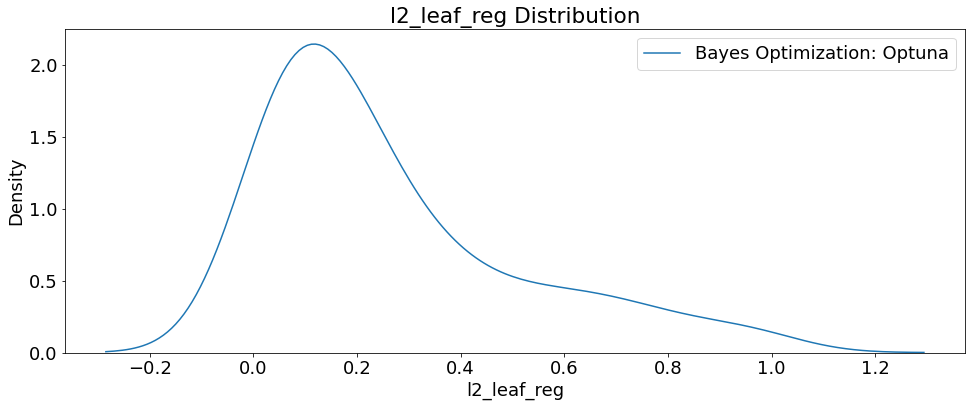

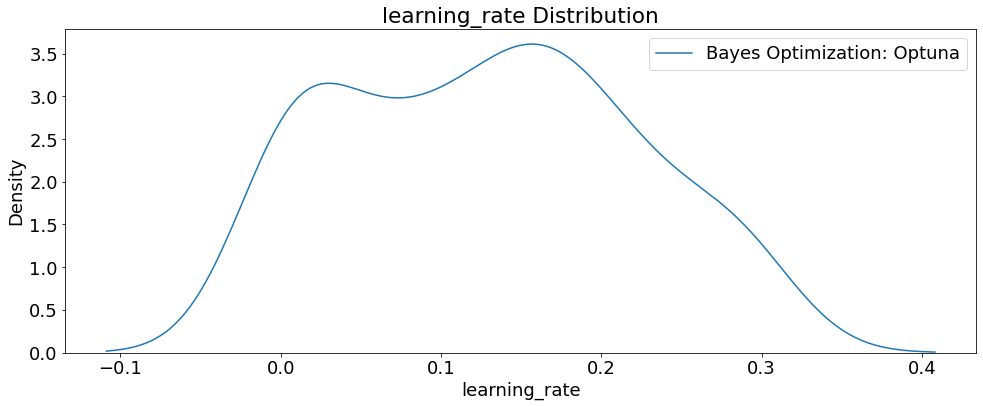

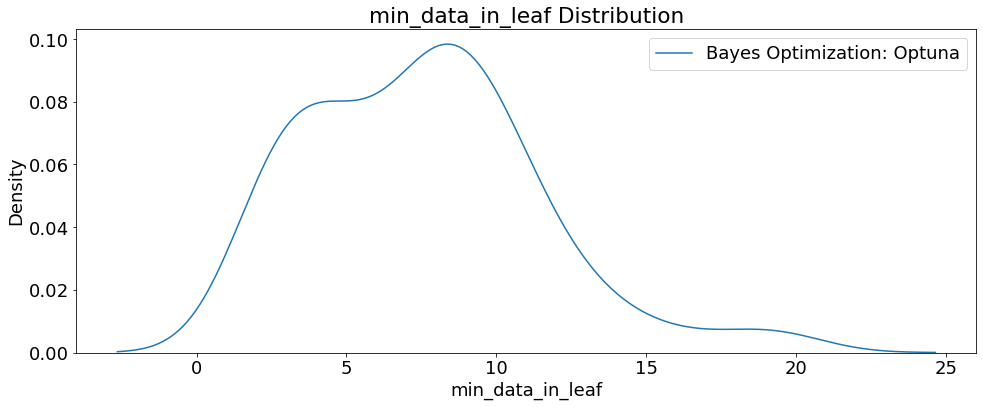

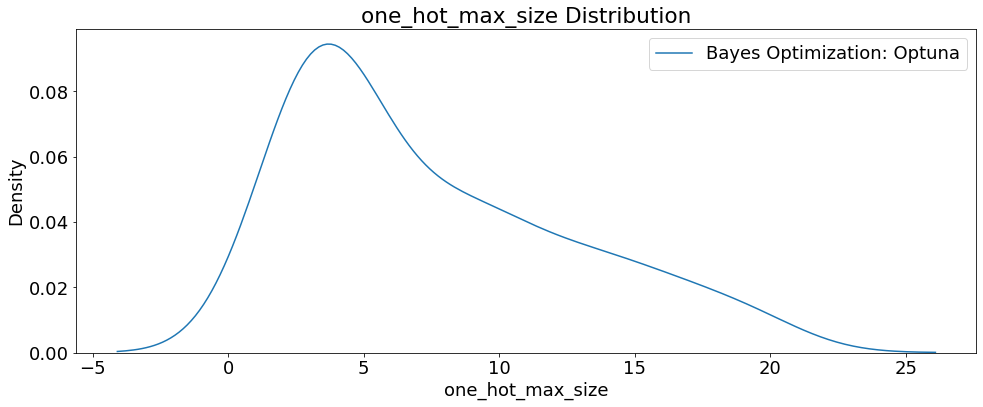

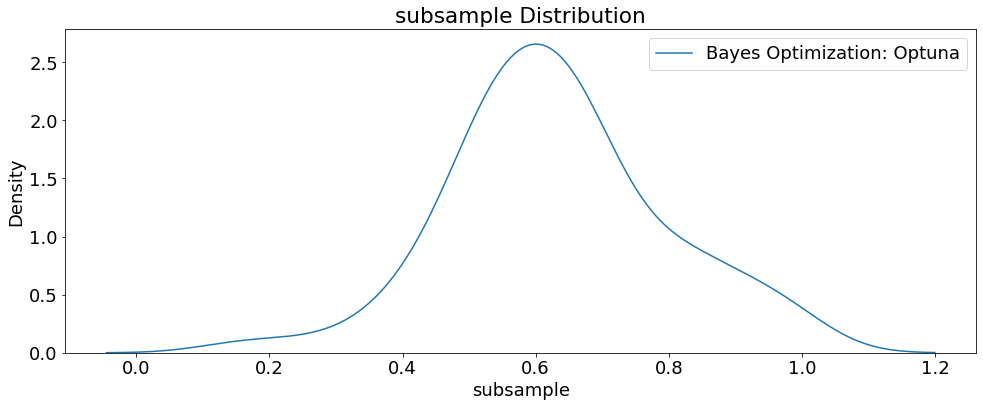

In [ ]:
# Create plots of Hyperparameters that are numeric 
for i, hpo in enumerate(trials_df.columns):
    if hpo not in ['iteration', 'rmse', 'datetime_start', 'datetime_complete',
                   'duration', 'n_estimators', 'state', 'boosting_type',
                   'bootstrap_type']:
        plt.figure(figsize=(14,6))
        # Plot the bayes search distribution
        if hpo != 'loss':
            sns.kdeplot(trials_df[hpo], label='Bayes Optimization: Optuna')
            plt.legend(loc=0)
            plt.title('{} Distribution'.format(hpo))
            plt.xlabel('{}'.format(hpo)); plt.ylabel('Density')
            plt.tight_layout()
            plt.show()

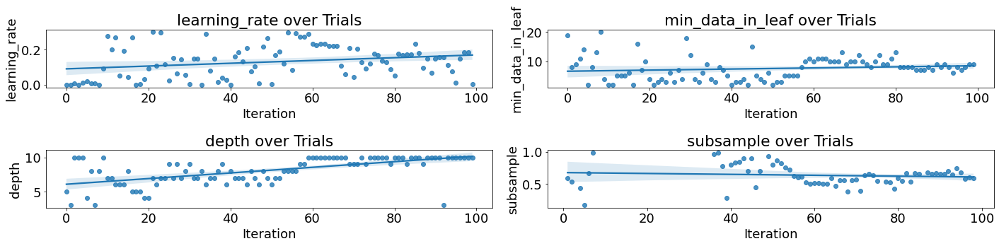

In [ ]:
# Plot quantitive hyperparameters
fig, axs = plt.subplots(2, 2, figsize=(20,5))
i = 0
axs = axs.flatten()
for i, hpo in enumerate(['learning_rate', 'min_data_in_leaf', 
                         'depth', 'subsample']):
  # Scatterplot
  sns.regplot('iteration', hpo, data=trials_df, ax=axs[i]) 
  axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo),  
             title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

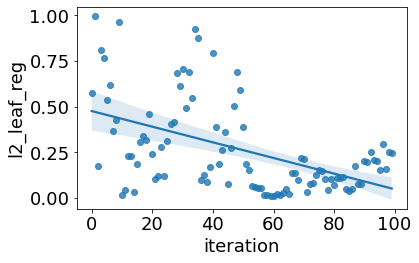

In [ ]:
# Scatterplot of regularization hyperparameters
ax = sns.regplot(x='iteration', y='l2_leaf_reg', data=trials_df)
plt.tight_layout()
plt.show()

In [ ]:
# Visualize parameter importances
fig = optuna.visualization.plot_param_importances(study)
py.plot(fig, filename='paramImportance_Catboost_Optuna_100_GPU_wb_trainTestPool_RTX4000_cuml.html')
fig.show()

In [ ]:
# Visualize empirical distribution function
fig = optuna.visualization.plot_edf(study)
py.plot(fig, filename='edf_Catboost_Optuna_100_GPU_wb_trainTestPool_RTX4000_cuml.html')
fig.show()

In [ ]:
# Arrange best parameters to fit model for model metrics
params = study.best_params   
params['random_state'] = seed_value
params

{'n_estimators': 491,
 'learning_rate': 0.1692468446695709,
 'depth': 10,
 'l2_leaf_reg': 0.10865364065874268,
 'min_data_in_leaf': 8,
 'one_hot_max_size': 4,
 'boosting_type': 'Plain',
 'bootstrap_type': 'Bernoulli',
 'subsample': 0.6593575604816039,
 'random_state': 42}

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/Catboost/Optuna/Model_PKL/

/notebooks/UsedCarsCarGurus/Models/ML/Catboost/Optuna/Model_PKL


In [ ]:
# Re-create the best model and train on the training data
best_model = CatBoostRegressor(loss_function='RMSE', 
                               task_type='GPU',
                               early_stopping_rounds=10, 
                               rsm=1, 
                               logging_level='Silent', 
                               **params)

# Fit the model
best_model.fit(train_features, train_label)

# Save model
Pkl_Filename = 'Catboost_Optuna_trials100_GPU_wb_trainTestPool_RTX4000_cuml.pkl'  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(best_model, file)

# =============================================================================
# # To load saved model
# model = joblib.load('Catboost_Optuna_trials100_GPU_wb_trainTestPool_RTX4000_cuml.pkl')
# print(model)
# =============================================================================

In [ ]:
print('\nModel Metrics for Catboost HPO 100 GPU trials')
y_train_pred = best_model.predict(train_features)
y_test_pred = best_model.predict(test_features)

print('MAE train: %.3f, test: %.3f' % (
        mean_absolute_error(train_label, y_train_pred),
        mean_absolute_error(test_label, y_test_pred)))
print('MSE train: %.3f, test: %.3f' % (
        mean_squared_error(train_label, y_train_pred),
        mean_squared_error(test_label, y_test_pred)))
print('RMSE train: %.3f, test: %.3f' % (
        mean_squared_error(train_label, y_train_pred, squared=False),
        mean_squared_error(test_label, y_test_pred, squared=False)))
print('R^2 train: %.3f, test: %.3f' % (
        r2_score(train_label, y_train_pred),
        r2_score(test_label, y_test_pred)))


Model Metrics for Catboost HPO 100 GPU trials
MAE train: 1567.886, test: 1789.211
MSE train: 4412979.129, test: 5857044.253
RMSE train: 2100.709, test: 2420.133
R^2 train: 0.952, test: 0.936


In [ ]:
# Evaluate on the testing data 
print('The best model from optimization scores {:.5f} MSE on the test set.'.format(mean_squared_error(asnumpy(test_label), 
                                                                                                      asnumpy(y_test_pred))))
print('This was achieved using these conditions:')
print(trials_df.iloc[0])

The best model from optimization scores 5857044.25334 MSE on the test set.
This was achieved using these conditions:
iteration                                      83
rmse                                  2443.635532
datetime_start         2023-01-13 02:58:25.658371
datetime_complete      2023-01-13 02:58:50.762948
duration                   0 days 00:00:25.104577
bagging_temperature                           NaN
boosting_type                               Plain
bootstrap_type                          Bernoulli
depth                                          10
l2_leaf_reg                              0.536227
learning_rate                            0.238846
min_data_in_leaf                                8
n_estimators                                  429
one_hot_max_size                                6
subsample                                0.872795
state                                    COMPLETE
Name: 83, dtype: object


## 100 Trials Train/Validation/Test Pool

In [ ]:
# Create pool of train/test sets
train_data = Pool(train_Features, train_Label)
eval_data = Pool(val_features, val_label)

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/Catboost/Optuna/Model_PKL

/notebooks/UsedCarsCarGurus/Models/ML/Catboost/Optuna/Model_PKL


In [ ]:
# Set up wandb
wandb.login()

wandb_kwargs = {'project': 'usedCars_hpo', 'entity': 'aschultz', 
                'group': 'optuna_cat100gpu_RTX4000_trainValTestPool_cuml', 
                'save_code': 'False', 
                'notes': 'optuna_cat100gpu_RTX4000_trainValTestPool_cuml'}
wandbc = WeightsAndBiasesCallback(wandb_kwargs=wandb_kwargs, as_multirun=True)

In [ ]:
# Set up WB callbacks
@wandbc.track_in_wandb()

# Define a function for optimization of hyperparameters
def objective(trial):
    """
    Objective function to tune a `CatBoostRegressor` model.
    """
    joblib.dump(study, 'Cat_Optuna_100_GPU_wb_trainValTest_RTX4000_cuml.pkl')


# Define parameter grid
    catboost_tune_kwargs = {
        'random_state': seed_value,
        'task_type':'GPU',
        'n_estimators': trial.suggest_int('n_estimators', 100, 500),
        'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 0.3),       
        'depth': trial.suggest_int('depth', 3, 10),
        'l2_leaf_reg': trial.suggest_float('l2_leaf_reg', 1e-2, 1e0),
        'min_data_in_leaf': trial.suggest_int('min_data_in_leaf', 2, 20),
        'one_hot_max_size': trial.suggest_int('one_hot_max_size', 2, 20), 
        'boosting_type': trial.suggest_categorical('boosting_type', 
                                                   ['Ordered', 'Plain']),
        'bootstrap_type': trial.suggest_categorical('bootstrap_type', 
                                                    ['Bayesian', 'Bernoulli', 
                                                     'MVS'])
        }   

    # Conditional Hyperparameters
    if catboost_tune_kwargs['bootstrap_type'] == 'Bayesian':
      catboost_tune_kwargs['bagging_temperature'] = trial.suggest_float('bagging_temperature', 
                                                                        0, 10)
    elif catboost_tune_kwargs['bootstrap_type'] == 'Bernoulli':
      catboost_tune_kwargs['subsample'] = trial.suggest_float('subsample', 
                                                              0.1, 1)
    
    # Define model type
    model = CatBoostRegressor(loss_function='RMSE', 
                              early_stopping_rounds=10,
                              rsm=1, 
                              logging_level='Silent',
                              **catboost_tune_kwargs)

    # Start timer for each trial
    start = timer()
    
    # Train the model
    model.fit(X=train_data, eval_set=eval_data) 
    run_time = timer() - start

    # Predictions
    y_pred_val = model.predict(val_features)
    rmse = mean_squared_error(asnumpy(val_label), asnumpy(y_pred_val), 
                              squared=False)
    print('- Trial RMSE:', rmse)  
    
    return rmse

In [ ]:
# Begin HPO trials 
# Start timer for experiment
start_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
if os.path.isfile('Cat_Optuna_100_GPU_wb_trainValTest_RTX4000_cuml.pkl'):
    study = joblib.load('Cat_Optuna_100_GPU_wb_trainValTest_RTX4000_cuml.pkl')
else:
    study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=100, callbacks=[wandbc])

# End timer for experiment
end_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
print('%-20s %s' % ('End Time', end_time))
print(str(timedelta(seconds=(end_time-start_time).seconds)))
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Lowest RMSE', study.best_value)
wandb.finish()

Start Time           2023-01-13 02:17:12.693870


- Trial RMSE: 9199.27292364157


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,9.17135
boosting_type,Plain


- Trial RMSE: 6724.517734810644


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,MVS
depth,3


- Trial RMSE: 3734.3171046227394


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 8843.698913763028


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,0.03153
boosting_type,Ordered


- Trial RMSE: 3475.266853328948


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 3292.850040139502


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 8844.954991103485


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 6068.774085890597


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 4841.693968835583


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,8.03443
boosting_type,Plain


- Trial RMSE: 9522.685900995566


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,MVS
depth,10


- Trial RMSE: 2565.125341128953


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2565.822594744153


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2523.6431085952763


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2559.954712006833


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2971.167792022798


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,MVS
depth,8


- Trial RMSE: 3284.23936776452


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2581.540917668717


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 3228.151185338325


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 8137.200461824049


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,MVS
depth,8


- Trial RMSE: 2639.5028472590316


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,1.78709
boosting_type,Plain


- Trial RMSE: 2828.633520997843


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2588.7937782177396


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2534.6652974301264


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 3390.2472920786954


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2537.2399018969736


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2570.775653622862


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2738.961409897627


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 3384.5965015734973


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2918.3726848397046


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,MVS
depth,8


- Trial RMSE: 7063.304059396106


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,4.70909
boosting_type,Plain


- Trial RMSE: 2961.612888044042


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,5.54344
boosting_type,Plain


- Trial RMSE: 2589.0326708200023


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2581.289215465867


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2876.6845165071545


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2976.3899309200365


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2477.0174878783623


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2600.0693152344566


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2820.380977003243


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,MVS
depth,8


- Trial RMSE: 3467.9620241678467


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2684.6231128355057


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,4.15493
boosting_type,Plain


- Trial RMSE: 3603.912616043774


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2515.1792921875026


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2554.473860192286


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2475.1478369357283


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2477.787046284865


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2519.7942234466223


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2584.2410358095135


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2548.295263987751


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2822.9107440900607


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 8900.485793409545


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,MVS
depth,4


- Trial RMSE: 2492.2352373222952


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2500.564126792511


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2505.0666871663675


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2507.740484004851


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2511.1558122926776


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2474.3061087561036


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2909.4216452777164


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,6.47027
boosting_type,Plain


- Trial RMSE: 9193.549733950951


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2579.406373459762


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2552.446731152573


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2750.5616565393466


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,MVS
depth,8


- Trial RMSE: 2489.5566956438656


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2522.4276151866156


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2492.7697107846293


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2877.9764899919355


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 4056.386472455833


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2601.998974755131


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2473.0522961072224


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2513.5885202196187


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 7708.309682388535


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,2.68503
boosting_type,Plain


- Trial RMSE: 2662.1712449732204


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2467.9317915864976


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2457.647185976336


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2465.8925793879093


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2456.616801717881


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2474.1032931226764


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2468.056630111226


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2550.2773062627084


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2644.7805361341225


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,MVS
depth,10


- Trial RMSE: 2491.1011215184503


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2608.24770373148


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2478.4876807224773


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2448.7271530445014


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2443.635532005036


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2457.5501549572778


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2449.965014738292


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2487.6194035335543


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2975.3777704029694


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,9.81568
boosting_type,Ordered


- Trial RMSE: 2472.853779917309


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 5502.453424765326


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2472.7765608527448


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2463.1097362974488


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2450.234111977866


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2449.669198913129


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2483.7497640185234


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2461.863590972926


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2580.332215116665


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2688.766656974774


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,MVS
depth,10


- Trial RMSE: 2476.141539553292


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2459.877078724535


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


Start Time           2023-01-13 02:17:12.693870
End Time             2023-01-13 03:08:37.840517
0:51:25


Number of finished trials: 100
Best trial: {'n_estimators': 429, 'learning_rate': 0.23884564005152742, 'depth': 10, 'l2_leaf_reg': 0.5362269089364889, 'min_data_in_leaf': 8, 'one_hot_max_size': 6, 'boosting_type': 'Plain', 'bootstrap_type': 'Bernoulli', 'subsample': 0.8727947697637198}
Lowest RMSE 2443.635532005036


In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/Catboost/Optuna/trialOptions/

/notebooks/UsedCarsCarGurus/Models/ML/Catboost/Optuna/trialOptions


In [ ]:
# Output from HPO trials
trials_df = study.trials_dataframe()
trials_df.rename(columns={'number': 'iteration'}, inplace=True)
trials_df.rename(columns={'value': 'rmse'}, inplace=True)
trials_df.rename(columns={'params_bagging_temperature': 'bagging_temperature'}, 
                 inplace=True)
trials_df.rename(columns={'params_boosting_type': 'boosting_type'}, 
                 inplace=True)
trials_df.rename(columns={'params_bootstrap_type': 'bootstrap_type'}, 
                 inplace=True)
trials_df.rename(columns={'params_depth': 'depth'}, inplace=True)
trials_df.rename(columns={'params_l2_leaf_reg': 'l2_leaf_reg'}, inplace=True)
trials_df.rename(columns={'params_learning_rate': 'learning_rate'}, 
                 inplace=True)
trials_df.rename(columns={'params_min_data_in_leaf': 'min_data_in_leaf'}, 
                 inplace=True)
trials_df.rename(columns={'params_n_estimators': 'n_estimators'}, inplace=True)
trials_df.rename(columns={'params_one_hot_max_size': 'one_hot_max_size'}, 
                 inplace=True)
trials_df.rename(columns={'params_subsample': 'subsample'}, inplace=True)
trials_df = trials_df.sort_values('rmse', ascending=True)
print(trials_df) 

# Write processed data to csv
trials_df.to_csv('Catboost_Optuna_100_GPU_wb_trainValTestPool_RTX4000_cuml.csv', 
                 index=False)

    iteration         rmse             datetime_start  \
83         83  2443.635532 2023-01-13 02:58:25.658371   
82         82  2448.727153 2023-01-13 02:57:56.879909   
93         93  2449.669199 2023-01-13 03:03:57.259257   
85         85  2449.965015 2023-01-13 02:59:28.026763   
92         92  2450.234112 2023-01-13 03:03:25.954593   
..        ...          ...                        ...   
6           6  8844.954991 2023-01-13 02:19:57.819244   
49         49  8900.485793 2023-01-13 02:41:24.797287   
57         57  9193.549734 2023-01-13 02:45:22.425692   
0           0  9199.272924 2023-01-13 02:17:12.696581   
9           9  9522.685901 2023-01-13 02:21:18.597319   

            datetime_complete               duration  bagging_temperature  \
83 2023-01-13 02:58:50.762948 0 days 00:00:25.104577                  NaN   
82 2023-01-13 02:58:19.661308 0 days 00:00:22.781399                  NaN   
93 2023-01-13 03:04:20.997170 0 days 00:00:23.737913                  NaN   
85 2023

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/Catboost/Optuna/Model_Explanations/

/notebooks/UsedCarsCarGurus/Models/ML/Catboost/Optuna/Model_Explanations


In [ ]:
# Plot_optimization_history: shows the scores from all trials as well as the best score so far at each point.
fig = optuna.visualization.plot_optimization_history(study)
py.plot(fig, filename='optimizationHistory_Catboost_Optuna_100_GPU_wb_trainValTestPool_RTX4000_cuml.html')
fig.show()

In [ ]:
# plot_parallel_coordinate: interactively visualizes the hyperparameters and scores
fig = optuna.visualization.plot_parallel_coordinate(study)
py.plot(fig, filename='parallelCoordinate_Catboost_Optuna_100_GPU_wb_trainValTestPool_RTX4000_cuml.html')
fig.show()

[W 2023-01-13 03:08:38,113] Your study has only completed trials with missing parameters.


In [ ]:
# plot_slice: shows the change of the hyperparameters space over the search. 
fig = optuna.visualization.plot_slice(study)
py.plot(fig, filename='slice_Catboost_Optuna_100_GPU_wb_trainValTestPool_RTX4000_cuml.html')
fig.show()

In [ ]:
# plot_contour: plots parameter interactions on an interactive chart
fig = optuna.visualization.plot_contour(study, params=['depth', 
                                                       'subsample', 
                                                       'learning_rate', 
                                                       'subsample'])
py.plot(fig, filename='contour_Catboost_Optuna_100_GPU_wb_trainValTestPool_RTX4000_cuml.html')
fig.show()

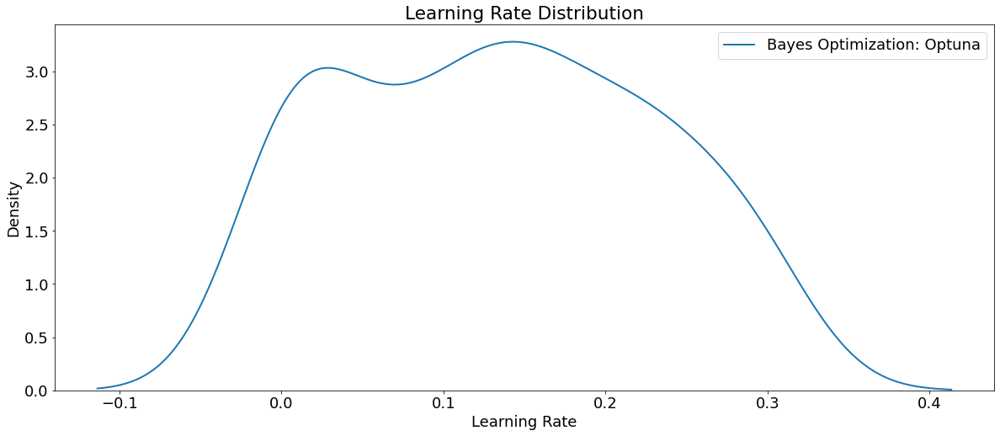

In [ ]:
# Density plots of the learning rate distributions 
plt.figure(figsize=(20,8))
plt.rcParams['font.size'] = 18
sns.kdeplot(trials_df['learning_rate'], label='Bayes Optimization: Optuna', 
            linewidth=2)
plt.legend(loc=1)
plt.xlabel('Learning Rate'); plt.ylabel('Density'); plt.title('Learning Rate Distribution');
plt.show()

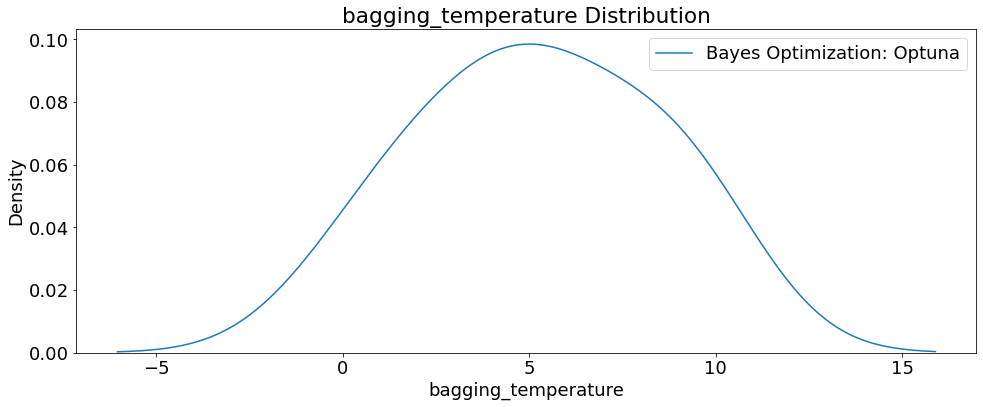

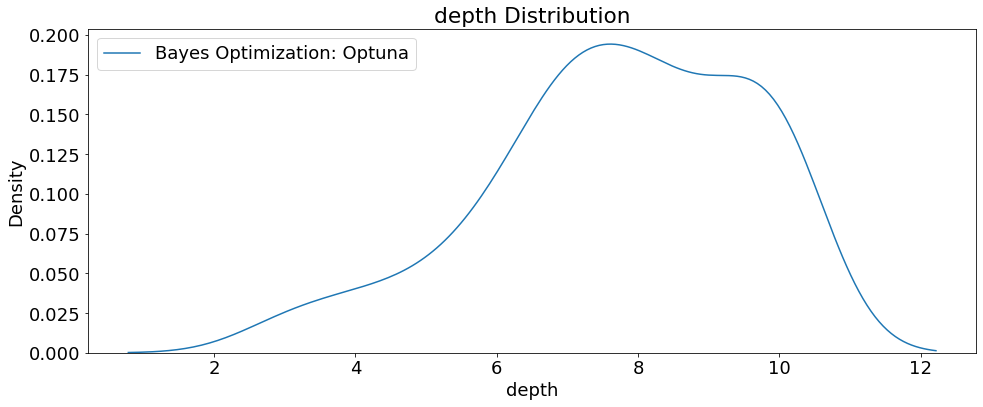

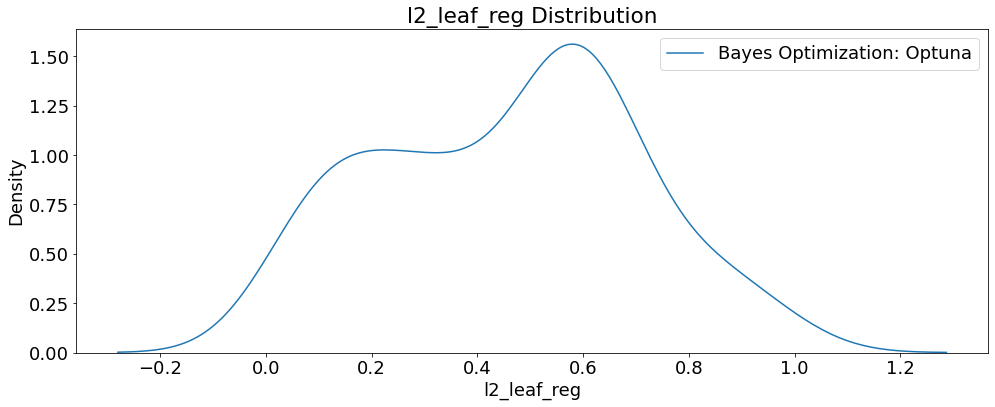

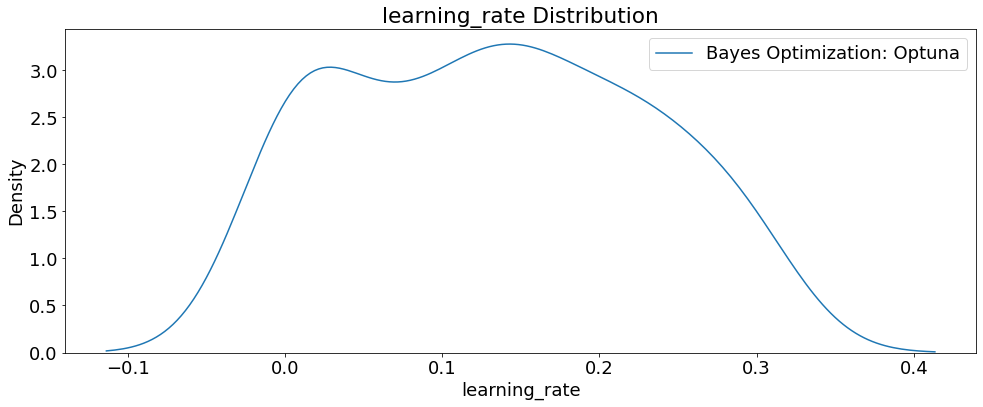

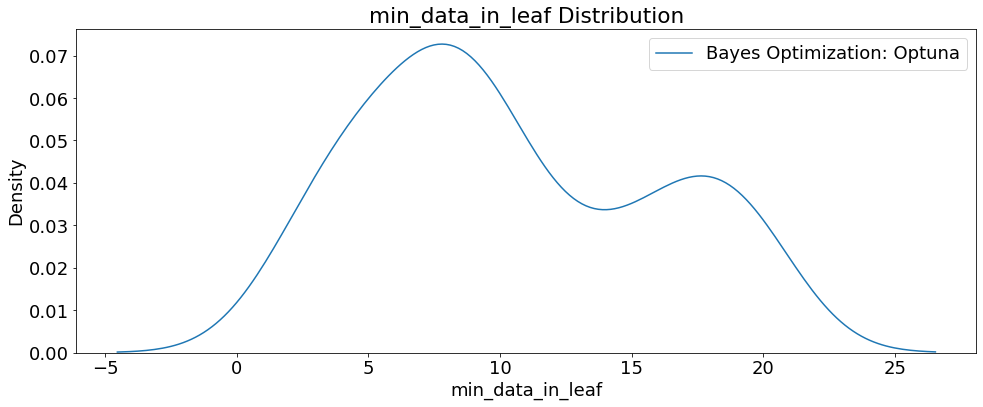

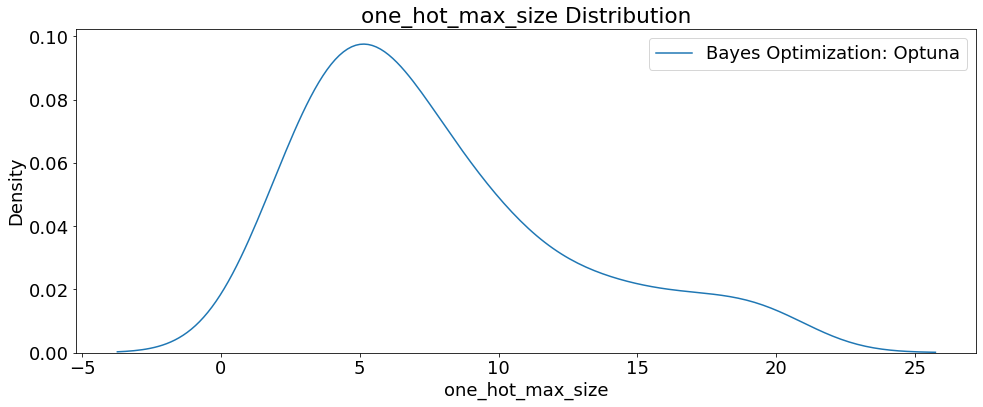

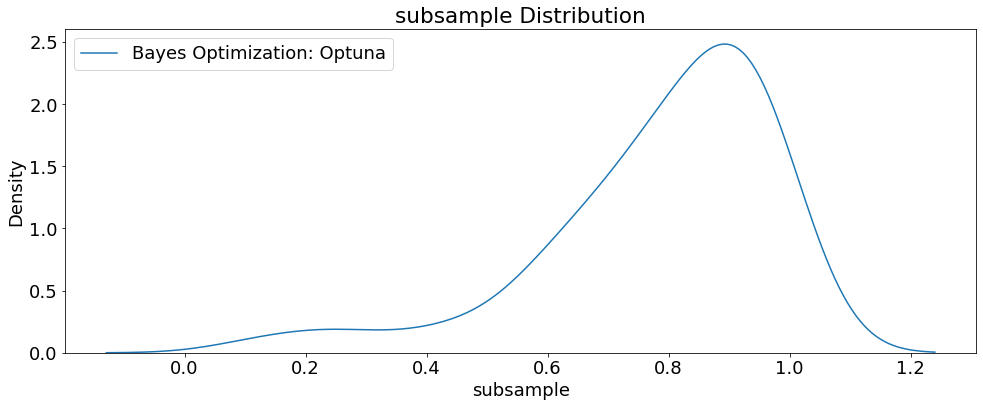

In [ ]:
# Create plots of Hyperparameters that are numeric 
for i, hpo in enumerate(trials_df.columns):
    if hpo not in ['iteration', 'rmse', 'datetime_start', 'datetime_complete',
                   'duration', 'n_estimators', 'state', 'boosting_type',
                   'bootstrap_type']:
        plt.figure(figsize=(14,6))
        # Plot the bayes search distribution
        if hpo != 'loss':
            sns.kdeplot(trials_df[hpo], label='Bayes Optimization: Optuna')
            plt.legend(loc=0)
            plt.title('{} Distribution'.format(hpo))
            plt.xlabel('{}'.format(hpo)); plt.ylabel('Density')
            plt.tight_layout()
            plt.show()

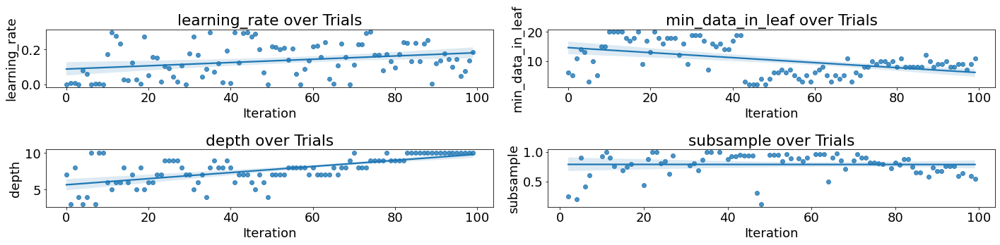

In [ ]:
# Plot quantitive hyperparameters
fig, axs = plt.subplots(2, 2, figsize=(20,5))
i = 0
axs = axs.flatten()
for i, hpo in enumerate(['learning_rate', 'min_data_in_leaf', 
                         'depth', 'subsample']):
  # Scatterplot
  sns.regplot('iteration', hpo, data=trials_df, ax=axs[i]) 
  axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo),  
             title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

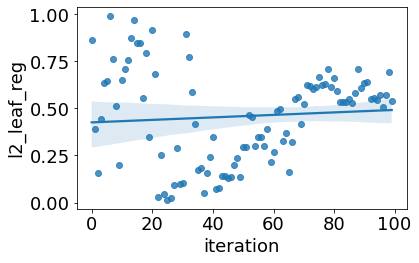

In [ ]:
# Scatterplot of regularization hyperparameters
ax = sns.regplot(x='iteration', y='l2_leaf_reg', data=trials_df)
plt.tight_layout()
plt.show()

In [ ]:
# Visualize parameter importances
fig = optuna.visualization.plot_param_importances(study)
py.plot(fig, filename='paramImportance_Catboost_Optuna_100_GPU_wb_trainValTestPool_RTX4000_cuml.html')
fig.show()

In [ ]:
# Visualize empirical distribution function
fig = optuna.visualization.plot_edf(study)
py.plot(fig, filename='edf_Catboost_Optuna_100_GPU_wb_trainValTestPool_RTX4000_cuml.html')
fig.show()

In [ ]:
# Arrange best parameters to fit model for model metrics
params = study.best_params   
params['random_state'] = seed_value
params

{'n_estimators': 429,
 'learning_rate': 0.23884564005152742,
 'depth': 10,
 'l2_leaf_reg': 0.5362269089364889,
 'min_data_in_leaf': 8,
 'one_hot_max_size': 6,
 'boosting_type': 'Plain',
 'bootstrap_type': 'Bernoulli',
 'subsample': 0.8727947697637198,
 'random_state': 42}

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/Catboost/Optuna/Model_PKL/

/notebooks/UsedCarsCarGurus/Models/ML/Catboost/Optuna/Model_PKL


In [ ]:
# Re-create the best model and train on the training data
best_model = CatBoostRegressor(loss_function='RMSE', 
                               task_type='GPU',
                               early_stopping_rounds=10, 
                               rsm=1, 
                               logging_level='Silent', 
                               **params)

# Fit the model
best_model.fit(train_features, train_label)

# Save model
Pkl_Filename = 'Catboost_Optuna_trials100_GPU_wb_trainValTestPool_RTX4000_cuml.pkl'  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(best_model, file)

# =============================================================================
# # To load saved model
# model = joblib.load('Catboost_Optuna_trials100_GPU_wb_trainValTestPool_RTX4000_cuml.pkl')
# print(model)
# =============================================================================

In [ ]:
print('\nModel Metrics for Catboost HPO 100 GPU trials')
y_train_pred = best_model.predict(train_features)
y_test_pred = best_model.predict(test_features)

print('MAE train: %.3f, test: %.3f' % (
        mean_absolute_error(train_label, y_train_pred),
        mean_absolute_error(test_label, y_test_pred)))
print('MSE train: %.3f, test: %.3f' % (
        mean_squared_error(train_label, y_train_pred),
        mean_squared_error(test_label, y_test_pred)))
print('RMSE train: %.3f, test: %.3f' % (
        mean_squared_error(train_label, y_train_pred, squared=False),
        mean_squared_error(test_label, y_test_pred, squared=False)))
print('R^2 train: %.3f, test: %.3f' % (
        r2_score(train_label, y_train_pred),
        r2_score(test_label, y_test_pred)))


Model Metrics for Catboost HPO 100 GPU trials
MAE train: 1522.929, test: 1780.784
MSE train: 4183553.778, test: 5832039.951
RMSE train: 2045.374, test: 2414.962
R^2 train: 0.954, test: 0.936


In [ ]:
# Evaluate on the testing data 
print('The best model from optimization scores {:.5f} MSE on the test set.'.format(mean_squared_error(asnumpy(test_label), 
                                                                                                      asnumpy(y_test_pred))))
print('This was achieved using these conditions:')
print(trials_df.iloc[0])

The best model from optimization scores 5832039.95108 MSE on the test set.
This was achieved using these conditions:
iteration                                      83
rmse                                  2443.635532
datetime_start         2023-01-13 02:58:25.658371
datetime_complete      2023-01-13 02:58:50.762948
duration                   0 days 00:00:25.104577
bagging_temperature                           NaN
boosting_type                               Plain
bootstrap_type                          Bernoulli
depth                                          10
l2_leaf_reg                              0.536227
learning_rate                            0.238846
min_data_in_leaf                                8
n_estimators                                  429
one_hot_max_size                                6
subsample                                0.872795
state                                    COMPLETE
Name: 83, dtype: object


# Quadro RTX 5000

In [ ]:
# Install/import dependencies
!pip install --upgrade pip
!pip install --upgrade -q wandb
!pip install catboost
!pip install optuna
!pip install plotly
!pip install eli5
!pip install shap
import os
import warnings
import random
import numpy as np
import cupy 
from cupy import asnumpy
import dask
from dask.distributed import Client, wait
from dask.diagnostics import ProgressBar
from dask_cuda import LocalCUDACluster
import dask_cudf
import urllib.request
from contextlib import contextmanager
import time
from datetime import datetime, timedelta
from timeit import default_timer as timer
import joblib
import cudf
import cuml
from sklearn.model_selection import train_test_split
from catboost import CatBoostRegressor, Pool
import optuna
from optuna import Trial
optuna.logging.set_verbosity(optuna.logging.WARNING) 
import wandb
from optuna.integration.wandb import WeightsAndBiasesCallback
import pickle
import pandas as pd
import plotly.offline as py
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
import matplotlib.pyplot as plt
import seaborn as sns
import eli5 
from eli5.sklearn import PermutationImportance 
import webbrowser
from eli5.formatters import format_as_dataframe
warnings.filterwarnings('ignore')
my_dpi = 96
os.environ['CUDA_VISIBLE_DEVICES'] = '0'
print('\n')
!nvidia-smi

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 64.3 MB/s eta 0:00:00
  Attempting uninstall: pip
    Found existing installation: pip 22.0.3
    Uninstalling pip-22.0.3:
      Successfully uninstalled pip-22.0.3
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 76.6/76.6 MB 20.0 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 15.2/15.2 MB 69.4 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 47.0/47.0 kB 11.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 365.3/365.3 kB 33.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.8/2.8 MB 74.5 MB/s eta 0:00:00:00:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 210.6/210.6 kB 43.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.7/78.7 kB 21.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 610.9/610.9 kB 70.3 MB/s eta 0:00:00
  Attempting uninstall: typing-extensions
    Found existing installation: typing_extensions 4.0.1
    Uni

## 100 Trials Train/Test Pool

In [ ]:
# Create pool of train/test sets
train_data = Pool(train_features, train_label)
eval_data = Pool(test_features, test_label)

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/Catboost/Optuna/Model_PKL

/notebooks/UsedCarsCarGurus/Models/ML/Catboost/Optuna/Model_PKL


In [ ]:
# Set up wandb
wandb.login()

wandb_kwargs = {'project': 'usedCars_hpo', 'entity': 'aschultz', 
                'group': 'optuna_cat100gpu_RTX5000_trainTestPool_cuml', 
                'save_code': 'False', 
                'notes': 'optuna_cat100gpu_RTX5000_trainTestPool_cuml'}
wandbc = WeightsAndBiasesCallback(wandb_kwargs=wandb_kwargs, as_multirun=True)

wandb: Currently logged in as: aschultz. Use `wandb login --relogin` to force relogin


In [ ]:
# Set up WB callbacks
@wandbc.track_in_wandb()

# Define a function for optimization of hyperparameters
def objective(trial):
    """
    Objective function to tune a `CatBoostRegressor` model.
    """
    joblib.dump(study, 'Cat_Optuna_100_GPU_wb_trainTest_RTX5000_cuml.pkl')


# Define parameter grid
    catboost_tune_kwargs = {
        'random_state': seed_value,
        'task_type':'GPU',
        'n_estimators': trial.suggest_int('n_estimators', 100, 500),
        'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 0.3),       
        'depth': trial.suggest_int('depth', 3, 10),
        'l2_leaf_reg': trial.suggest_float('l2_leaf_reg', 1e-2, 1e0),
        'min_data_in_leaf': trial.suggest_int('min_data_in_leaf', 2, 20),
        'one_hot_max_size': trial.suggest_int('one_hot_max_size', 2, 20), 
        'boosting_type': trial.suggest_categorical('boosting_type', 
                                                   ['Ordered', 'Plain']),
        'bootstrap_type': trial.suggest_categorical('bootstrap_type', 
                                                    ['Bayesian', 'Bernoulli', 
                                                     'MVS'])
        }   

    # Conditional Hyperparameters
    if catboost_tune_kwargs['bootstrap_type'] == 'Bayesian':
      catboost_tune_kwargs['bagging_temperature'] = trial.suggest_float('bagging_temperature', 
                                                                        0, 10)
    elif catboost_tune_kwargs['bootstrap_type'] == 'Bernoulli':
      catboost_tune_kwargs['subsample'] = trial.suggest_float('subsample', 
                                                              0.1, 1)
    
    # Define model type
    model = CatBoostRegressor(loss_function='RMSE', 
                              early_stopping_rounds=10,
                              rsm=1, 
                              logging_level='Silent',
                              **catboost_tune_kwargs)

    # Start timer for each trial
    start = timer()
    
    # Train the model
    model.fit(X=train_data, eval_set=eval_data)   
    run_time = timer() - start

    # Predictions
    y_pred_val = model.predict(test_features)
    rmse = mean_squared_error(asnumpy(test_label), asnumpy(y_pred_val), 
                              squared=False)
    print('- Trial RMSE:', rmse)  
    
    return rmse

In [ ]:
# Begin HPO trials 
# Start timer for experiment
start_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
if os.path.isfile('Cat_Optuna_100_GPU_wb_trainTest_RTX5000_cuml.pkl'):
    study = joblib.load('Cat_Optuna_100_GPU_wb_trainTest_RTX5000_cuml.pkl')
else:
    study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=100, callbacks=[wandbc])

# End timer for experiment
end_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
print('%-20s %s' % ('End Time', end_time))
print(str(timedelta(seconds=(end_time-start_time).seconds)))
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Lowest RMSE', study.best_value)
wandb.finish()

Start Time           2023-01-17 20:03:23.575954


- Trial RMSE: 3584.504272307759


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,0.36148
boosting_type,Plain


- Trial RMSE: 3177.757983466087


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 9290.331170725469


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,7.30412
boosting_type,Ordered


- Trial RMSE: 5096.908626695983


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,MVS
depth,6


- Trial RMSE: 9216.538137436723


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 4476.105058572639


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2808.684372796628


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,MVS
depth,9


- Trial RMSE: 2960.499778158377


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,1.1422
boosting_type,Ordered


- Trial RMSE: 8927.528933000776


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 9386.089758230833


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 6190.054488913215


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,MVS
depth,8


- Trial RMSE: 2513.189059521417


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,0.58589
boosting_type,Ordered


- Trial RMSE: 2919.893873917736


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,MVS
depth,9


- Trial RMSE: 3059.292226569654


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,MVS
depth,8


- Trial RMSE: 2723.406593822809


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,3.8678
boosting_type,Ordered


- Trial RMSE: 2703.5068918683937


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,4.26407
boosting_type,Ordered


- Trial RMSE: 3190.496591502942


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,4.65543
boosting_type,Ordered


- Trial RMSE: 3153.2052447709807


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,9.78497
boosting_type,Ordered


- Trial RMSE: 2618.1072977287963


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,2.59631
boosting_type,Ordered


- Trial RMSE: 7937.346946394176


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,2.08784
boosting_type,Ordered


- Trial RMSE: 2669.8740644881973


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,2.42979
boosting_type,Ordered


- Trial RMSE: 2663.7884956896364


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,2.3901
boosting_type,Ordered


- Trial RMSE: 2834.6741068305982


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,2.63955
boosting_type,Ordered


- Trial RMSE: 2678.533295017878


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,0.16911
boosting_type,Ordered


- Trial RMSE: 3230.749397577322


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,1.6451
boosting_type,Ordered


- Trial RMSE: 2656.9601248512186


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,3.14054
boosting_type,Ordered


- Trial RMSE: 2934.022543114231


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,5.73185
boosting_type,Ordered


- Trial RMSE: 3157.6985528268415


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,3.3816
boosting_type,Ordered


- Trial RMSE: 2825.2356052284017


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,5.90328
boosting_type,Ordered


- Trial RMSE: 2641.6842171748553


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,0.965
boosting_type,Ordered


- Trial RMSE: 2654.015275027744


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,1.05118
boosting_type,Ordered


- Trial RMSE: 2682.0152869859244


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,1.04425
boosting_type,Ordered


- Trial RMSE: 2834.471973354872


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,0.12615
boosting_type,Ordered


- Trial RMSE: 2557.198126014554


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,1.14212
boosting_type,Ordered


- Trial RMSE: 2559.447080529495


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,1.5912
boosting_type,Ordered


- Trial RMSE: 2539.6792010003624


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,1.72986
boosting_type,Ordered


- Trial RMSE: 2510.7015835821


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 3920.198387054087


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 3227.637243293809


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 3314.858675953413


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2670.185585222535


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2428.701263728681


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2482.4416317267896


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2436.2597392454527


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2416.393831723897


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2652.0364637313005


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2457.261892935103


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2917.9284337136987


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2478.9032785599416


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2779.4352346700884


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2508.4642769533884


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2436.529715599438


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2421.053039484368


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2448.894956751833


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2450.9632626847883


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2440.488462140862


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2462.187457163529


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2724.8813072428275


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,MVS
depth,9


- Trial RMSE: 2415.818193854102


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2519.881125875888


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 6117.473599332371


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2418.673893234649


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2457.7421484270108


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 6799.865551646056


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2619.985023220951


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2697.0038989701934


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,MVS
depth,10


- Trial RMSE: 2439.5187067272864


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2441.876817042652


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2465.3025876557667


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 9184.41750904887


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2414.2639023458914


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2405.3616985444864


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2408.8513507360763


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2415.8518708888896


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2655.2559619866615


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,MVS
depth,10


- Trial RMSE: 2411.6953814228486


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2427.736511789336


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2418.346974711945


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2437.3730496152275


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2432.4624804744626


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2419.8140186667656


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2408.324766231576


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2415.5765157814676


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2419.6609134970918


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2412.8355821765704


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2411.8274813850744


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2413.4072694334773


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2652.618294776862


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,MVS
depth,10


- Trial RMSE: 2447.8626883462434


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2448.136344688088


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 8264.34849215848


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2408.5999198778827


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2408.399244554126


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2407.625143434307


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2415.93801126364


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2410.378210343898


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2405.649921967389


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2485.617187963275


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2427.8615939622414


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 3729.9498760753313


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


Start Time           2023-01-17 20:03:23.575954
End Time             2023-01-17 21:00:11.776619
0:56:48


Number of finished trials: 100
Best trial: {'n_estimators': 483, 'learning_rate': 0.24529798297476701, 'depth': 10, 'l2_leaf_reg': 0.5558691889321375, 'min_data_in_leaf': 13, 'one_hot_max_size': 16, 'boosting_type': 'Plain', 'bootstrap_type': 'Bernoulli', 'subsample': 0.8727709957256792}
Lowest RMSE 2405.3616985444864


In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/Catboost/Optuna/trialOptions/

/notebooks/UsedCarsCarGurus/Models/ML/Catboost/Optuna/trialOptions


In [ ]:
# Output from HPO trials
trials_df = study.trials_dataframe()
trials_df.rename(columns={'number': 'iteration'}, inplace=True)
trials_df.rename(columns={'value': 'rmse'}, inplace=True)
trials_df.rename(columns={'params_bagging_temperature': 'bagging_temperature'}, 
                 inplace=True)
trials_df.rename(columns={'params_boosting_type': 'boosting_type'}, 
                 inplace=True)
trials_df.rename(columns={'params_bootstrap_type': 'bootstrap_type'}, 
                 inplace=True)
trials_df.rename(columns={'params_depth': 'depth'}, inplace=True)
trials_df.rename(columns={'params_l2_leaf_reg': 'l2_leaf_reg'}, inplace=True)
trials_df.rename(columns={'params_learning_rate': 'learning_rate'}, 
                 inplace=True)
trials_df.rename(columns={'params_min_data_in_leaf': 'min_data_in_leaf'}, 
                 inplace=True)
trials_df.rename(columns={'params_n_estimators': 'n_estimators'}, inplace=True)
trials_df.rename(columns={'params_one_hot_max_size': 'one_hot_max_size'}, 
                 inplace=True)
trials_df.rename(columns={'params_subsample': 'subsample'}, inplace=True)
trials_df = trials_df.sort_values('rmse', ascending=True)
print(trials_df) 

# Write processed data to csv
trials_df.to_csv('Catboost_Optuna_100_GPU_wb_trainTestPool_RTX5000_cuml.csv', 
                 index=False)

    iteration         rmse             datetime_start  \
71         71  2405.361699 2023-01-17 20:45:01.123680   
96         96  2405.649922 2023-01-17 20:57:58.311674   
93         93  2407.625143 2023-01-17 20:56:16.042883   
81         81  2408.324766 2023-01-17 20:50:07.301204   
92         92  2408.399245 2023-01-17 20:55:46.491783   
..        ...          ...                        ...   
8           8  8927.528933 2023-01-17 20:07:46.811182   
69         69  9184.417509 2023-01-17 20:44:02.431544   
4           4  9216.538137 2023-01-17 20:05:13.174300   
2           2  9290.331171 2023-01-17 20:04:21.590152   
9           9  9386.089758 2023-01-17 20:08:31.412665   

            datetime_complete               duration  bagging_temperature  \
71 2023-01-17 20:45:32.013869 0 days 00:00:30.890189                  NaN   
96 2023-01-17 20:58:20.772368 0 days 00:00:22.460694                  NaN   
93 2023-01-17 20:56:54.392882 0 days 00:00:38.349999                  NaN   
81 2023

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/Catboost/Optuna/Model_Explanations/

/notebooks/UsedCarsCarGurus/Models/ML/Catboost/Optuna/Model_Explanations


In [ ]:
# Plot_optimization_history: shows the scores from all trials as well as the best score so far at each point.
fig = optuna.visualization.plot_optimization_history(study)
py.plot(fig, filename='optimizationHistory_Catboost_Optuna_100_GPU_wb_trainTestPool_RTX5000_cuml.html')
fig.show()

In [ ]:
# plot_parallel_coordinate: interactively visualizes the hyperparameters and scores
fig = optuna.visualization.plot_parallel_coordinate(study)
py.plot(fig, filename='parallelCoordinate_Catboost_Optuna_100_GPU_wb_trainTestPool_RTX5000_cuml.html')
fig.show()

[W 2023-01-17 21:00:12,328] Your study has only completed trials with missing parameters.


In [ ]:
# plot_slice: shows the change of the hyperparameters space over the search. 
fig = optuna.visualization.plot_slice(study)
py.plot(fig, filename='slice_Catboost_Optuna_100_GPU_wb_trainTestPool_RTX5000_cuml.html')
fig.show()

In [ ]:
# plot_contour: plots parameter interactions on an interactive chart
fig = optuna.visualization.plot_contour(study, params=['depth', 
                                                       'subsample', 
                                                       'learning_rate', 
                                                       'subsample'])
py.plot(fig, filename='contour_Catboost_Optuna_100_GPU_wb_trainTestPool_RTX5000_cuml.html')
fig.show()

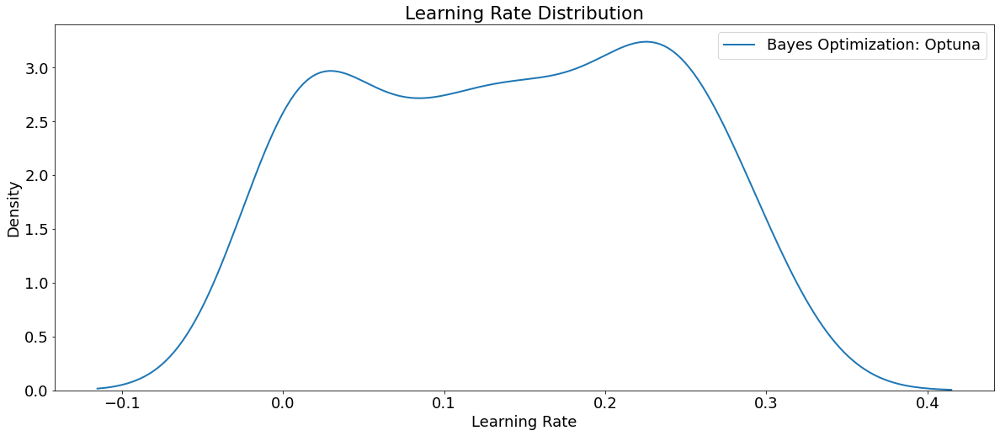

In [ ]:
# Density plots of the learning rate distributions 
plt.figure(figsize=(20,8))
plt.rcParams['font.size'] = 18
sns.kdeplot(trials_df['learning_rate'], label='Bayes Optimization: Optuna', 
            linewidth=2)
plt.legend(loc=1)
plt.xlabel('Learning Rate'); plt.ylabel('Density'); plt.title('Learning Rate Distribution');
plt.show()

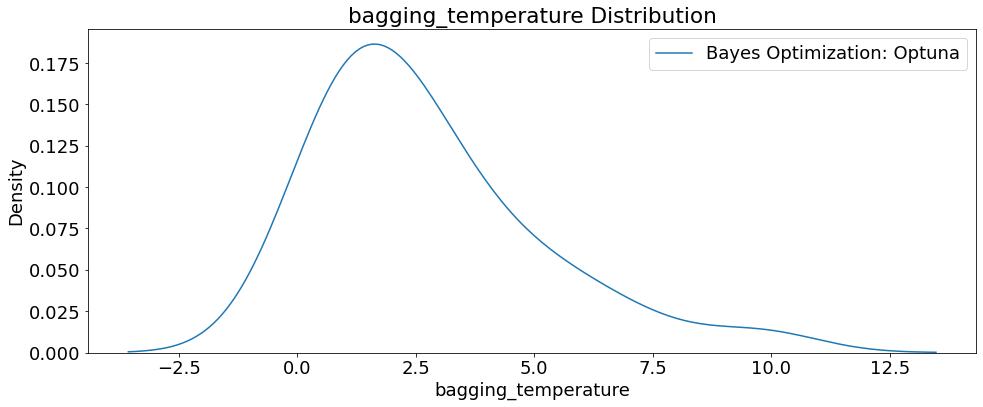

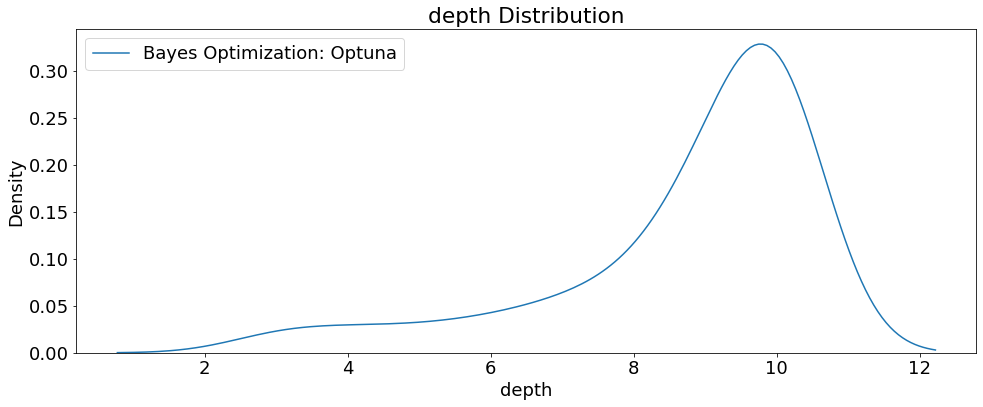

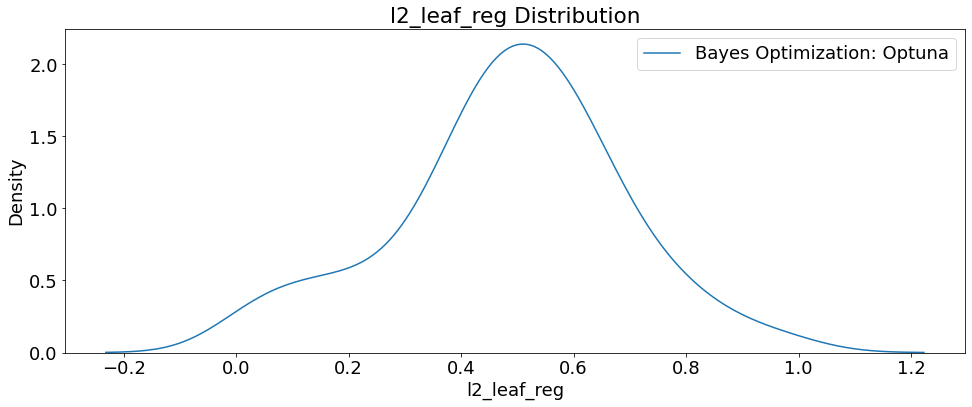

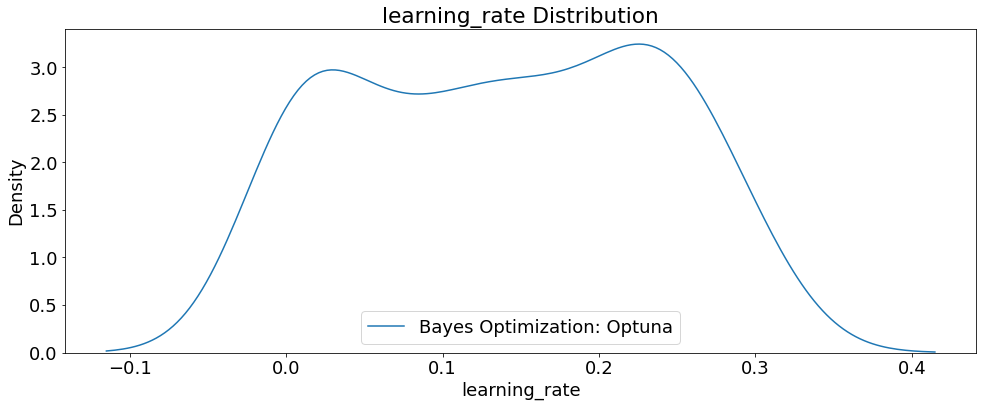

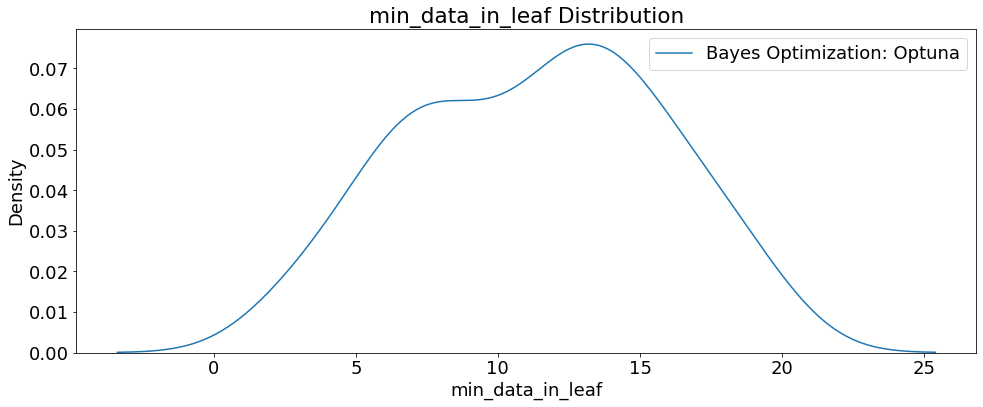

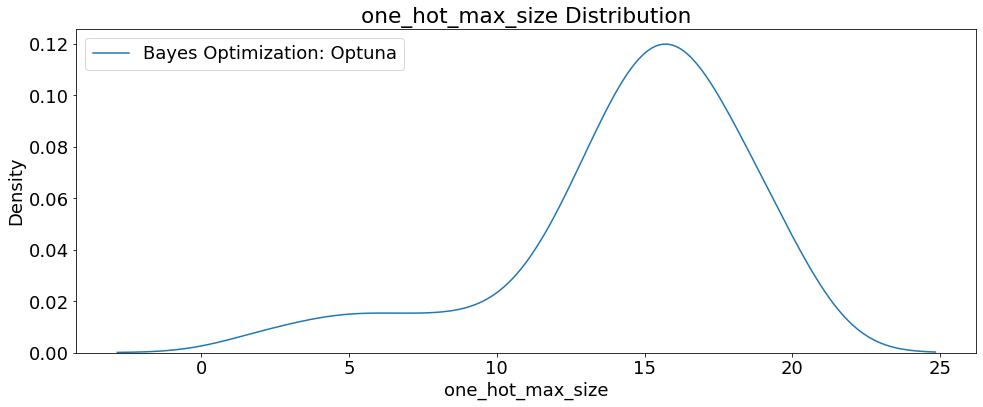

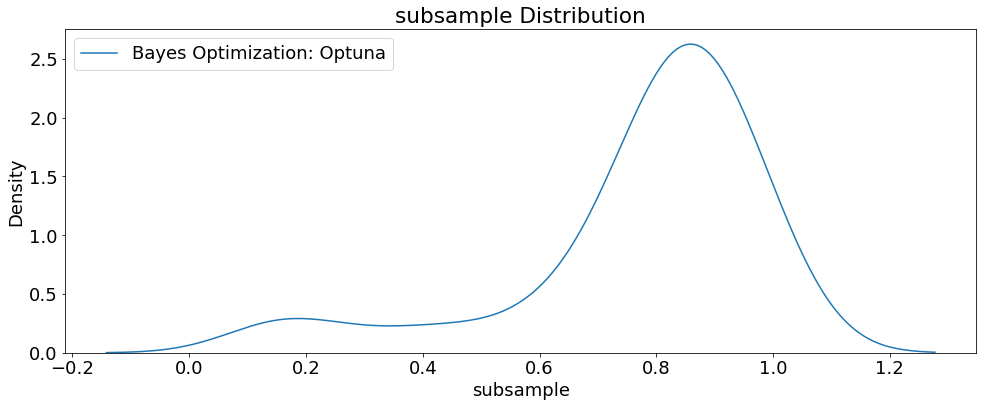

In [ ]:
# Create plots of Hyperparameters that are numeric 
for i, hpo in enumerate(trials_df.columns):
    if hpo not in ['iteration', 'rmse', 'datetime_start', 'datetime_complete',
                   'duration', 'n_estimators', 'state', 'boosting_type',
                   'bootstrap_type']:
        plt.figure(figsize=(14,6))
        # Plot the bayes search distribution
        if hpo != 'loss':
            sns.kdeplot(trials_df[hpo], label='Bayes Optimization: Optuna')
            plt.legend(loc=0)
            plt.title('{} Distribution'.format(hpo))
            plt.xlabel('{}'.format(hpo)); plt.ylabel('Density')
            plt.tight_layout()
            plt.show()

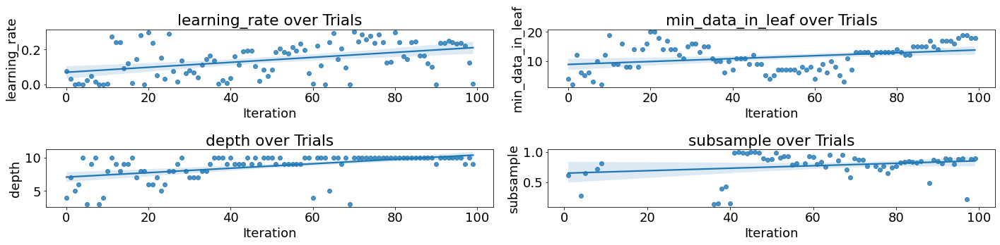

In [ ]:
# Plot quantitive hyperparameters
fig, axs = plt.subplots(2, 2, figsize=(20,5))
i = 0
axs = axs.flatten()
for i, hpo in enumerate(['learning_rate', 'min_data_in_leaf', 
                         'depth', 'subsample']):
  # Scatterplot
  sns.regplot('iteration', hpo, data=trials_df, ax=axs[i]) 
  axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo),  
             title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

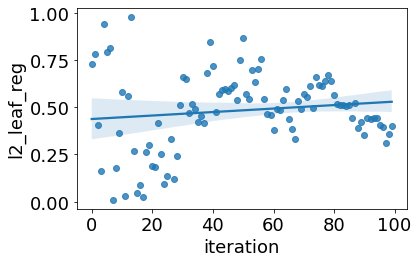

In [ ]:
# Scatterplot of regularization hyperparameters
ax = sns.regplot(x='iteration', y='l2_leaf_reg', data=trials_df)
plt.tight_layout()
plt.show()

In [ ]:
# Visualize parameter importances
fig = optuna.visualization.plot_param_importances(study)
py.plot(fig, filename='paramImportance_Catboost_Optuna_100_GPU_wb_trainTestPool_RTX5000_cuml.html')
fig.show()

In [ ]:
# Visualize empirical distribution function
fig = optuna.visualization.plot_edf(study)
py.plot(fig, filename='edf_Catboost_Optuna_100_GPU_wb_trainTestPool_RTX5000_cuml.html')
fig.show()

In [ ]:
# Arrange best parameters to fit model for model metrics
params = study.best_params   
params['random_state'] = seed_value
params

{'n_estimators': 483,
 'learning_rate': 0.24529798297476701,
 'depth': 10,
 'l2_leaf_reg': 0.5558691889321375,
 'min_data_in_leaf': 13,
 'one_hot_max_size': 16,
 'boosting_type': 'Plain',
 'bootstrap_type': 'Bernoulli',
 'subsample': 0.8727709957256792,
 'random_state': 42}

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/Catboost/Optuna/Model_PKL/

/notebooks/UsedCarsCarGurus/Models/ML/Catboost/Optuna/Model_PKL


In [ ]:
# Re-create the best model and train on the training data
best_model = CatBoostRegressor(loss_function='RMSE', 
                               task_type='GPU',
                               early_stopping_rounds=10, 
                               rsm=1, 
                               logging_level='Silent', 
                               **params)

# Fit the model
best_model.fit(train_features, train_label)

# Save model
Pkl_Filename = 'Catboost_Optuna_trials100_GPU_wb_trainTestPool_RTX5000_cuml.pkl'  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(best_model, file)

# =============================================================================
# # To load saved model
# model = joblib.load('Catboost_Optuna_trials100_GPU_wb_trainTestPool_RTX5000_cuml.pkl')
# print(model)
# =============================================================================

In [ ]:
print('\nModel Metrics for Catboost HPO 100 GPU trials')
y_train_pred = best_model.predict(train_features)
y_test_pred = best_model.predict(test_features)

print('MAE train: %.3f, test: %.3f' % (
        mean_absolute_error(train_label, y_train_pred),
        mean_absolute_error(test_label, y_test_pred)))
print('MSE train: %.3f, test: %.3f' % (
        mean_squared_error(train_label, y_train_pred),
        mean_squared_error(test_label, y_test_pred)))
print('RMSE train: %.3f, test: %.3f' % (
        mean_squared_error(train_label, y_train_pred, squared=False),
        mean_squared_error(test_label, y_test_pred, squared=False)))
print('R^2 train: %.3f, test: %.3f' % (
        r2_score(train_label, y_train_pred),
        r2_score(test_label, y_test_pred)))


Model Metrics for Catboost HPO 100 GPU trials
MAE train: 1478.423, test: 1772.374
MSE train: 3943897.912, test: 5785764.901
RMSE train: 1985.925, test: 2405.362
R^2 train: 0.957, test: 0.937


In [ ]:
# Evaluate on the testing data 
print('The best model from optimization scores {:.5f} MSE on the test set.'.format(mean_squared_error(asnumpy(test_label), 
                                                                                                      asnumpy(y_test_pred))))
print('This was achieved using these conditions:')
print(trials_df.iloc[0])

The best model from optimization scores 5785764.90082 MSE on the test set.
This was achieved using these conditions:
iteration                                      71
rmse                                  2405.361699
datetime_start         2023-01-17 20:45:01.123680
datetime_complete      2023-01-17 20:45:32.013869
duration                   0 days 00:00:30.890189
bagging_temperature                           NaN
boosting_type                               Plain
bootstrap_type                          Bernoulli
depth                                          10
l2_leaf_reg                              0.555869
learning_rate                            0.245298
min_data_in_leaf                               13
n_estimators                                  483
one_hot_max_size                               16
subsample                                0.872771
state                                    COMPLETE
Name: 71, dtype: object


## 100 Trials Train/Validation/Test Pool

In [ ]:
# Create pool of train/test sets
train_data = Pool(train_Features, train_Label)
eval_data = Pool(val_features, val_label)

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/Catboost/Optuna/Model_PKL

/notebooks/UsedCarsCarGurus/Models/ML/Catboost/Optuna/Model_PKL


In [ ]:
# Set up wandb
wandb.login()

wandb_kwargs = {'project': 'usedCars_hpo', 'entity': 'aschultz', 
                'group': 'optuna_cat100gpu_RTX5000_trainValTestPool_cuml', 
                'save_code': 'False', 
                'notes': 'optuna_cat100gpu_RTX5000_trainValTestPool_cuml'}
wandbc = WeightsAndBiasesCallback(wandb_kwargs=wandb_kwargs, as_multirun=True)

In [ ]:
# Set up WB callbacks
@wandbc.track_in_wandb()

# Define a function for optimization of hyperparameters
def objective(trial):
    """
    Objective function to tune a `CatBoostRegressor` model.
    """
    joblib.dump(study, 'Cat_Optuna_100_GPU_wb_trainValTest_RTX5000_cuml.pkl')

# Define parameter grid
    catboost_tune_kwargs = {
        'random_state': seed_value,
        'task_type':'GPU',
        'n_estimators': trial.suggest_int('n_estimators', 100, 500),
        'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 0.3),       
        'depth': trial.suggest_int('depth', 3, 10),
        'l2_leaf_reg': trial.suggest_float('l2_leaf_reg', 1e-2, 1e0),
        'min_data_in_leaf': trial.suggest_int('min_data_in_leaf', 2, 20),
        'one_hot_max_size': trial.suggest_int('one_hot_max_size', 2, 20), 
        'boosting_type': trial.suggest_categorical('boosting_type', 
                                                   ['Ordered', 'Plain']),
        'bootstrap_type': trial.suggest_categorical('bootstrap_type', 
                                                    ['Bayesian', 'Bernoulli', 
                                                     'MVS'])
        }   

    # Conditional Hyperparameters
    if catboost_tune_kwargs['bootstrap_type'] == 'Bayesian':
      catboost_tune_kwargs['bagging_temperature'] = trial.suggest_float('bagging_temperature', 
                                                                        0, 10)
    elif catboost_tune_kwargs['bootstrap_type'] == 'Bernoulli':
      catboost_tune_kwargs['subsample'] = trial.suggest_float('subsample', 
                                                              0.1, 1)
    
    # Define model type
    model = CatBoostRegressor(loss_function='RMSE', 
                              early_stopping_rounds=10,
                              rsm=1, 
                              logging_level='Silent',
                              **catboost_tune_kwargs)

    # Start timer for each trial
    start = timer()
    
    # Train the model
    model.fit(X=train_data, eval_set=eval_data) 
    run_time = timer() - start

    # Predictions
    y_pred_val = model.predict(val_features)
    rmse = mean_squared_error(asnumpy(val_label), asnumpy(y_pred_val), 
                              squared=False)
    print('- Trial RMSE:', rmse)  
    
    return rmse

In [ ]:
# Begin HPO trials 
# Start timer for experiment
start_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
if os.path.isfile('Cat_Optuna_100_GPU_wb_trainValTest_RTX5000_cuml.pkl'):
    study = joblib.load('Cat_Optuna_100_GPU_wb_trainValTest_RTX5000_cuml.pkl')
else:
    study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=100, callbacks=[wandbc])

# End timer for experiment
end_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
print('%-20s %s' % ('End Time', end_time))
print(str(timedelta(seconds=(end_time-start_time).seconds)))
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Lowest RMSE', study.best_value)
wandb.finish()

Start Time           2023-01-17 21:00:37.460230


- Trial RMSE: 3907.5405077966666


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 3777.5741900956996


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,MVS
depth,4


- Trial RMSE: 9271.98384430387


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 3772.922852234282


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,5.07504
boosting_type,Plain


- Trial RMSE: 3039.0337987275675


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 9260.78070441955


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 6130.818662183296


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,MVS
depth,5


- Trial RMSE: 4650.375850462265


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 9064.799125876581


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 3319.844368402905


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,MVS
depth,8


- Trial RMSE: 2692.8297166734824


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,0.08935
boosting_type,Ordered


- Trial RMSE: 2578.6803473214595


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,0.40893
boosting_type,Ordered


- Trial RMSE: 2577.4208757930246


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,0.67966
boosting_type,Ordered


- Trial RMSE: 2561.5259069875387


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,0.00239
boosting_type,Ordered


- Trial RMSE: 2575.79344445743


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,0.02528
boosting_type,Ordered


- Trial RMSE: 3704.918499057652


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,9.89786
boosting_type,Ordered


- Trial RMSE: 2704.7458488361567


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,3.18118
boosting_type,Ordered


- Trial RMSE: 2758.448852690394


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,3.04842
boosting_type,Ordered


- Trial RMSE: 2842.518403479098


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,2.70798
boosting_type,Ordered


- Trial RMSE: 3889.6692337509776


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,6.68969
boosting_type,Ordered


- Trial RMSE: 9390.738823120848


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,2.0119
boosting_type,Ordered


- Trial RMSE: 2570.4966373803327


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,0.00691
boosting_type,Ordered


- Trial RMSE: 2540.682650489638


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,1.40247
boosting_type,Ordered


- Trial RMSE: 2758.7185498461986


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,1.67397
boosting_type,Ordered


- Trial RMSE: 2595.75003626799


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,1.46654
boosting_type,Ordered


- Trial RMSE: 2948.4902081655728


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,MVS
depth,9


- Trial RMSE: 3105.1342035690827


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,4.48792
boosting_type,Ordered


- Trial RMSE: 4103.424650556695


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,1.30183
boosting_type,Ordered


- Trial RMSE: 2869.0122656145227


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,4.22151
boosting_type,Ordered


- Trial RMSE: 3451.586562399319


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,MVS
depth,10


- Trial RMSE: 5097.500735577739


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,6.10837
boosting_type,Ordered


- Trial RMSE: 2531.0061567718863


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,0.01009
boosting_type,Ordered


- Trial RMSE: 2640.76783535549


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,0.80648
boosting_type,Ordered


- Trial RMSE: 2553.6945784209674


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,0.0535
boosting_type,Ordered


- Trial RMSE: 2624.455817406321


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,2.27087
boosting_type,Ordered


- Trial RMSE: 2513.704091347212


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,1.05754
boosting_type,Plain


- Trial RMSE: 2524.081648559914


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2705.3985562505063


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 3087.9388534506415


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2647.8879097836375


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 8326.779040195275


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2509.6205265838607


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2510.0183119555572


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2506.4727595799245


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2484.463292924287


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2598.5554469746407


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2573.288428551296


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 3219.987725863789


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2553.9432402689404


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2524.705639253731


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 8999.98366894997


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2519.962061677048


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2516.8418835144216


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2649.098344405045


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2595.9467945800125


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2891.2379782373246


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2487.901059771738


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2795.5983643488507


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,MVS
depth,8


- Trial RMSE: 2753.054054260221


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2601.7069232688223


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 6027.817793994842


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2518.233329297537


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2491.0536235657382


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2560.920713456518


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2516.113835288776


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2820.284340235157


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,MVS
depth,9


- Trial RMSE: 2509.724678186356


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2510.534579900717


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2526.7450461972326


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2487.762188756063


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2494.2374001193157


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2483.5916266348363


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2497.676005576334


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2518.717665438458


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2500.3323452470863


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2491.7784197897663


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2498.1708720025426


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2499.206468725012


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2709.628026480417


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,MVS
depth,10


- Trial RMSE: 4549.152351889943


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2630.3837632244476


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2524.3525950285316


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2487.3616344715647


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2482.332863083947


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2523.125357542177


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 3135.3410749639015


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2551.901163927988


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2485.146298922487


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2504.3287586021584


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2625.269563652514


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2532.995359984676


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2492.5310469045653


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2472.1806826327656


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2800.20268471035


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 9417.717961250039


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2520.103325415702


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2729.0152962385905


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,MVS
depth,9


- Trial RMSE: 2619.026490462532


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 4168.012919166077


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2513.240056910035


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


Start Time           2023-01-17 21:00:37.460230
End Time             2023-01-17 21:54:13.500020
0:53:36


Number of finished trials: 100
Best trial: {'n_estimators': 202, 'learning_rate': 0.29930867661858696, 'depth': 10, 'l2_leaf_reg': 0.10173225820233592, 'min_data_in_leaf': 13, 'one_hot_max_size': 14, 'boosting_type': 'Plain', 'bootstrap_type': 'Bernoulli', 'subsample': 0.9970518734479302}
Lowest RMSE 2472.1806826327656


In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/Catboost/Optuna/trialOptions/

/notebooks/UsedCarsCarGurus/Models/ML/Catboost/Optuna/trialOptions


In [ ]:
# Output from HPO trials
trials_df = study.trials_dataframe()
trials_df.rename(columns={'number': 'iteration'}, inplace=True)
trials_df.rename(columns={'value': 'rmse'}, inplace=True)
trials_df.rename(columns={'params_bagging_temperature': 'bagging_temperature'}, 
                 inplace=True)
trials_df.rename(columns={'params_boosting_type': 'boosting_type'}, 
                 inplace=True)
trials_df.rename(columns={'params_bootstrap_type': 'bootstrap_type'}, 
                 inplace=True)
trials_df.rename(columns={'params_depth': 'depth'}, inplace=True)
trials_df.rename(columns={'params_l2_leaf_reg': 'l2_leaf_reg'}, inplace=True)
trials_df.rename(columns={'params_learning_rate': 'learning_rate'}, 
                 inplace=True)
trials_df.rename(columns={'params_min_data_in_leaf': 'min_data_in_leaf'}, 
                 inplace=True)
trials_df.rename(columns={'params_n_estimators': 'n_estimators'}, inplace=True)
trials_df.rename(columns={'params_one_hot_max_size': 'one_hot_max_size'}, 
                 inplace=True)
trials_df.rename(columns={'params_subsample': 'subsample'}, inplace=True)
trials_df = trials_df.sort_values('rmse', ascending=True)
print(trials_df) 

# Write processed data to csv
trials_df.to_csv('Catboost_Optuna_100_GPU_wb_trainValTestPool_RTX5000_cuml.csv', 
                 index=False)

    iteration         rmse             datetime_start  \
92         92  2472.180683 2023-01-17 21:49:55.106038   
83         83  2482.332863 2023-01-17 21:45:27.357129   
71         71  2483.591627 2023-01-17 21:39:47.628073   
44         44  2484.463293 2023-01-17 21:26:23.244221   
87         87  2485.146299 2023-01-17 21:47:32.865324   
..        ...          ...                        ...   
8           8  9064.799126 2023-01-17 21:04:31.065468   
5           5  9260.780704 2023-01-17 21:03:15.795212   
2           2  9271.983844 2023-01-17 21:01:40.543548   
20         20  9390.738823 2023-01-17 21:11:36.379049   
94         94  9417.717961 2023-01-17 21:51:09.668183   

            datetime_complete               duration  bagging_temperature  \
92 2023-01-17 21:50:32.170595 0 days 00:00:37.064557                  NaN   
83 2023-01-17 21:45:52.447822 0 days 00:00:25.090693                  NaN   
71 2023-01-17 21:40:06.266467 0 days 00:00:18.638394                  NaN   
44 2023

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/Catboost/Optuna/Model_Explanations/

/notebooks/UsedCarsCarGurus/Models/ML/Catboost/Optuna/Model_Explanations


In [ ]:
# Plot_optimization_history: shows the scores from all trials as well as the best score so far at each point.
fig = optuna.visualization.plot_optimization_history(study)
py.plot(fig, filename='optimizationHistory_Catboost_Optuna_100_GPU_wb_trainValTestPool_RTX5000_cuml.html')
fig.show()

In [ ]:
# plot_parallel_coordinate: interactively visualizes the hyperparameters and scores
fig = optuna.visualization.plot_parallel_coordinate(study)
py.plot(fig, filename='parallelCoordinate_Catboost_Optuna_100_GPU_wb_trainValTestPool_RTX5000_cuml.html')
fig.show()

[W 2023-01-17 21:54:13,800] Your study has only completed trials with missing parameters.


In [ ]:
# plot_slice: shows the change of the hyperparameters space over the search. 
fig = optuna.visualization.plot_slice(study)
py.plot(fig, filename='slice_Catboost_Optuna_100_GPU_wb_trainValTestPool_RTX5000_cuml.html')
fig.show()

In [ ]:
# plot_contour: plots parameter interactions on an interactive chart
fig = optuna.visualization.plot_contour(study, params=['depth', 
                                                       'subsample', 
                                                       'learning_rate', 
                                                       'subsample'])
py.plot(fig, filename='contour_Catboost_Optuna_100_GPU_wb_trainValTestPool_RTX5000_cuml.html')
fig.show()

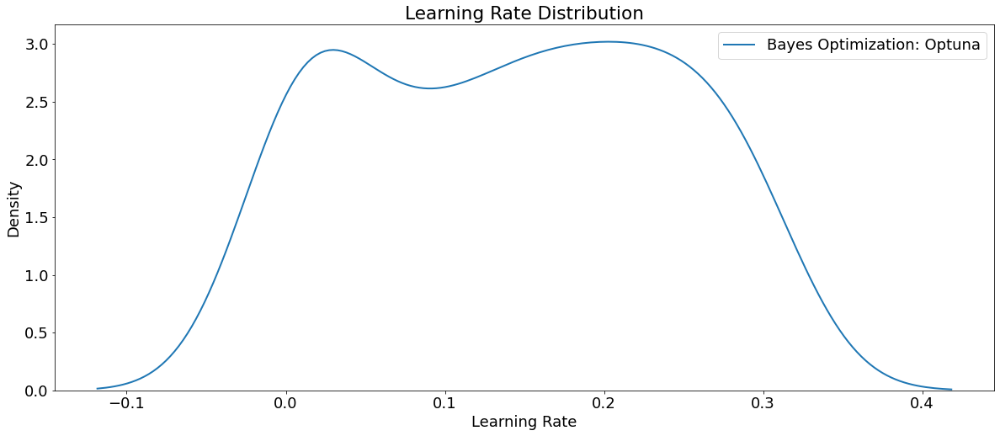

In [ ]:
# Density plots of the learning rate distributions 
plt.figure(figsize=(20,8))
plt.rcParams['font.size'] = 18
sns.kdeplot(trials_df['learning_rate'], label='Bayes Optimization: Optuna', 
            linewidth=2)
plt.legend(loc=1)
plt.xlabel('Learning Rate'); plt.ylabel('Density'); plt.title('Learning Rate Distribution');
plt.show()

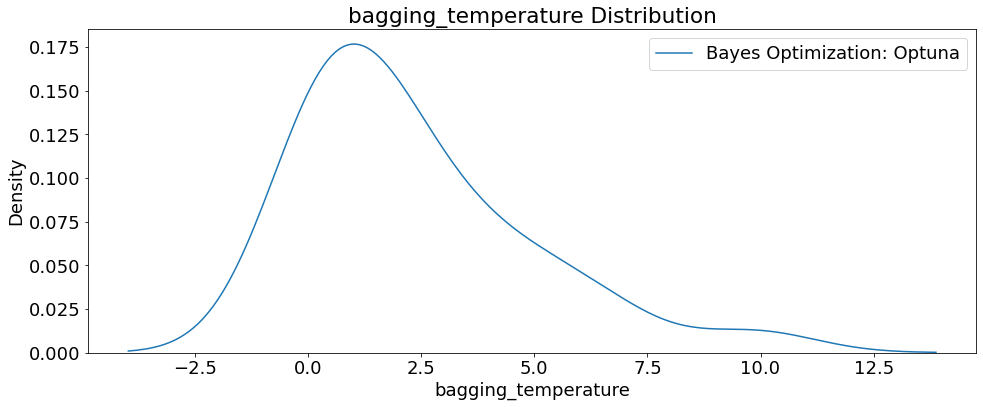

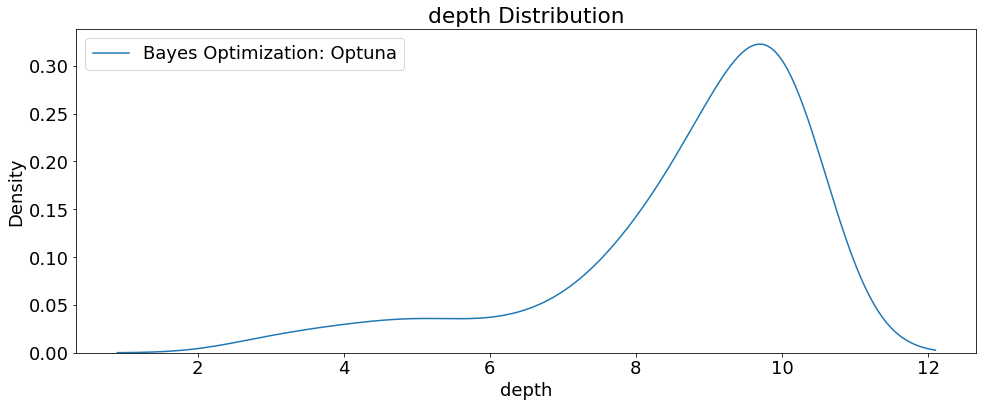

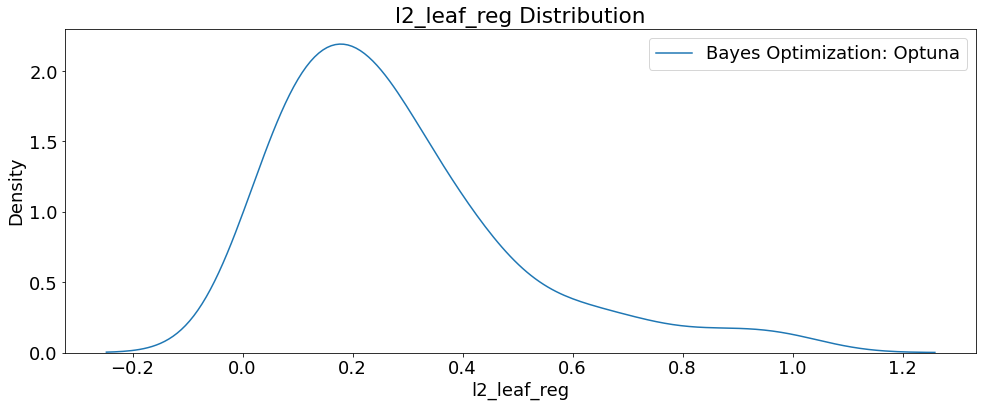

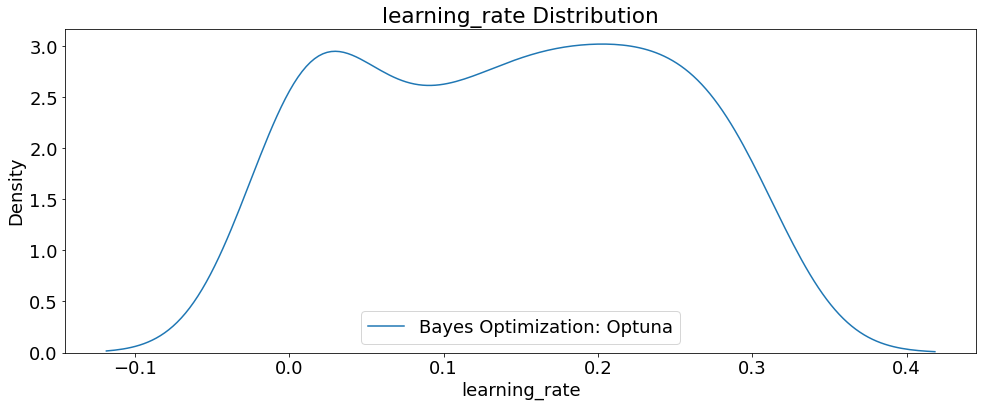

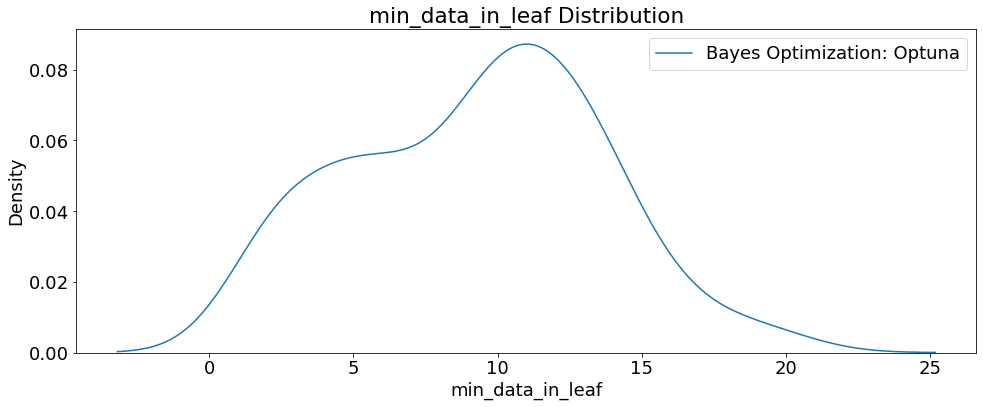

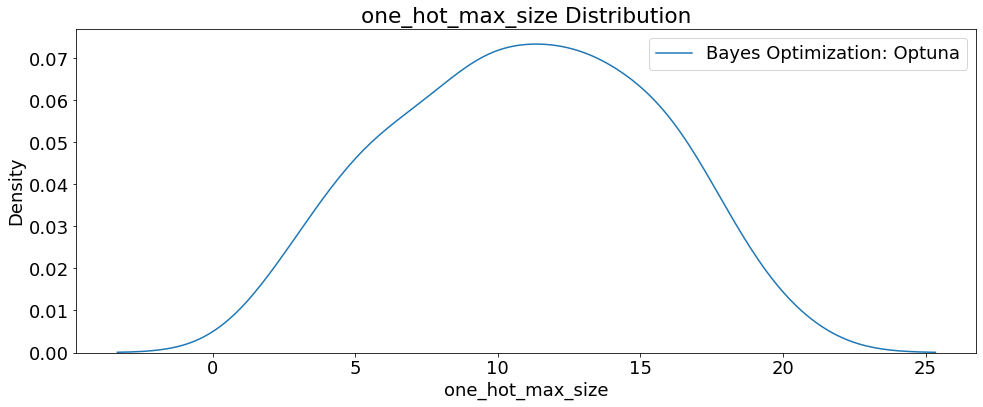

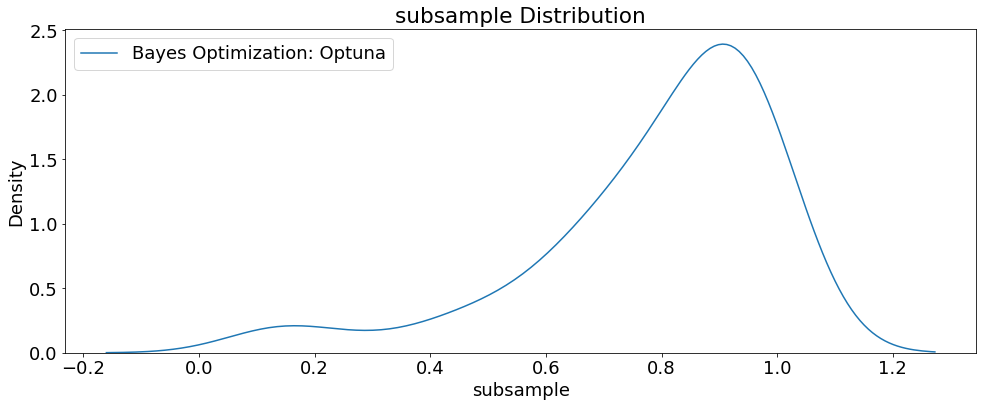

In [ ]:
# Create plots of Hyperparameters that are numeric 
for i, hpo in enumerate(trials_df.columns):
    if hpo not in ['iteration', 'rmse', 'datetime_start', 'datetime_complete',
                   'duration', 'n_estimators', 'state', 'boosting_type',
                   'bootstrap_type']:
        plt.figure(figsize=(14,6))
        # Plot the bayes search distribution
        if hpo != 'loss':
            sns.kdeplot(trials_df[hpo], label='Bayes Optimization: Optuna')
            plt.legend(loc=0)
            plt.title('{} Distribution'.format(hpo))
            plt.xlabel('{}'.format(hpo)); plt.ylabel('Density')
            plt.tight_layout()
            plt.show()

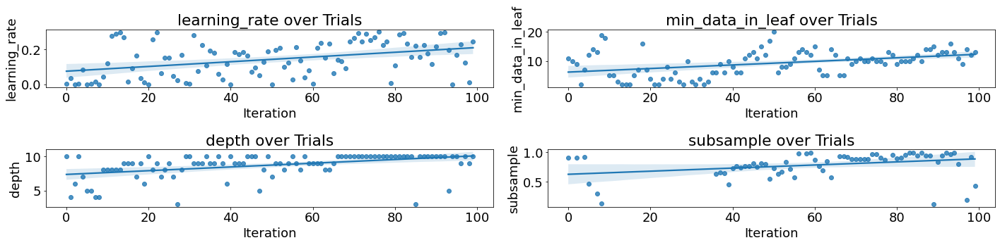

In [ ]:
# Plot quantitive hyperparameters
fig, axs = plt.subplots(2, 2, figsize=(20,5))
i = 0
axs = axs.flatten()
for i, hpo in enumerate(['learning_rate', 'min_data_in_leaf', 
                         'depth', 'subsample']):
  # Scatterplot
  sns.regplot('iteration', hpo, data=trials_df, ax=axs[i]) 
  axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo),  
             title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

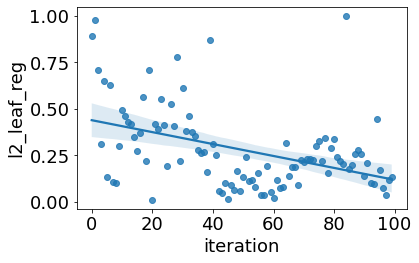

In [ ]:
# Scatterplot of regularization hyperparameters
ax = sns.regplot(x='iteration', y='l2_leaf_reg', data=trials_df)
plt.tight_layout()
plt.show()

In [ ]:
# Visualize parameter importances
fig = optuna.visualization.plot_param_importances(study)
py.plot(fig, filename='paramImportance_Catboost_Optuna_100_GPU_wb_trainValTestPool_RTX5000_cuml.html')
fig.show()

In [ ]:
# Visualize empirical distribution function
fig = optuna.visualization.plot_edf(study)
py.plot(fig, filename='edf_Catboost_Optuna_100_GPU_wb_trainValTestPool_RTX5000_cuml.html')
fig.show()

In [ ]:
# Arrange best parameters to fit model for model metrics
params = study.best_params   
params['random_state'] = seed_value
params

{'n_estimators': 202,
 'learning_rate': 0.29930867661858696,
 'depth': 10,
 'l2_leaf_reg': 0.10173225820233592,
 'min_data_in_leaf': 13,
 'one_hot_max_size': 14,
 'boosting_type': 'Plain',
 'bootstrap_type': 'Bernoulli',
 'subsample': 0.9970518734479302,
 'random_state': 42}

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/Catboost/Optuna/Model_PKL/

/notebooks/UsedCarsCarGurus/Models/ML/Catboost/Optuna/Model_PKL


In [ ]:
# Re-create the best model and train on the training data
best_model = CatBoostRegressor(loss_function='RMSE', 
                               task_type='GPU',
                               early_stopping_rounds=10, 
                               rsm=1, 
                               logging_level='Silent', 
                               **params)

# Fit the model
best_model.fit(train_features, train_label)

# Save model
Pkl_Filename = 'Catboost_Optuna_trials100_GPU_wb_trainValTestPool_RTX5000_cuml.pkl'  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(best_model, file)

# =============================================================================
# # To load saved model
# model = joblib.load('Catboost_Optuna_trials100_GPU_wb_trainValTestPool_RTX5000_cuml.pkl')
# print(model)
# =============================================================================

In [ ]:
print('\nModel Metrics for Catboost HPO 100 GPU trials')
y_train_pred = best_model.predict(train_features)
y_test_pred = best_model.predict(test_features)

print('MAE train: %.3f, test: %.3f' % (
        mean_absolute_error(train_label, y_train_pred),
        mean_absolute_error(test_label, y_test_pred)))
print('MSE train: %.3f, test: %.3f' % (
        mean_squared_error(train_label, y_train_pred),
        mean_squared_error(test_label, y_test_pred)))
print('RMSE train: %.3f, test: %.3f' % (
        mean_squared_error(train_label, y_train_pred, squared=False),
        mean_squared_error(test_label, y_test_pred, squared=False)))
print('R^2 train: %.3f, test: %.3f' % (
        r2_score(train_label, y_train_pred),
        r2_score(test_label, y_test_pred)))


Model Metrics for Catboost HPO 100 GPU trials
MAE train: 1669.836, test: 1813.900
MSE train: 5022040.722, test: 6001095.383
RMSE train: 2240.991, test: 2449.713
R^2 train: 0.945, test: 0.934


In [ ]:
# Evaluate on the testing data 
print('The best model from optimization scores {:.5f} MSE on the test set.'.format(mean_squared_error(asnumpy(test_label), 
                                                                                                      asnumpy(y_test_pred))))
print('This was achieved using these conditions:')
print(trials_df.iloc[0])

The best model from optimization scores 6001095.38303 MSE on the test set.
This was achieved using these conditions:
iteration                                      92
rmse                                  2472.180683
datetime_start         2023-01-17 21:49:55.106038
datetime_complete      2023-01-17 21:50:32.170595
duration                   0 days 00:00:37.064557
bagging_temperature                           NaN
boosting_type                               Plain
bootstrap_type                          Bernoulli
depth                                          10
l2_leaf_reg                              0.101732
learning_rate                            0.299309
min_data_in_leaf                               13
n_estimators                                  202
one_hot_max_size                               14
subsample                                0.997052
state                                    COMPLETE
Name: 92, dtype: object


# RTX A4000

In [ ]:
# Install/import dependencies
!pip install --upgrade pip
!pip install --upgrade -q wandb
!pip install catboost
!pip install optuna
!pip install plotly
!pip install eli5
!pip install shap
import os
import warnings
import random
import numpy as np
import cupy 
from cupy import asnumpy
import dask
from dask.distributed import Client, wait
from dask.diagnostics import ProgressBar
from dask_cuda import LocalCUDACluster
import dask_cudf
import urllib.request
from contextlib import contextmanager
import time
from datetime import datetime, timedelta
from timeit import default_timer as timer
import joblib
import cudf
import cuml
from sklearn.model_selection import train_test_split
from catboost import CatBoostRegressor, Pool
import optuna
from optuna import Trial
optuna.logging.set_verbosity(optuna.logging.WARNING) 
import wandb
from optuna.integration.wandb import WeightsAndBiasesCallback
import pickle
import pandas as pd
import plotly.offline as py
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
import matplotlib.pyplot as plt
import seaborn as sns
import eli5 
from eli5.sklearn import PermutationImportance 
import webbrowser
from eli5.formatters import format_as_dataframe
warnings.filterwarnings('ignore')
my_dpi = 96
os.environ['CUDA_VISIBLE_DEVICES'] = '0'
print('\n')
!nvidia-smi

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 23.5 MB/s eta 0:00:00a 0:00:01
  Attempting uninstall: pip
    Found existing installation: pip 22.0.3
    Uninstalling pip-22.0.3:
      Successfully uninstalled pip-22.0.3
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 76.6/76.6 MB 29.1 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 47.0/47.0 kB 14.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 15.2/15.2 MB 85.7 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 365.3/365.3 kB 36.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 210.6/210.6 kB 23.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.8/2.8 MB 88.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.7/78.7 kB 21.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 610.9/610.9 kB 69.3 MB/s eta 0:00:00
  Attempting uninstall: typing-extensions
    Found existing installation: typing_extensions 4.0.1
    

## 100 Trials Train/Test Pool

In [ ]:
# Create pool of train/test sets
train_data = Pool(train_features, train_label)
eval_data = Pool(test_features, test_label)

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/Catboost/Optuna/Model_PKL

/notebooks/UsedCarsCarGurus/Models/ML/Catboost/Optuna/Model_PKL


In [ ]:
# Set up wandb
wandb.login()

wandb_kwargs = {'project': 'usedCars_hpo', 'entity': 'aschultz', 
                'group': 'optuna_cat100gpu_A4000_trainTestPool_cuml',
                'save_code': 'False', 
                'notes': 'optuna_cat100gpu_A4000_trainTestPool_cuml'}
wandbc = WeightsAndBiasesCallback(wandb_kwargs=wandb_kwargs, as_multirun=True)

wandb: Currently logged in as: aschultz. Use `wandb login --relogin` to force relogin


In [ ]:
# Set up WB callbacks
@wandbc.track_in_wandb()

# Define a function for optimization of hyperparameters
def objective(trial):
    """
    Objective function to tune a `CatBoostRegressor` model.
    """
    joblib.dump(study, 'Cat_Optuna_100_GPU_wb_trainTestPool_A4000_cuml.pkl')

# Define parameter grid
    catboost_tune_kwargs = {
        'random_state': seed_value,
        'task_type':'GPU',
        'n_estimators': trial.suggest_int('n_estimators', 100, 500),
        'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 0.3),       
        'depth': trial.suggest_int('depth', 3, 10),
        'l2_leaf_reg': trial.suggest_float('l2_leaf_reg', 1e-2, 1e0),
        'min_data_in_leaf': trial.suggest_int('min_data_in_leaf', 2, 20),
        'one_hot_max_size': trial.suggest_int('one_hot_max_size', 2, 20), 
        'boosting_type': trial.suggest_categorical('boosting_type', 
                                                   ['Ordered', 'Plain']),
        'bootstrap_type': trial.suggest_categorical('bootstrap_type', 
                                                    ['Bayesian', 'Bernoulli', 
                                                     'MVS'])
        }   

    # Conditional Hyperparameters
    if catboost_tune_kwargs['bootstrap_type'] == 'Bayesian':
      catboost_tune_kwargs['bagging_temperature'] = trial.suggest_float('bagging_temperature', 
                                                                        0, 10)
    elif catboost_tune_kwargs['bootstrap_type'] == 'Bernoulli':
      catboost_tune_kwargs['subsample'] = trial.suggest_float('subsample', 
                                                              0.1, 1)
    
    # Define model type
    model = CatBoostRegressor(loss_function='RMSE', 
                              early_stopping_rounds=10,
                              rsm=1, 
                              logging_level='Silent',
                              **catboost_tune_kwargs)

    # Start timer for each trial
    start = timer()
    
    # Train the model
    model.fit(X=train_data, eval_set=eval_data)
    run_time = timer() - start

    # Predictions
    y_pred_val = model.predict(test_features)
    rmse = mean_squared_error(asnumpy(test_label), asnumpy(y_pred_val), 
                              squared=False)
    print('- Trial RMSE:', rmse)  
    
    return rmse

In [ ]:
# Begin HPO trials 
# Start timer for experiment
start_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
if os.path.isfile('Cat_Optuna_100_GPU_wb_trainTestPool_A4000_cuml.pkl'):
    study = joblib.load('Cat_Optuna_100_GPU_wb_trainTestPool_A4000_cuml.pkl')
else:
    study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=100, callbacks=[wandbc])

# End timer for experiment
end_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
print('%-20s %s' % ('End Time', end_time))
print(str(timedelta(seconds=(end_time-start_time).seconds)))
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Lowest RMSE', study.best_value)
wandb.finish()

Start Time           2023-02-07 19:01:40.585742


- Trial RMSE: 2988.8520274412617


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,MVS
depth,10


- Trial RMSE: 8538.848338995182


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,3.03739
boosting_type,Plain


- Trial RMSE: 5082.8134587826935


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,MVS
depth,5


- Trial RMSE: 9157.926529073826


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2813.308059890339


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 6600.925999230147


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,MVS
depth,8


- Trial RMSE: 4934.024016018454


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,4.75748
boosting_type,Plain


- Trial RMSE: 8130.615811285971


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,MVS
depth,8


- Trial RMSE: 8329.239852165203


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,MVS
depth,10


- Trial RMSE: 8728.092809962161


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,1.58836
boosting_type,Plain


- Trial RMSE: 3113.267245571158


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2574.3479749012313


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2572.2210660145533


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2570.8822372103955


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2545.0335345073095


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2852.1742074476097


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 3518.7318878304127


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2800.208876361418


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2632.1303754951314


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 3399.754725008445


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2983.3252777865596


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,9.97863
boosting_type,Ordered


- Trial RMSE: 2540.040862949465


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2708.390146895517


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2651.9514775172706


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 3048.458904149154


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2585.1191009207664


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 3066.3166384230303


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2563.433249964537


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2545.6293080420555


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2620.3830667712878


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,0.44346
boosting_type,Ordered


- Trial RMSE: 3458.5527583996645


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,MVS
depth,8


- Trial RMSE: 2572.181590315784


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2599.5558022402065


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2562.4109676036524


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2798.10063885881


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2809.0890817471695


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2511.799918131139


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2959.785715967112


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,7.89519
boosting_type,Plain


- Trial RMSE: 2770.784444828157


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,MVS
depth,10


- Trial RMSE: 2529.477087567981


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2701.6310376319


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,MVS
depth,10


- Trial RMSE: 2465.596208557335


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2530.304950385126


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2516.7599417319166


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2492.127112903063


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 3225.0953881793084


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2912.762101880718


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,6.15686
boosting_type,Plain


- Trial RMSE: 2465.8875211142004


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2443.0609497608953


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2653.0688771659775


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,MVS
depth,10


- Trial RMSE: 2430.3574069694173


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2433.364079674185


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2434.8888083125944


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2430.2697026070196


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2440.440665201407


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2532.907613750508


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2470.5736722559714


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2428.383778469272


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2589.027679210098


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,3.11455
boosting_type,Plain


- Trial RMSE: 2825.0624387737025


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2433.3636582795457


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2436.359900565732


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2428.9948770818405


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2444.8355215164593


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2429.926783048776


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2835.309651763958


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2454.0621699300114


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2815.2511720468915


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2442.529421311864


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2706.833768597794


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,MVS
depth,10


- Trial RMSE: 2445.986071258213


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2436.0216494469682


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2465.6920926790963


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2453.493288020333


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2436.69615873024


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2539.563019407154


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2459.787761139419


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2445.25158131165


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,0.05057
boosting_type,Plain


- Trial RMSE: 2469.98555509987


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2455.0067352184883


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2535.164818442922


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2436.013653851668


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2426.535912026413


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2431.5862633712895


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2442.1087204637456


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2449.623134133276


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2471.0675666330235


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2652.7623403040875


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,MVS
depth,10


- Trial RMSE: 2442.572110804702


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2506.5204009046774


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2428.0859246568953


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2447.6747123134664


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2460.469525027307


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2442.0748373265887


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2452.035134349523


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2688.509273588416


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,6.37827
boosting_type,Plain


- Trial RMSE: 2445.9011854478404


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2435.129897997261


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2499.011802673063


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2440.485130814733


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


Start Time           2023-02-07 19:01:40.585742
End Time             2023-02-07 19:34:41.493073
0:33:00


Number of finished trials: 100
Best trial: {'n_estimators': 500, 'learning_rate': 0.19521465224022572, 'depth': 10, 'l2_leaf_reg': 0.5667335052105306, 'min_data_in_leaf': 17, 'one_hot_max_size': 15, 'boosting_type': 'Plain', 'bootstrap_type': 'Bernoulli', 'subsample': 0.9424791660183555}
Lowest RMSE 2426.535912026413


In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/Catboost/Optuna/trialOptions/

/notebooks/UsedCarsCarGurus/Models/ML/Catboost/Optuna/trialOptions


In [ ]:
# Output from HPO trials
trials_df = study.trials_dataframe()
trials_df.rename(columns={'number': 'iteration'}, inplace=True)
trials_df.rename(columns={'value': 'rmse'}, inplace=True)
trials_df.rename(columns={'params_bagging_temperature': 'bagging_temperature'}, 
                 inplace=True)
trials_df.rename(columns={'params_boosting_type': 'boosting_type'}, 
                 inplace=True)
trials_df.rename(columns={'params_bootstrap_type': 'bootstrap_type'}, 
                 inplace=True)
trials_df.rename(columns={'params_depth': 'depth'}, inplace=True)
trials_df.rename(columns={'params_l2_leaf_reg': 'l2_leaf_reg'}, inplace=True)
trials_df.rename(columns={'params_learning_rate': 'learning_rate'}, 
                 inplace=True)
trials_df.rename(columns={'params_min_data_in_leaf': 'min_data_in_leaf'}, 
                 inplace=True)
trials_df.rename(columns={'params_n_estimators': 'n_estimators'}, inplace=True)
trials_df.rename(columns={'params_one_hot_max_size': 'one_hot_max_size'}, 
                 inplace=True)
trials_df.rename(columns={'params_subsample': 'subsample'}, inplace=True)
trials_df = trials_df.sort_values('rmse', ascending=True)
print(trials_df) 

# Write processed data to csv
trials_df.to_csv('Catboost_Optuna_100_GPU_wb_trainTestPool_A4000_cuml.csv', 
                 index=False)

    iteration         rmse             datetime_start  \
82         82  2426.535912 2023-02-07 19:28:45.210274   
90         90  2428.085925 2023-02-07 19:31:27.200958   
57         57  2428.383778 2023-02-07 19:21:09.723271   
62         62  2428.994877 2023-02-07 19:22:35.266150   
64         64  2429.926783 2023-02-07 19:23:16.519271   
..        ...          ...                        ...   
7           7  8130.615811 2023-02-07 19:04:06.929407   
8           8  8329.239852 2023-02-07 19:04:36.808030   
1           1  8538.848339 2023-02-07 19:02:07.977569   
9           9  8728.092810 2023-02-07 19:05:05.814079   
3           3  9157.926529 2023-02-07 19:02:52.363776   

            datetime_complete               duration  bagging_temperature  \
82 2023-02-07 19:29:03.106977 0 days 00:00:17.896703                  NaN   
90 2023-02-07 19:31:44.191447 0 days 00:00:16.990489                  NaN   
57 2023-02-07 19:21:22.644729 0 days 00:00:12.921458                  NaN   
62 2023

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/Catboost/Optuna/Model_Explanations/

/notebooks/UsedCarsCarGurus/Models/ML/Catboost/Optuna/Model_Explanations


In [ ]:
# Plot_optimization_history: shows the scores from all trials as well as the best score so far at each point.
fig = optuna.visualization.plot_optimization_history(study)
py.plot(fig, filename='optimizationHistory_Catboost_Optuna_100_GPU_wb_trainTestPool_A4000_cuml.html')
fig.show()

In [ ]:
# plot_parallel_coordinate: interactively visualizes the hyperparameters and scores
fig = optuna.visualization.plot_parallel_coordinate(study)
py.plot(fig, filename='parallelCoordinate_Catboost_Optuna_100_GPU_wb_trainTestPool_A4000_cuml.html')
fig.show()

[W 2023-02-07 19:34:41,883] Your study has only completed trials with missing parameters.


In [ ]:
# plot_slice: shows the change of the hyperparameters space over the search. 
fig = optuna.visualization.plot_slice(study)
py.plot(fig, filename='slice_Catboost_Optuna_100_GPU_wb_trainTestPool_A4000_cuml.html')
fig.show()

In [ ]:
# plot_contour: plots parameter interactions on an interactive chart
fig = optuna.visualization.plot_contour(study, params=['depth', 
                                                       'subsample', 
                                                       'learning_rate', 
                                                       'subsample'])
py.plot(fig, filename='contour_Catboost_Optuna_100_GPU_wb_trainTestPool_A4000_cuml.html')
fig.show()

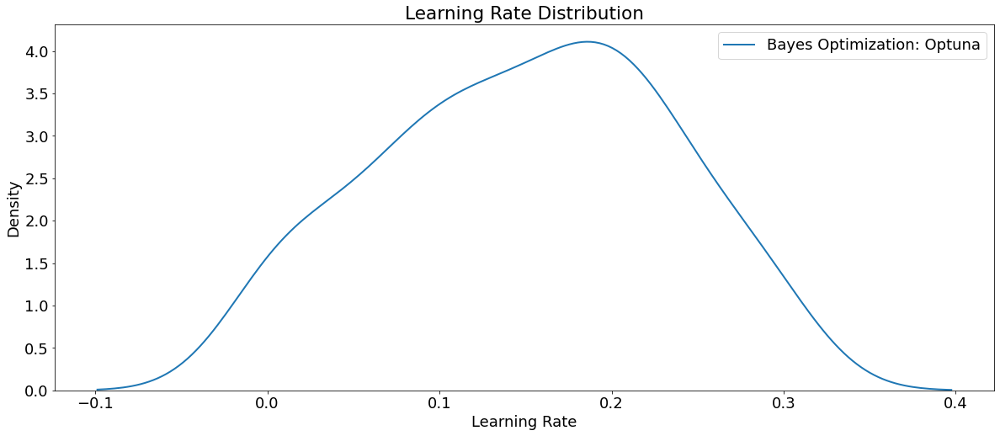

In [ ]:
# Density plots of the learning rate distributions 
plt.figure(figsize=(20,8))
plt.rcParams['font.size'] = 18
sns.kdeplot(trials_df['learning_rate'], label='Bayes Optimization: Optuna', 
            linewidth=2)
plt.legend(loc=1)
plt.xlabel('Learning Rate'); plt.ylabel('Density'); plt.title('Learning Rate Distribution');
plt.show()

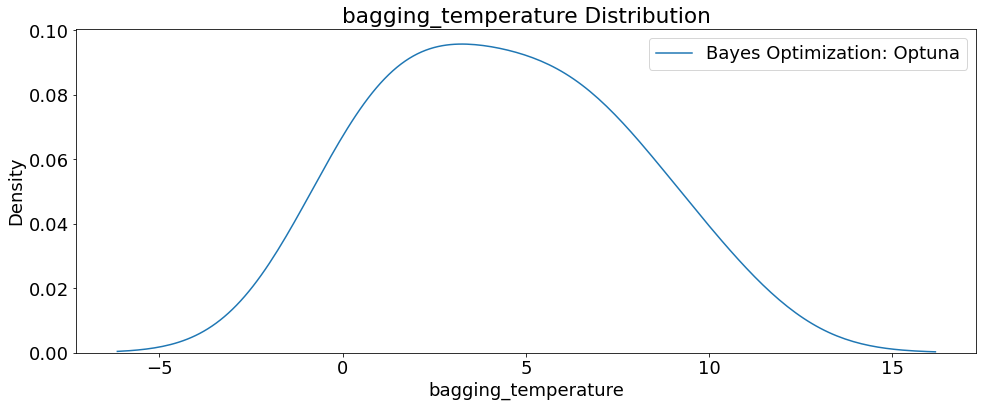

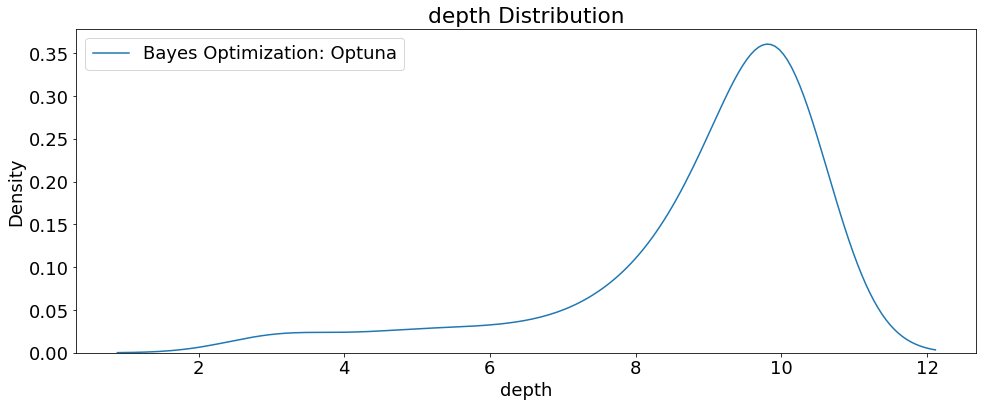

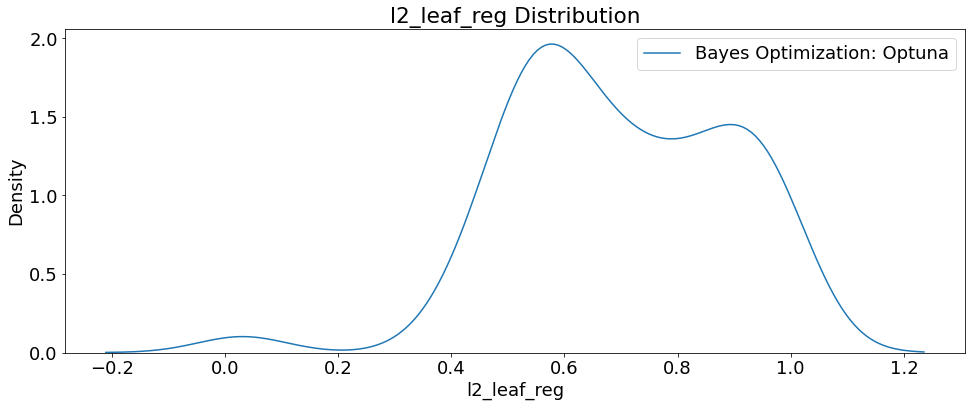

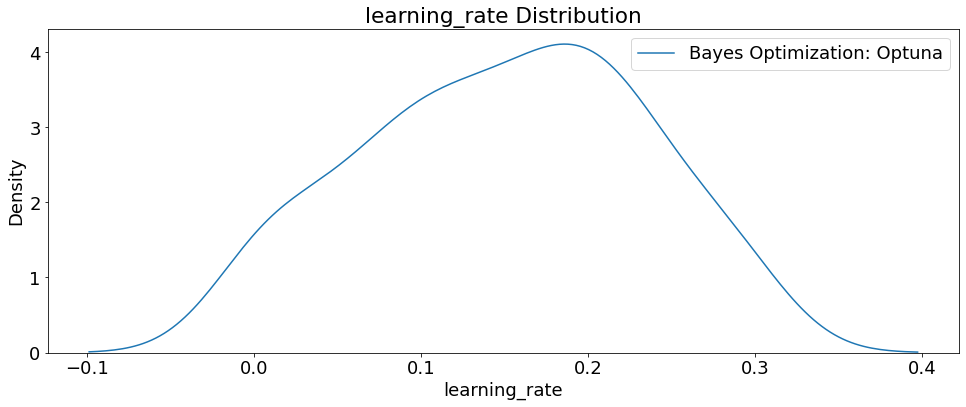

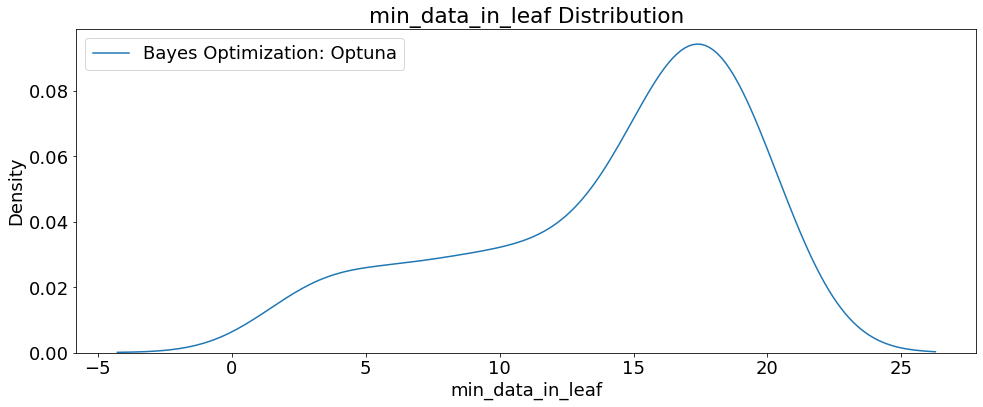

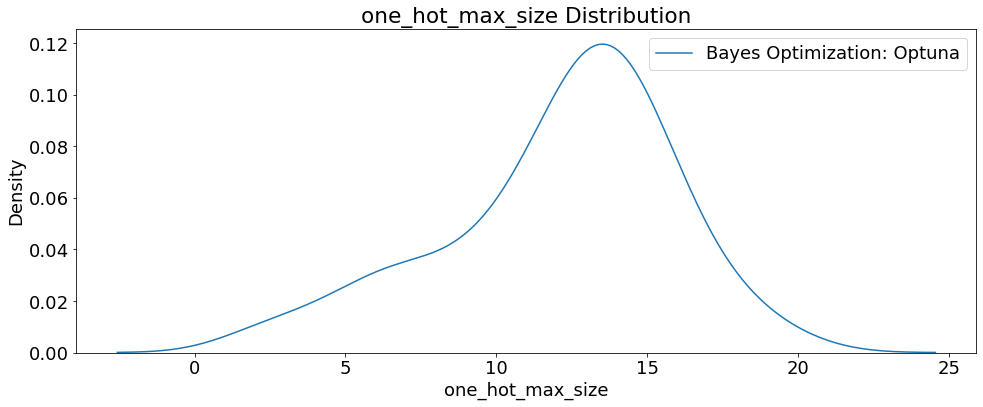

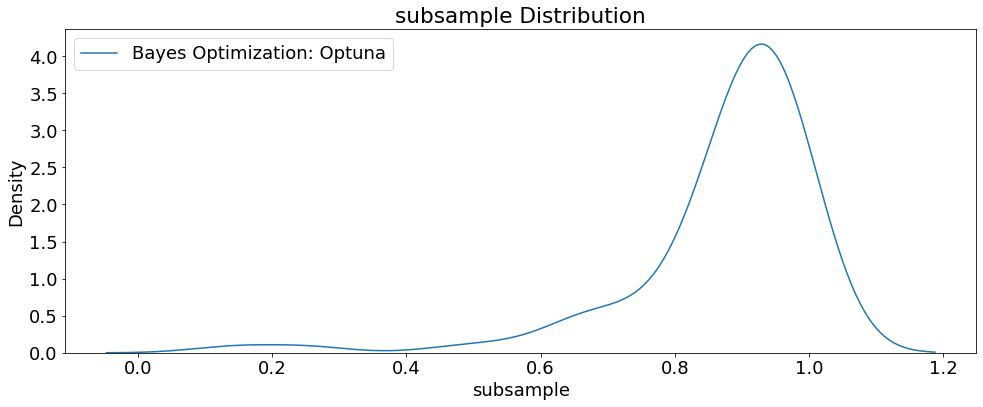

In [ ]:
# Create plots of Hyperparameters that are numeric 
for i, hpo in enumerate(trials_df.columns):
    if hpo not in ['iteration', 'rmse', 'datetime_start', 'datetime_complete',
                   'duration', 'n_estimators', 'state', 'boosting_type',
                   'bootstrap_type']:
        plt.figure(figsize=(14,6))
        # Plot the bayes search distribution
        if hpo != 'loss':
            sns.kdeplot(trials_df[hpo], label='Bayes Optimization: Optuna')
            plt.legend(loc=0)
            plt.title('{} Distribution'.format(hpo))
            plt.xlabel('{}'.format(hpo)); plt.ylabel('Density')
            plt.tight_layout()
            plt.show()

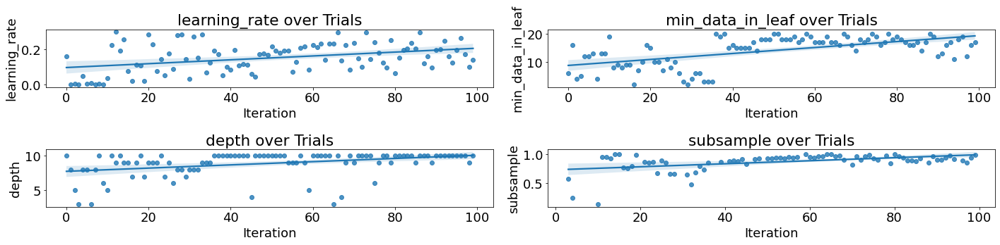

In [ ]:
# Plot quantitive hyperparameters
fig, axs = plt.subplots(2, 2, figsize=(20,5))
i = 0
axs = axs.flatten()
for i, hpo in enumerate(['learning_rate', 'min_data_in_leaf', 
                         'depth', 'subsample']):
  # Scatterplot
  sns.regplot('iteration', hpo, data=trials_df, ax=axs[i]) 
  axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo),  
             title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

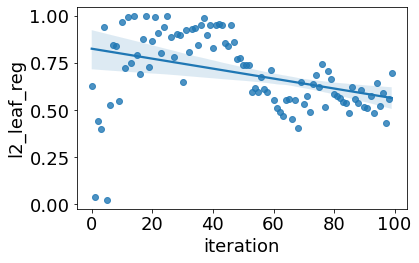

In [ ]:
# Scatterplot of regularization hyperparameters
ax = sns.regplot(x='iteration', y='l2_leaf_reg', data=trials_df)
plt.tight_layout()
plt.show()

In [ ]:
# Visualize parameter importances
fig = optuna.visualization.plot_param_importances(study)
py.plot(fig, filename='paramImportance_Catboost_Optuna_100_GPU_wb_trainTestPool_A4000_cuml.html')
fig.show()

In [ ]:
# Visualize empirical distribution function
fig = optuna.visualization.plot_edf(study)
py.plot(fig, filename='edf_Catboost_Optuna_100_GPU_wb_trainTestPool_A4000_cuml.html')
fig.show()

In [ ]:
# Arrange best parameters to fit model for model metrics
params = study.best_params   
params['random_state'] = seed_value
params

{'n_estimators': 500,
 'learning_rate': 0.19521465224022572,
 'depth': 10,
 'l2_leaf_reg': 0.5667335052105306,
 'min_data_in_leaf': 17,
 'one_hot_max_size': 15,
 'boosting_type': 'Plain',
 'bootstrap_type': 'Bernoulli',
 'subsample': 0.9424791660183555,
 'random_state': 42}

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/Catboost/Optuna/Model_PKL/

/notebooks/UsedCarsCarGurus/Models/ML/Catboost/Optuna/Model_PKL


In [ ]:
# Re-create the best model and train on the training data
best_model = CatBoostRegressor(loss_function='RMSE', 
                               task_type='GPU',
                               early_stopping_rounds=10, 
                               rsm=1, 
                               logging_level='Silent', 
                               **params)

# Fit the model
best_model.fit(train_features, train_label)

# Save model
Pkl_Filename = 'Catboost_Optuna_trials100_GPU_wb_trainTestPool_A4000_cuml.pkl'  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(best_model, file)

# =============================================================================
# # To load saved model
# model = joblib.load('Catboost_Optuna_trials100_GPU_wb_trainTestPool_A4000_cuml.pkl')
# print(model)
# =============================================================================

In [ ]:
print('\nModel Metrics for Catboost HPO 100 GPU trials')
y_train_pred = best_model.predict(train_features)
y_test_pred = best_model.predict(test_features)

print('MAE train: %.3f, test: %.3f' % (
        mean_absolute_error(train_label, y_train_pred),
        mean_absolute_error(test_label, y_test_pred)))
print('MSE train: %.3f, test: %.3f' % (
        mean_squared_error(train_label, y_train_pred),
        mean_squared_error(test_label, y_test_pred)))
print('RMSE train: %.3f, test: %.3f' % (
        mean_squared_error(train_label, y_train_pred, squared=False),
        mean_squared_error(test_label, y_test_pred, squared=False)))
print('R^2 train: %.3f, test: %.3f' % (
        r2_score(train_label, y_train_pred),
        r2_score(test_label, y_test_pred)))


Model Metrics for Catboost HPO 100 GPU trials
MAE train: 1539.532, test: 1774.182
MSE train: 4285259.200, test: 5783583.588
RMSE train: 2070.087, test: 2404.908
R^2 train: 0.953, test: 0.937


In [ ]:
# Evaluate on the testing data 
print('The best model from optimization scores {:.5f} MSE on the test set.'.format(mean_squared_error(asnumpy(test_label), 
                                                                                                      asnumpy(y_test_pred))))
print('This was achieved using these conditions:')
print(trials_df.iloc[0])

The best model from optimization scores 5783583.58828 MSE on the test set.
This was achieved using these conditions:
iteration                                      82
rmse                                  2426.535912
datetime_start         2023-02-07 19:28:45.210274
datetime_complete      2023-02-07 19:29:03.106977
duration                   0 days 00:00:17.896703
bagging_temperature                           NaN
boosting_type                               Plain
bootstrap_type                          Bernoulli
depth                                          10
l2_leaf_reg                              0.566734
learning_rate                            0.195215
min_data_in_leaf                               17
n_estimators                                  500
one_hot_max_size                               15
subsample                                0.942479
state                                    COMPLETE
Name: 82, dtype: object


## 100 Trials Train/Validation/Test Pool

In [ ]:
# Create pool of train/test sets
train_data = Pool(train_Features, train_Label)
eval_data = Pool(val_features, val_label)

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/Catboost/Optuna/Model_PKL

/notebooks/UsedCarsCarGurus/Models/ML/Catboost/Optuna/Model_PKL


In [ ]:
# Set up wandb
wandb.login()

wandb_kwargs = {'project': 'usedCars_hpo', 'entity': 'aschultz', 
                'group': 'optuna_cat100gpu_A4000_trainValTestPool_cuml', 
                'save_code': 'False', 
                'notes': 'optuna_cat100gpu_A4000_trainValTestPool_cuml'}
wandbc = WeightsAndBiasesCallback(wandb_kwargs=wandb_kwargs, as_multirun=True)

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:

  ········································


wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


In [ ]:
# Set up WB callbacks
@wandbc.track_in_wandb()

# Define a function for optimization of hyperparameters
def objective(trial):
    """
    Objective function to tune a `CatBoostRegressor` model.
    """
    joblib.dump(study, 'Cat_Optuna_100_GPU_wb_trainValTest_A4000_cuml.pkl')

# Define parameter grid
    catboost_tune_kwargs = {
        'random_state': seed_value,
        'task_type':'GPU',
        'n_estimators': trial.suggest_int('n_estimators', 100, 500),
        'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 0.3),       
        'depth': trial.suggest_int('depth', 3, 10),
        'l2_leaf_reg': trial.suggest_float('l2_leaf_reg', 1e-2, 1e0),
        'min_data_in_leaf': trial.suggest_int('min_data_in_leaf', 2, 20),
        'one_hot_max_size': trial.suggest_int('one_hot_max_size', 2, 20), 
        'boosting_type': trial.suggest_categorical('boosting_type', 
                                                   ['Ordered', 'Plain']),
        'bootstrap_type': trial.suggest_categorical('bootstrap_type', 
                                                    ['Bayesian', 'Bernoulli', 
                                                     'MVS'])
        }   

    # Conditional Hyperparameters
    if catboost_tune_kwargs['bootstrap_type'] == 'Bayesian':
      catboost_tune_kwargs['bagging_temperature'] = trial.suggest_float('bagging_temperature', 
                                                                        0, 10)
    elif catboost_tune_kwargs['bootstrap_type'] == 'Bernoulli':
      catboost_tune_kwargs['subsample'] = trial.suggest_float('subsample', 
                                                              0.1, 1)
    
    # Define model type
    model = CatBoostRegressor(loss_function='RMSE', 
                              early_stopping_rounds=10,
                              rsm=1, 
                              logging_level='Silent',
                              **catboost_tune_kwargs)
    
    # Start timer for each trial
    start = timer()
    
    # Train the model
    model.fit(X=train_data, eval_set=eval_data) 
    run_time = timer() - start

    # Predictions
    y_pred_val = model.predict(val_features)
    rmse = mean_squared_error(asnumpy(val_label), asnumpy(y_pred_val), 
                              squared=False)
    print('- Trial RMSE:', rmse)  
    
    return rmse

In [ ]:
# Begin HPO trials 
# Start timer for experiment
start_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
if os.path.isfile('Cat_Optuna_100_GPU_wb_trainValTest_A4000_cuml.pkl'):
    study = joblib.load('Cat_Optuna_100_GPU_wb_trainValTest_A4000_cuml.pkl')
else:
    study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=100, callbacks=[wandbc])

# End timer for experiment
end_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
print('%-20s %s' % ('End Time', end_time))
print(str(timedelta(seconds=(end_time-start_time).seconds)))
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Lowest RMSE', study.best_value)
wandb.finish()

wandb: Currently logged in as: aschultz. Use `wandb login --relogin` to force relogin


Start Time           2023-02-08 22:45:30.152514


- Trial RMSE: 3584.4581163538105


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 8660.038831980079


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 5529.851059969597


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,1.24475
boosting_type,Plain


- Trial RMSE: 9115.696008934987


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,9.4689
boosting_type,Plain


- Trial RMSE: 4220.227224690268


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,4.51547
boosting_type,Plain


- Trial RMSE: 5281.57273078384


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,3.74938
boosting_type,Ordered


- Trial RMSE: 7148.9915953476475


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 9332.28062285772


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,MVS
depth,6


- Trial RMSE: 8509.38113702916


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,8.23656
boosting_type,Ordered


- Trial RMSE: 2852.2751765084827


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,4.04815
boosting_type,Plain


- Trial RMSE: 2716.1041444721154


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,MVS
depth,10


- Trial RMSE: 2717.109625366505


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,MVS
depth,10


- Trial RMSE: 2713.7303926237123


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,MVS
depth,10


- Trial RMSE: 2751.249389247322


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,MVS
depth,10


- Trial RMSE: 2780.8250394551383


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,MVS
depth,9


- Trial RMSE: 2808.8972212835633


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,MVS
depth,10


- Trial RMSE: 2695.2038469675813


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,MVS
depth,9


- Trial RMSE: 3031.0894633403896


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,MVS
depth,9


- Trial RMSE: 2809.128631416569


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,MVS
depth,8


- Trial RMSE: 9422.302724050325


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,MVS
depth,9


- Trial RMSE: 3654.989995076323


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,MVS
depth,6


- Trial RMSE: 2713.2206727404005


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,MVS
depth,10


- Trial RMSE: 2738.9116794764604


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,MVS
depth,10


- Trial RMSE: 2753.628089858988


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,MVS
depth,9


- Trial RMSE: 2804.799396254749


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,MVS
depth,8


- Trial RMSE: 2549.277088368386


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2610.202412177652


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2719.0911231251775


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2558.0654244792786


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2901.29474270078


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 3134.233874742295


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2567.843894870038


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2548.7468226119363


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2611.0754022228252


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2661.488868739323


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 3091.1665890825625


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 3729.179967110702


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2982.4790963714795


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2530.5188442088374


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 3031.1741955081648


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2914.8531070785884


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2565.4584281845828


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2561.7996806376304


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2548.420933515933


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2650.1605069434713


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2594.430735782164


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,0.01628
boosting_type,Ordered


- Trial RMSE: 2608.0730499794404


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2678.514689445335


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2571.057650796755


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 3054.203429897452


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,7.13291
boosting_type,Ordered


- Trial RMSE: 3343.64915222235


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2539.0481434270305


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2567.7300306121647


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2541.9296169330173


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2569.1414074909235


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2530.40159312698


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2563.5103313134227


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 3025.08009294455


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,6.55853
boosting_type,Ordered


- Trial RMSE: 2556.719331793278


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2695.123110985103


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2552.3808776693127


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2611.8178734458497


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2529.190089811291


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2531.901257651625


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2535.3526047105142


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2533.5700016746264


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2564.733010817029


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 3084.806046066452


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,9.45149
boosting_type,Ordered


- Trial RMSE: 2540.3856779624593


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2549.3769078525247


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2568.1636104325908


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2549.187865586074


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2559.283369502773


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2548.5989930297346


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2598.236715224446


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2623.409012148247


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2552.35216196911


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2557.1783343371003


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2572.2332473628758


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2658.280323908173


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2609.57262393712


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2555.4207950338646


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2535.2998541974953


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2542.426022279869


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2592.0440167774227


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2547.1877312894903


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2903.804339382367


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,5.78302
boosting_type,Ordered


- Trial RMSE: 2550.226182635255


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2570.2768426020807


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2521.9963837322925


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2575.383270295052


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2494.1964783388353


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2487.998969355098


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2490.694718710519


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2500.6704682516165


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2564.6589082695427


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2931.0404014977607


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,MVS
depth,7


- Trial RMSE: 2535.3184950605973


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2553.5632012806823


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2615.3743484918605


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


Start Time           2023-02-08 22:45:30.152514
End Time             2023-02-08 23:22:56.679682
0:37:26


Number of finished trials: 100
Best trial: {'n_estimators': 287, 'learning_rate': 0.2850436302855309, 'depth': 8, 'l2_leaf_reg': 0.19045672151030227, 'min_data_in_leaf': 14, 'one_hot_max_size': 19, 'boosting_type': 'Plain', 'bootstrap_type': 'Bernoulli', 'subsample': 0.9410999120568411}
Lowest RMSE 2487.998969355098


In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/Catboost/Optuna/trialOptions/

/notebooks/UsedCarsCarGurus/Models/ML/Catboost/Optuna/trialOptions


In [ ]:
# Output from HPO trials
trials_df = study.trials_dataframe()
trials_df.rename(columns={'number': 'iteration'}, inplace=True)
trials_df.rename(columns={'value': 'rmse'}, inplace=True)
trials_df.rename(columns={'params_bagging_temperature': 'bagging_temperature'}, 
                 inplace=True)
trials_df.rename(columns={'params_boosting_type': 'boosting_type'}, 
                 inplace=True)
trials_df.rename(columns={'params_bootstrap_type': 'bootstrap_type'}, 
                 inplace=True)
trials_df.rename(columns={'params_depth': 'depth'}, inplace=True)
trials_df.rename(columns={'params_l2_leaf_reg': 'l2_leaf_reg'}, inplace=True)
trials_df.rename(columns={'params_learning_rate': 'learning_rate'}, 
                 inplace=True)
trials_df.rename(columns={'params_min_data_in_leaf': 'min_data_in_leaf'}, 
                 inplace=True)
trials_df.rename(columns={'params_n_estimators': 'n_estimators'}, inplace=True)
trials_df.rename(columns={'params_one_hot_max_size': 'one_hot_max_size'}, 
                 inplace=True)
trials_df.rename(columns={'params_subsample': 'subsample'}, inplace=True)
trials_df = trials_df.sort_values('rmse', ascending=True)
print(trials_df) 

# Write processed data to csv
trials_df.to_csv('Catboost_Optuna_100_GPU_wb_trainValTestPool_A4000_cuml.csv', 
                 index=False)

    iteration         rmse             datetime_start  \
92         92  2487.998969 2023-02-08 23:20:34.699535   
93         93  2490.694719 2023-02-08 23:20:51.371736   
91         91  2494.196478 2023-02-08 23:20:19.656117   
94         94  2500.670468 2023-02-08 23:21:07.485534   
89         89  2521.996384 2023-02-08 23:19:42.945233   
..        ...          ...                        ...   
8           8  8509.381137 2023-02-08 22:48:05.592838   
1           1  8660.038832 2023-02-08 22:45:48.486187   
3           3  9115.696009 2023-02-08 22:46:21.806632   
7           7  9332.280623 2023-02-08 22:47:48.581346   
19         19  9422.302724 2023-02-08 22:51:22.580414   

            datetime_complete               duration  bagging_temperature  \
92 2023-02-08 23:20:46.044254 0 days 00:00:11.344719                  NaN   
93 2023-02-08 23:21:02.870966 0 days 00:00:11.499230                  NaN   
91 2023-02-08 23:20:30.633696 0 days 00:00:10.977579                  NaN   
94 2023

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/Catboost/Optuna/Model_Explanations/

/notebooks/UsedCarsCarGurus/Models/ML/Catboost/Optuna/Model_Explanations


In [ ]:
# Plot_optimization_history: shows the scores from all trials as well as the best score so far at each point.
fig = optuna.visualization.plot_optimization_history(study)
py.plot(fig, filename='optimizationHistory_Catboost_Optuna_100_GPU_wb_trainValTestPool_A4000_cuml.html')
fig.show()

In [ ]:
# plot_parallel_coordinate: interactively visualizes the hyperparameters and scores
fig = optuna.visualization.plot_parallel_coordinate(study)
py.plot(fig, filename='parallelCoordinate_Catboost_Optuna_100_GPU_wb_trainValTestPool_A4000_cuml.html')
fig.show()

[W 2023-02-08 23:22:57,093] Your study has only completed trials with missing parameters.


In [ ]:
# plot_slice: shows the change of the hyperparameters space over the search. 
fig = optuna.visualization.plot_slice(study)
py.plot(fig, filename='slice_Catboost_Optuna_100_GPU_wb_trainValTestPool_A4000_cuml.html')
fig.show()

In [ ]:
# plot_contour: plots parameter interactions on an interactive chart
fig = optuna.visualization.plot_contour(study, params=['depth', 
                                                       'subsample', 
                                                       'learning_rate', 
                                                       'subsample'])
py.plot(fig, filename='contour_Catboost_Optuna_100_GPU_wb_trainValTestPool_A4000_cuml.html')
fig.show()

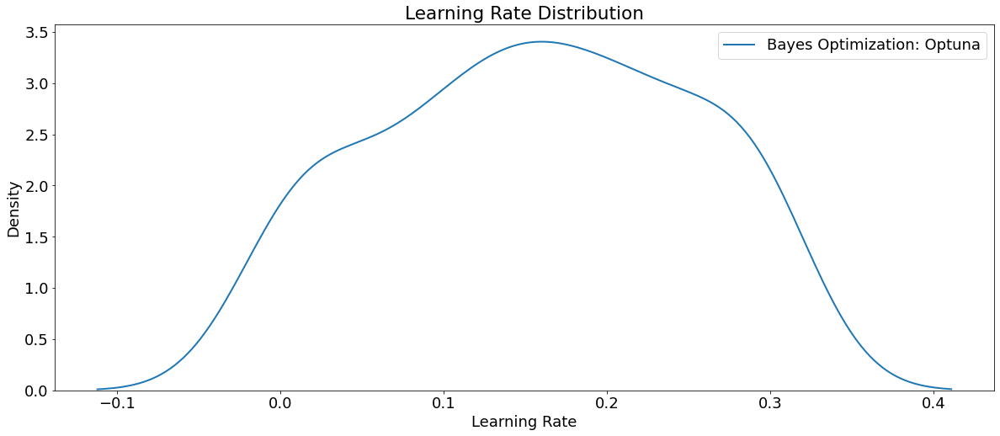

In [ ]:
# Density plots of the learning rate distributions 
plt.figure(figsize=(20,8))
plt.rcParams['font.size'] = 18
sns.kdeplot(trials_df['learning_rate'], label='Bayes Optimization: Optuna', 
            linewidth=2)
plt.legend(loc=1)
plt.xlabel('Learning Rate'); plt.ylabel('Density'); plt.title('Learning Rate Distribution');
plt.show()

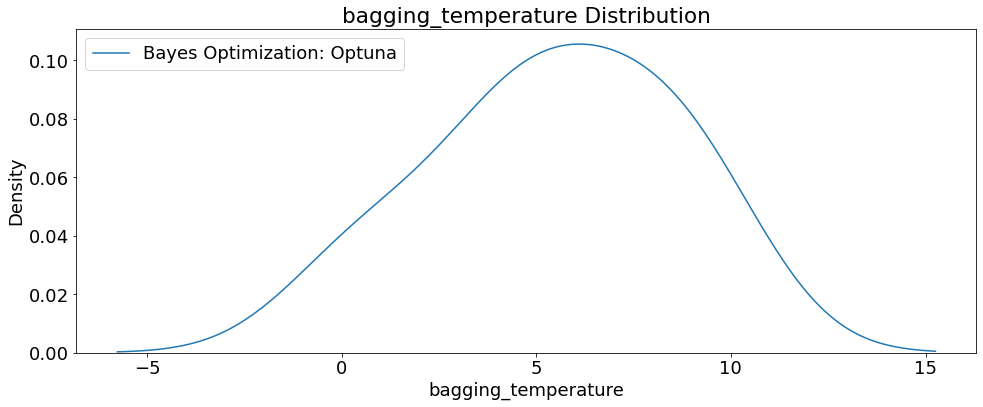

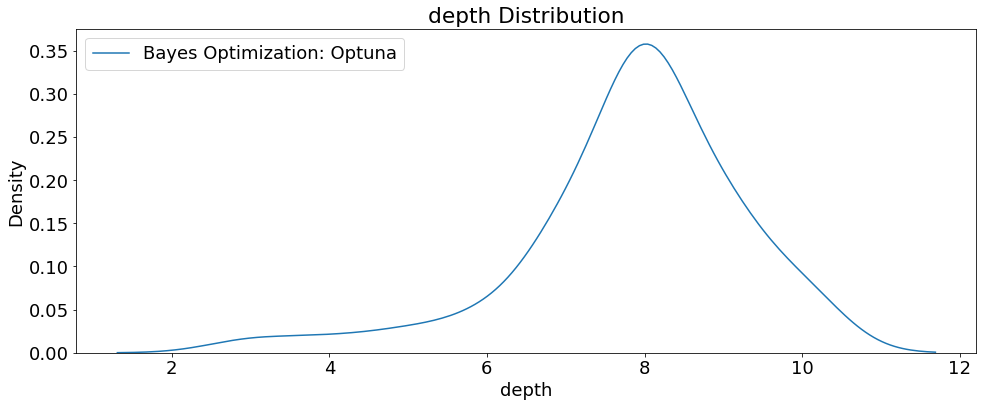

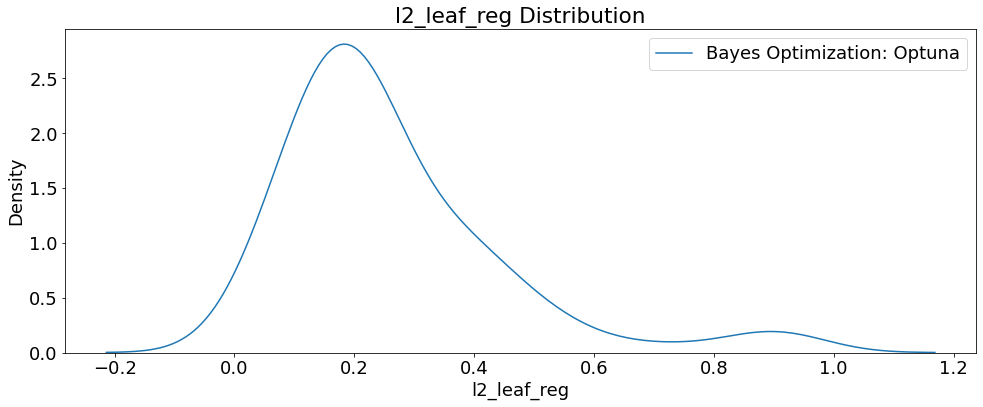

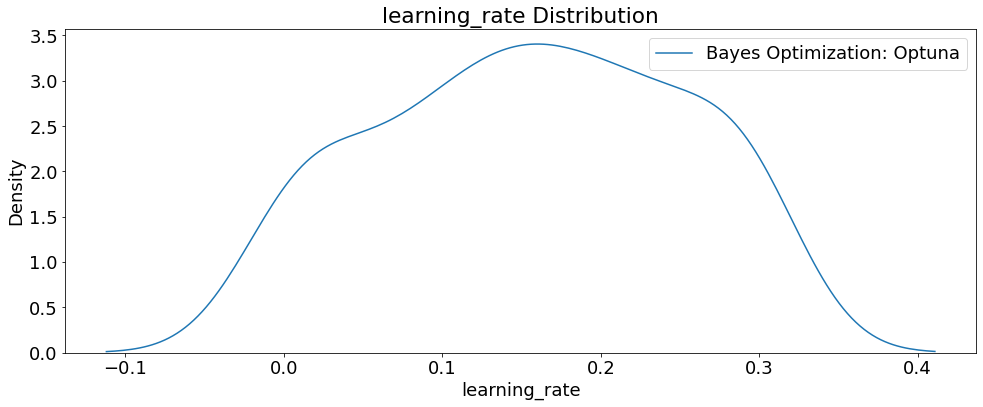

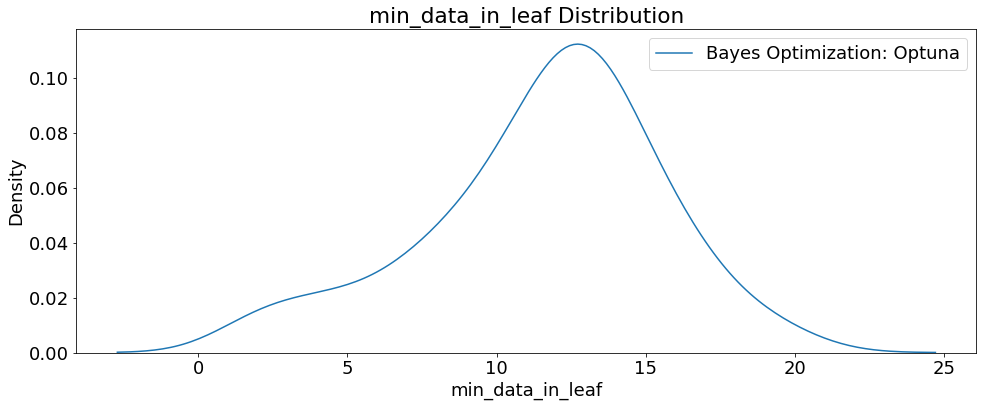

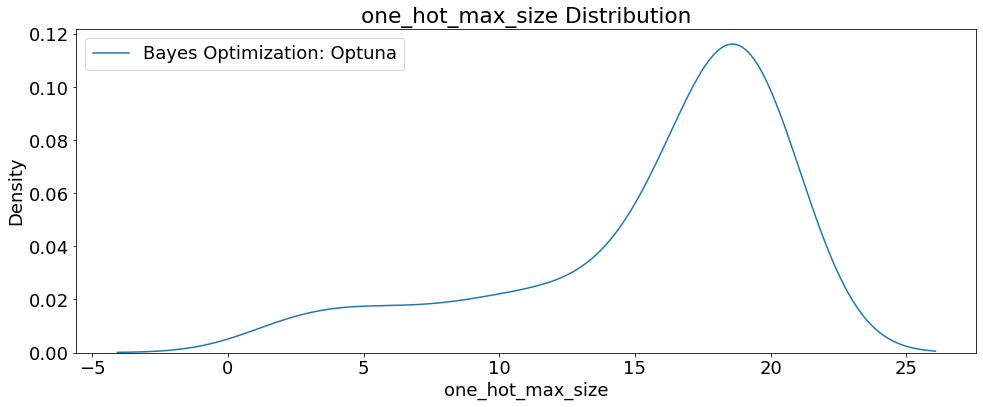

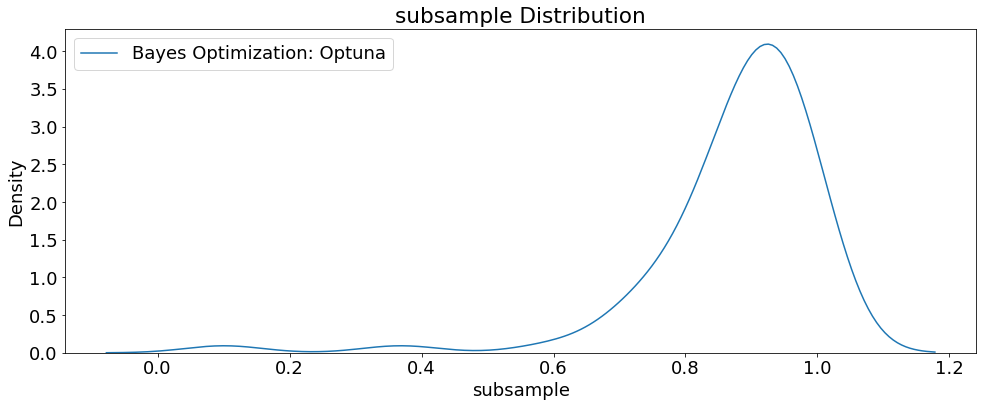

In [ ]:
# Create plots of Hyperparameters that are numeric 
for i, hpo in enumerate(trials_df.columns):
    if hpo not in ['iteration', 'rmse', 'datetime_start', 'datetime_complete',
                   'duration', 'n_estimators', 'state', 'boosting_type',
                   'bootstrap_type']:
        plt.figure(figsize=(14,6))
        # Plot the bayes search distribution
        if hpo != 'loss':
            sns.kdeplot(trials_df[hpo], label='Bayes Optimization: Optuna')
            plt.legend(loc=0)
            plt.title('{} Distribution'.format(hpo))
            plt.xlabel('{}'.format(hpo)); plt.ylabel('Density')
            plt.tight_layout()
            plt.show()

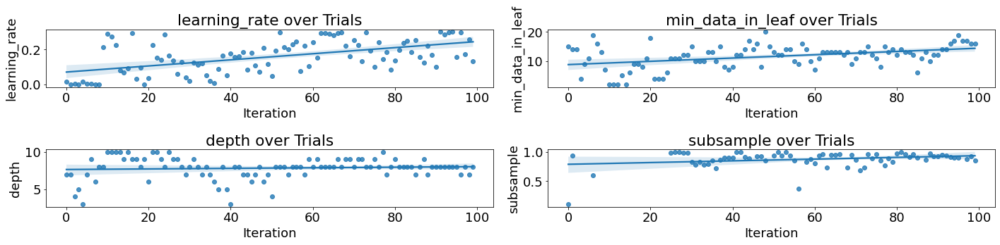

In [ ]:
# Plot quantitive hyperparameters
fig, axs = plt.subplots(2, 2, figsize=(20,5))
i = 0
axs = axs.flatten()
for i, hpo in enumerate(['learning_rate', 'min_data_in_leaf', 
                         'depth', 'subsample']):
  # Scatterplot
  sns.regplot('iteration', hpo, data=trials_df, ax=axs[i]) 
  axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo),  
             title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

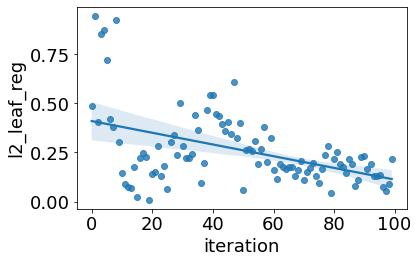

In [ ]:
# Scatterplot of regularization hyperparameters
ax = sns.regplot(x='iteration', y='l2_leaf_reg', data=trials_df)
plt.tight_layout()
plt.show()

In [ ]:
# Visualize parameter importances
fig = optuna.visualization.plot_param_importances(study)
py.plot(fig, filename='paramImportance_Catboost_Optuna_100_GPU_wb_trainValTestPool_A4000_cuml.html')
fig.show()

In [ ]:
# Visualize empirical distribution function
fig = optuna.visualization.plot_edf(study)
py.plot(fig, filename='edf_Catboost_Optuna_100_GPU_wb_trainValTestPool_A4000_cuml.html')
fig.show()

In [ ]:
# Arrange best parameters to fit model for model metrics
params = study.best_params   
params['random_state'] = seed_value
params

{'n_estimators': 287,
 'learning_rate': 0.2850436302855309,
 'depth': 8,
 'l2_leaf_reg': 0.19045672151030227,
 'min_data_in_leaf': 14,
 'one_hot_max_size': 19,
 'boosting_type': 'Plain',
 'bootstrap_type': 'Bernoulli',
 'subsample': 0.9410999120568411,
 'random_state': 42}

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/Catboost/Optuna/Model_PKL/

/notebooks/UsedCarsCarGurus/Models/ML/Catboost/Optuna/Model_PKL


In [ ]:
# Re-create the best model and train on the training data
best_model = CatBoostRegressor(loss_function='RMSE', 
                               task_type='GPU',
                               early_stopping_rounds=10, 
                               rsm=1, 
                               logging_level='Silent', 
                               **params)

# Fit the model
best_model.fit(train_features, train_label)

# Save model
Pkl_Filename = 'Catboost_Optuna_trials100_GPU_wb_trainValTestPool_A4000_cuml.pkl'  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(best_model, file)

# =============================================================================
# # To load saved model
# model = joblib.load('Catboost_Optuna_trials100_GPU_wb_trainValTestPol_A4000_cuml.pkl')
# print(model)
# =============================================================================

In [ ]:
print('\nModel Metrics for Catboost HPO 100 GPU trials')
y_train_pred = best_model.predict(train_features)
y_test_pred = best_model.predict(test_features)

print('MAE train: %.3f, test: %.3f' % (
        mean_absolute_error(train_label, y_train_pred),
        mean_absolute_error(test_label, y_test_pred)))
print('MSE train: %.3f, test: %.3f' % (
        mean_squared_error(train_label, y_train_pred),
        mean_squared_error(test_label, y_test_pred)))
print('RMSE train: %.3f, test: %.3f' % (
        mean_squared_error(train_label, y_train_pred, squared=False),
        mean_squared_error(test_label, y_test_pred, squared=False)))
print('R^2 train: %.3f, test: %.3f' % (
        r2_score(train_label, y_train_pred),
        r2_score(test_label, y_test_pred)))


Model Metrics for Catboost HPO 100 GPU trials
MAE train: 1765.108, test: 1844.010
MSE train: 5584856.516, test: 6146907.735
RMSE train: 2363.230, test: 2479.296
R^2 train: 0.939, test: 0.933


In [ ]:
# Evaluate on the testing data 
print('The best model from optimization scores {:.5f} MSE on the test set.'.format(mean_squared_error(asnumpy(test_label), 
                                                                                                      asnumpy(y_test_pred))))
print('This was achieved using these conditions:')
print(trials_df.iloc[0])

The best model from optimization scores 6146907.73534 MSE on the test set.
This was achieved using these conditions:
iteration                                      92
rmse                                  2487.998969
datetime_start         2023-02-08 23:20:34.699535
datetime_complete      2023-02-08 23:20:46.044254
duration                   0 days 00:00:11.344719
bagging_temperature                           NaN
boosting_type                               Plain
bootstrap_type                          Bernoulli
depth                                           8
l2_leaf_reg                              0.190457
learning_rate                            0.285044
min_data_in_leaf                               14
n_estimators                                  287
one_hot_max_size                               19
subsample                                  0.9411
state                                    COMPLETE
Name: 92, dtype: object


# Quadro P5000

In [ ]:
# Install/import dependencies
!pip install --upgrade pip
!pip install --upgrade -q wandb
!pip install catboost
!pip install optuna
!pip install plotly
!pip install eli5
!pip install shap
import os
import warnings
import random
import numpy as np
import cupy 
from cupy import asnumpy
import dask
from dask.distributed import Client, wait
from dask.diagnostics import ProgressBar
from dask_cuda import LocalCUDACluster
import dask_cudf
import urllib.request
from contextlib import contextmanager
import time
from datetime import datetime, timedelta
from timeit import default_timer as timer
import joblib
import cudf
import cuml
from sklearn.model_selection import train_test_split
from catboost import CatBoostRegressor, Pool
import optuna
from optuna import Trial
optuna.logging.set_verbosity(optuna.logging.WARNING) 
import wandb
from optuna.integration.wandb import WeightsAndBiasesCallback
import pickle
import pandas as pd
import plotly.offline as py
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
import matplotlib.pyplot as plt
import seaborn as sns
import eli5 
from eli5.sklearn import PermutationImportance 
import webbrowser
from eli5.formatters import format_as_dataframe
warnings.filterwarnings('ignore')
my_dpi = 96
os.environ['CUDA_VISIBLE_DEVICES'] = '0'
print('\n')
!nvidia-smi

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 62.3 MB/s eta 0:00:00
  Attempting uninstall: pip
    Found existing installation: pip 22.0.3
    Uninstalling pip-22.0.3:
      Successfully uninstalled pip-22.0.3
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 76.6/76.6 MB 22.1 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 47.0/47.0 kB 11.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 15.2/15.2 MB 65.6 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 365.3/365.3 kB 28.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 210.6/210.6 kB 40.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.8/2.8 MB 51.8 MB/s eta 0:00:00a 0:00:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.7/78.7 kB 20.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 610.9/610.9 kB 65.2 MB/s eta 0:00:00
  Attempting uninstall: typing-extensions
    Found existing installation: typing_extensions 4.0.1
    

## 100 Trials Train/Test Pool

In [ ]:
# Create pool of train/test sets
train_data = Pool(train_features, train_label)
eval_data = Pool(test_features, test_label)

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/Catboost/Optuna/Model_PKL

/notebooks/UsedCarsCarGurus/Models/ML/Catboost/Optuna/Model_PKL


In [ ]:
wandb.login()

wandb_kwargs = {'project': 'usedCars_hpo', 'entity': 'aschultz', 
                'group': 'optuna_cat100gpu_P5000_trainTestPool_cuml',
                'save_code': 'False', 
                'notes': 'optuna_cat100gpu_P5000_trainTestPool_cuml'}
wandbc = WeightsAndBiasesCallback(wandb_kwargs=wandb_kwargs, as_multirun=True)

wandb: Currently logged in as: aschultz. Use `wandb login --relogin` to force relogin


In [ ]:
# Set up WB callbacks
@wandbc.track_in_wandb()

# Define a function for optimization of hyperparameters
def objective(trial):
    """
    Objective function to tune a `CatBoostRegressor` model.
    """
    joblib.dump(study, 'Cat_Optuna_100_GPU_wb_trainTestPool_P5000_cuml.pkl')

# Define parameter grid
    catboost_tune_kwargs = {
        'random_state': seed_value,
        'task_type':'GPU',
        'n_estimators': trial.suggest_int('n_estimators', 100, 500),
        'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 0.3),       
        'depth': trial.suggest_int('depth', 3, 10),
        'l2_leaf_reg': trial.suggest_float('l2_leaf_reg', 1e-2, 1e0),
        'min_data_in_leaf': trial.suggest_int('min_data_in_leaf', 2, 20),
        'one_hot_max_size': trial.suggest_int('one_hot_max_size', 2, 20), 
        'boosting_type': trial.suggest_categorical('boosting_type', 
                                                   ['Ordered', 'Plain']),
        'bootstrap_type': trial.suggest_categorical('bootstrap_type', 
                                                    ['Bayesian', 'Bernoulli', 
                                                     'MVS'])
        }   

    # Conditional Hyperparameters
    if catboost_tune_kwargs['bootstrap_type'] == 'Bayesian':
      catboost_tune_kwargs['bagging_temperature'] = trial.suggest_float('bagging_temperature', 
                                                                        0, 10)
    elif catboost_tune_kwargs['bootstrap_type'] == 'Bernoulli':
      catboost_tune_kwargs['subsample'] = trial.suggest_float('subsample', 
                                                              0.1, 1)
    
    # Define model type
    model = CatBoostRegressor(loss_function='RMSE', 
                              early_stopping_rounds=10,
                              rsm=1, 
                              logging_level='Silent',
                              **catboost_tune_kwargs)

    # Start timer for each trial
    start = timer()
    
    # Train the model
    model.fit(X=train_data, eval_set=eval_data)   
    run_time = timer() - start

    # Predictions
    y_pred_val = model.predict(test_features)
    rmse = mean_squared_error(asnumpy(test_label), asnumpy(y_pred_val), 
                              squared=False)
    print('- Trial RMSE:', rmse)  
    
    return rmse

In [ ]:
# Begin HPO trials 
# Start timer for experiment
start_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
if os.path.isfile('Cat_Optuna_100_GPU_wb_trainTestPool_P5000_cuml.pkl'):
    study = joblib.load('Cat_Optuna_100_GPU_wb_trainTestPool_P5000_cuml.pkl')
else:
    study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=100, callbacks=[wandbc])

# End timer for experiment
end_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
print('%-20s %s' % ('End Time', end_time))
print(str(timedelta(seconds=(end_time-start_time).seconds)))
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Lowest RMSE', study.best_value)
wandb.finish()

Start Time           2023-01-13 12:22:55.156129


- Trial RMSE: 8737.230906871288


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,MVS
depth,10


- Trial RMSE: 3495.814005119931


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,2.87456
boosting_type,Ordered


- Trial RMSE: 3705.6486152629705


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,MVS
depth,3


- Trial RMSE: 2890.836954536579


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 8322.159368291927


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,0.96387
boosting_type,Plain


- Trial RMSE: 2625.1214781552685


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,2.76143
boosting_type,Ordered


- Trial RMSE: 3621.1487753357005


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,MVS
depth,9


- Trial RMSE: 2766.7894322396087


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,0.01748
boosting_type,Ordered


- Trial RMSE: 2951.712680525359


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 8851.935973722639


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,0.62344
boosting_type,Plain


- Trial RMSE: 3769.3876285234214


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,7.78405
boosting_type,Ordered


- Trial RMSE: 2739.1680902497037


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,3.99172
boosting_type,Ordered


- Trial RMSE: 2760.221996189256


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,5.11925
boosting_type,Ordered


- Trial RMSE: 2797.5850535022546


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,4.41611
boosting_type,Ordered


- Trial RMSE: 3384.5978166103696


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,3.93843
boosting_type,Ordered


- Trial RMSE: 3364.840063121195


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 5999.6516359872585


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,7.36297
boosting_type,Ordered


- Trial RMSE: 2669.596008028578


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,2.41917
boosting_type,Ordered


- Trial RMSE: 9205.76703912878


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 6126.648621152241


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,MVS
depth,5


- Trial RMSE: 3126.6724725574977


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,2.24394
boosting_type,Ordered


- Trial RMSE: 2903.3533430072525


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,5.79078
boosting_type,Ordered


- Trial RMSE: 2681.5082087508463


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,2.63352
boosting_type,Ordered


- Trial RMSE: 2645.433891876462


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,2.53269
boosting_type,Ordered


- Trial RMSE: 2758.0846485075085


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,1.6802
boosting_type,Ordered


- Trial RMSE: 3735.8946862909143


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,9.44556
boosting_type,Ordered


- Trial RMSE: 2973.2977668410454


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,2.91748
boosting_type,Ordered


- Trial RMSE: 2685.424704695676


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,1.37008
boosting_type,Ordered


- Trial RMSE: 2845.0485263253518


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 3462.6184257033165


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,MVS
depth,10


- Trial RMSE: 4259.135560521425


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,MVS
depth,4


- Trial RMSE: 2703.761930279293


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,2.96318
boosting_type,Ordered


- Trial RMSE: 2663.289130532122


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,2.26009
boosting_type,Ordered


- Trial RMSE: 2644.143216621564


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,1.9788
boosting_type,Ordered


- Trial RMSE: 2624.1285938336905


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,1.63017
boosting_type,Ordered


- Trial RMSE: 2945.7501818042083


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,3.57257
boosting_type,Plain


- Trial RMSE: 2666.9851023009064


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,1.59019
boosting_type,Ordered


- Trial RMSE: 3161.534290227494


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,MVS
depth,9


- Trial RMSE: 2617.6982611576664


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,0.49541
boosting_type,Ordered


- Trial RMSE: 3086.1149298170153


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2664.2006138460724


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,0.44863
boosting_type,Ordered


- Trial RMSE: 2589.9707502132696


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,1.54673
boosting_type,Ordered


- Trial RMSE: 2580.2346612195565


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,1.30924
boosting_type,Ordered


- Trial RMSE: 2607.3475690308755


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,1.00676
boosting_type,Ordered


- Trial RMSE: 2622.945489722813


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,1.06125
boosting_type,Ordered


- Trial RMSE: 2670.503707783569


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,0.08621
boosting_type,Ordered


- Trial RMSE: 2593.817485440096


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,0.92201
boosting_type,Plain


- Trial RMSE: 2919.2136145592312


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,0.91466
boosting_type,Plain


- Trial RMSE: 9112.60209495955


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,0.75108
boosting_type,Plain


- Trial RMSE: 2677.8430591469996


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 5473.730122241759


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,0.39647
boosting_type,Plain


- Trial RMSE: 2645.534805865612


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,1.1373
boosting_type,Plain


- Trial RMSE: 2618.364437846123


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,0.9896
boosting_type,Ordered


- Trial RMSE: 2598.5931813599755


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,0.43756
boosting_type,Ordered


- Trial RMSE: 2594.9402856257734


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,0.2055
boosting_type,Plain


- Trial RMSE: 2632.652086506275


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,0.17432
boosting_type,Plain


- Trial RMSE: 3180.6012903680057


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,MVS
depth,8


- Trial RMSE: 2646.509791036322


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,1.35573
boosting_type,Plain


- Trial RMSE: 2697.3882830926946


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,0.01477
boosting_type,Plain


- Trial RMSE: 7959.205051191407


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,0.72568
boosting_type,Plain


- Trial RMSE: 2594.1712245330646


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,2.01024
boosting_type,Plain


- Trial RMSE: 2577.0406263316704


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,1.92863
boosting_type,Plain


- Trial RMSE: 2636.025069957613


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,1.84491
boosting_type,Plain


- Trial RMSE: 2611.125465312664


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,1.96806
boosting_type,Plain


- Trial RMSE: 9401.38834504965


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,3.53109
boosting_type,Plain


- Trial RMSE: 2559.172214008168


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,1.39927
boosting_type,Plain


- Trial RMSE: 2592.954243526719


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2978.0204131039663


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2570.464386248445


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2633.95359844351


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2679.816750593305


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2535.530817387358


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2593.0982986500026


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2581.03187980836


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2629.90224703856


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2545.0889837982645


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2546.3018918120188


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2544.214334719235


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2829.0384793486405


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2641.1161504013116


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 3384.704848511165


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2522.7382307877288


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2555.2783777930963


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2539.663243556107


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2922.0193637870916


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2572.690313582964


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2511.3112183001035


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2555.3726108966457


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2701.121661227215


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2579.5414337622037


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2510.472333300089


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2513.323157084712


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2487.939442692469


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2478.901543555528


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2475.285314817647


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2483.7855684585734


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2550.8598639508537


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2680.5925619562972


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2478.491390496966


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2482.60454868205


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


Start Time           2023-01-13 12:22:55.156129
End Time             2023-01-13 13:19:18.728916
0:56:23


Number of finished trials: 100
Best trial: {'n_estimators': 453, 'learning_rate': 0.11978628970453274, 'depth': 10, 'l2_leaf_reg': 0.7689710328606357, 'min_data_in_leaf': 19, 'one_hot_max_size': 19, 'boosting_type': 'Plain', 'bootstrap_type': 'Bernoulli', 'subsample': 0.30225770931491835}
Lowest RMSE 2475.285314817647


In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/Catboost/Optuna/trialOptions/

/notebooks/UsedCarsCarGurus/Models/ML/Catboost/Optuna/trialOptions


In [ ]:
# Output from HPO trials
trials_df = study.trials_dataframe()
trials_df.rename(columns={'number': 'iteration'}, inplace=True)
trials_df.rename(columns={'value': 'rmse'}, inplace=True)
trials_df.rename(columns={'params_bagging_temperature': 'bagging_temperature'}, 
                 inplace=True)
trials_df.rename(columns={'params_boosting_type': 'boosting_type'}, 
                 inplace=True)
trials_df.rename(columns={'params_bootstrap_type': 'bootstrap_type'}, 
                 inplace=True)
trials_df.rename(columns={'params_depth': 'depth'}, inplace=True)
trials_df.rename(columns={'params_l2_leaf_reg': 'l2_leaf_reg'}, inplace=True)
trials_df.rename(columns={'params_learning_rate': 'learning_rate'}, 
                 inplace=True)
trials_df.rename(columns={'params_min_data_in_leaf': 'min_data_in_leaf'}, 
                 inplace=True)
trials_df.rename(columns={'params_n_estimators': 'n_estimators'}, inplace=True)
trials_df.rename(columns={'params_one_hot_max_size': 'one_hot_max_size'}, 
                 inplace=True)
trials_df.rename(columns={'params_subsample': 'subsample'}, inplace=True)
trials_df = trials_df.sort_values('rmse', ascending=True)
print(trials_df) 

# Write processed data to csv
trials_df.to_csv('Catboost_Optuna_100_GPU_wb_trainTestPool_P5000_cuml.csv', 
                 index=False)

    iteration         rmse             datetime_start  \
94         94  2475.285315 2023-01-13 13:16:10.981710   
98         98  2478.491390 2023-01-13 13:18:10.703951   
93         93  2478.901544 2023-01-13 13:15:45.628352   
99         99  2482.604549 2023-01-13 13:18:54.071593   
95         95  2483.785568 2023-01-13 13:16:38.860749   
..        ...          ...                        ...   
0           0  8737.230907 2023-01-13 12:22:55.158496   
9           9  8851.935974 2023-01-13 12:27:42.522992   
48         48  9112.602095 2023-01-13 12:51:38.903031   
18         18  9205.767039 2023-01-13 12:32:45.576702   
64         64  9401.388345 2023-01-13 13:00:08.205889   

            datetime_complete               duration  bagging_temperature  \
94 2023-01-13 13:16:32.119973 0 days 00:00:21.138263                  NaN   
98 2023-01-13 13:18:47.255767 0 days 00:00:36.551816                  NaN   
93 2023-01-13 13:16:06.829182 0 days 00:00:21.200830                  NaN   
99 2023

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/Catboost/Optuna/Model_Explanations/

/notebooks/UsedCarsCarGurus/Models/ML/Catboost/Optuna/Model_Explanations


In [ ]:
# Plot_optimization_history: shows the scores from all trials as well as the best score so far at each point.
fig = optuna.visualization.plot_optimization_history(study)
py.plot(fig, filename='optimizationHistory_Catboost_Optuna_100_GPU_wb_trainTestPool_P5000_cuml.html')
fig.show()

In [ ]:
# plot_parallel_coordinate: interactively visualizes the hyperparameters and scores
fig = optuna.visualization.plot_parallel_coordinate(study)
py.plot(fig, filename='parallelCoordinate_Catboost_Optuna_100_GPU_wb_trainTestPool_P5000_cuml.html')
fig.show()

[W 2023-01-13 13:19:19,728] Your study has only completed trials with missing parameters.


In [ ]:
# plot_slice: shows the change of the hyperparameters space over the search. 
fig = optuna.visualization.plot_slice(study)
py.plot(fig, filename='slice_Catboost_Optuna_100_GPU_wb_trainTestPool_P5000_cuml.html')
fig.show()

In [ ]:
# plot_contour: plots parameter interactions on an interactive chart
fig = optuna.visualization.plot_contour(study, params=['depth', 
                                                       'subsample', 
                                                       'learning_rate', 
                                                       'subsample'])
py.plot(fig, filename='contour_Catboost_Optuna_100_GPU_wb_trainTestPool_P5000_cuml.html')
fig.show()

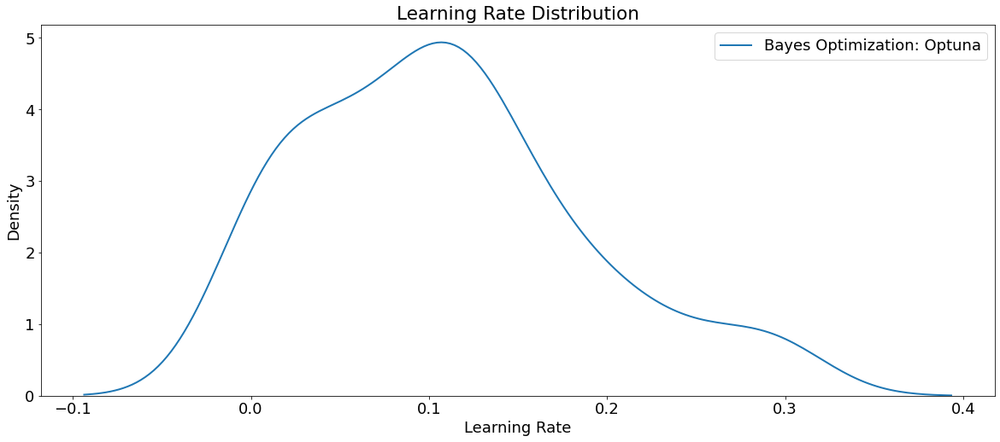

In [ ]:
# Density plots of the learning rate distributions 
plt.figure(figsize=(20,8))
plt.rcParams['font.size'] = 18
sns.kdeplot(trials_df['learning_rate'], label='Bayes Optimization: Optuna', 
            linewidth=2)
plt.legend(loc=1)
plt.xlabel('Learning Rate'); plt.ylabel('Density'); plt.title('Learning Rate Distribution');
plt.show()

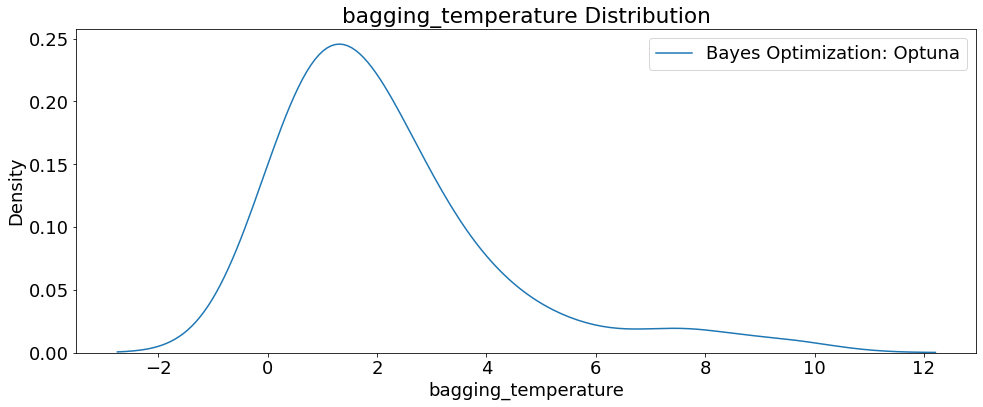

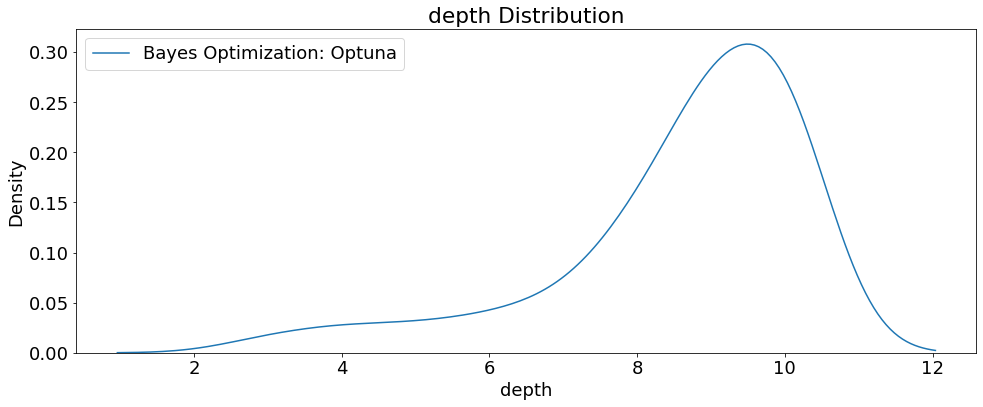

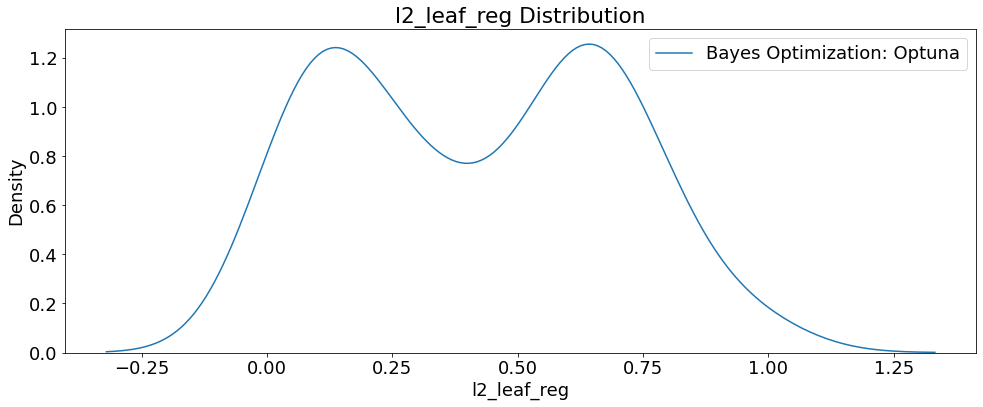

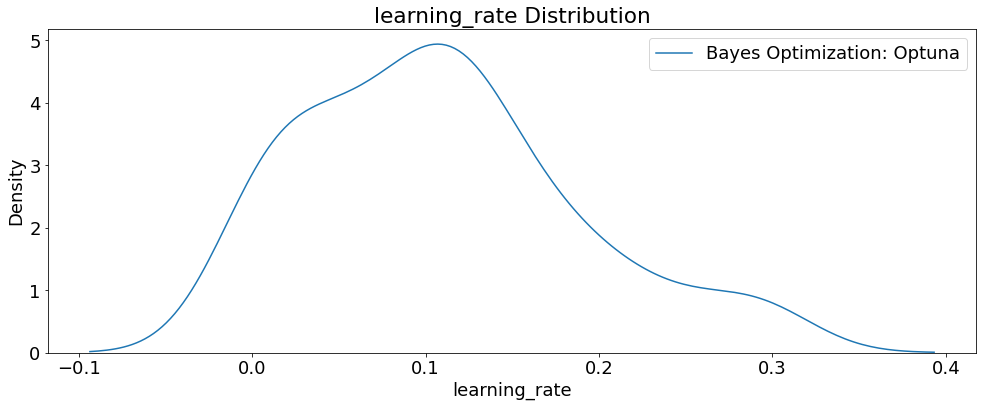

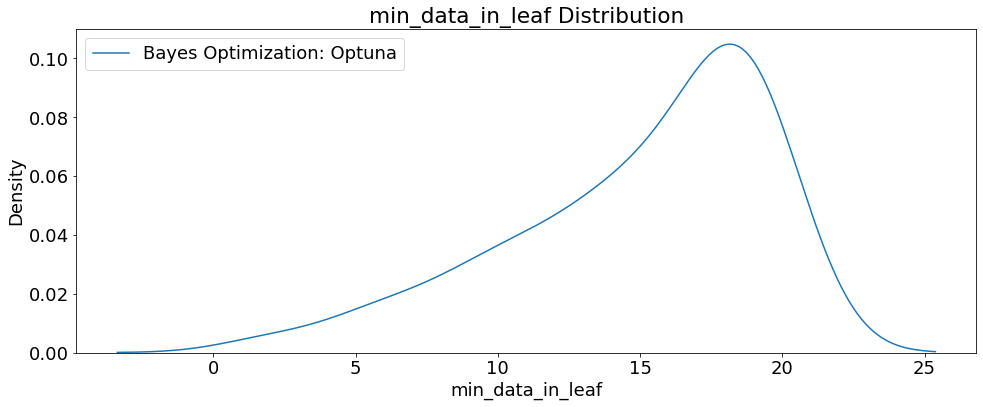

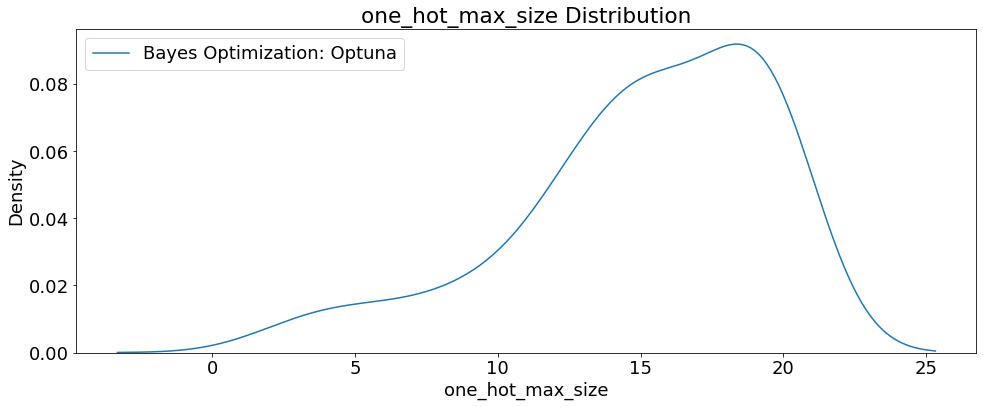

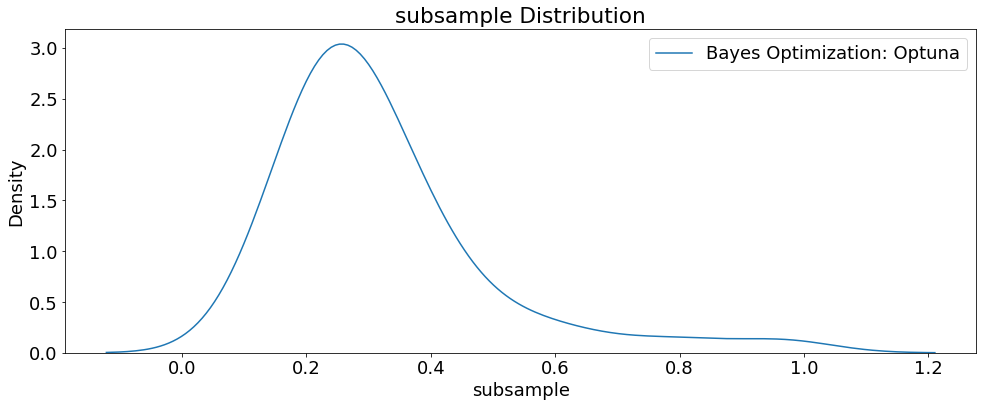

In [ ]:
# Create plots of Hyperparameters that are numeric 
for i, hpo in enumerate(trials_df.columns):
    if hpo not in ['iteration', 'rmse', 'datetime_start', 'datetime_complete',
                   'duration', 'n_estimators', 'state', 'boosting_type',
                   'bootstrap_type']:
        plt.figure(figsize=(14,6))
        # Plot the bayes search distribution
        if hpo != 'loss':
            sns.kdeplot(trials_df[hpo], label='Bayes Optimization: Optuna')
            plt.legend(loc=0)
            plt.title('{} Distribution'.format(hpo))
            plt.xlabel('{}'.format(hpo)); plt.ylabel('Density')
            plt.tight_layout()
            plt.show()

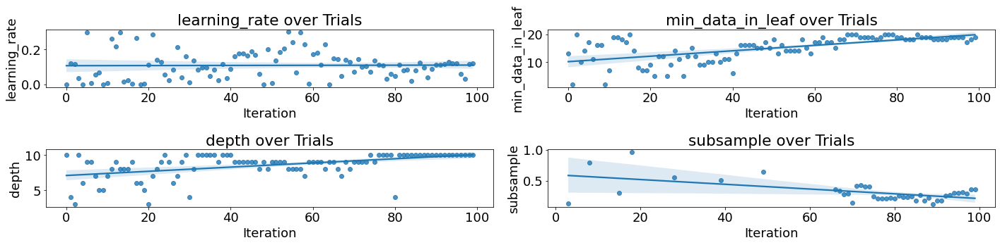

In [ ]:
# Plot quantitive hyperparameters
fig, axs = plt.subplots(2, 2, figsize=(20,5))
i = 0
axs = axs.flatten()
for i, hpo in enumerate(['learning_rate', 'min_data_in_leaf', 
                         'depth', 'subsample']):
  # Scatterplot
  sns.regplot('iteration', hpo, data=trials_df, ax=axs[i]) 
  axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo),  
             title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

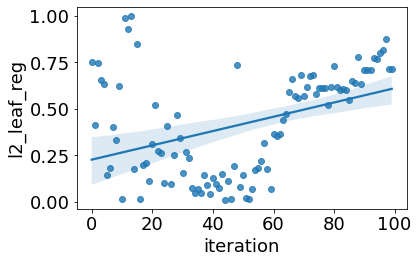

In [ ]:
# Scatterplot of regularization hyperparameters
ax = sns.regplot(x='iteration', y='l2_leaf_reg', data=trials_df)
plt.tight_layout()
plt.show()

In [ ]:
# Visualize parameter importances
fig = optuna.visualization.plot_param_importances(study)
py.plot(fig, filename='paramImportance_Catboost_Optuna_100_GPU_wb_trainTestPool_P5000_cuml.html')
fig.show()

In [ ]:
# Visualize empirical distribution function
fig = optuna.visualization.plot_edf(study)
py.plot(fig, filename='edf_Catboost_Optuna_100_GPU_wb_ttrainTestPool_P5000_cuml.html')
fig.show()

In [ ]:
# Arrange best parameters to fit model for model metrics
params = study.best_params   
params['random_state'] = seed_value
params

{'n_estimators': 453,
 'learning_rate': 0.11978628970453274,
 'depth': 10,
 'l2_leaf_reg': 0.7689710328606357,
 'min_data_in_leaf': 19,
 'one_hot_max_size': 19,
 'boosting_type': 'Plain',
 'bootstrap_type': 'Bernoulli',
 'subsample': 0.30225770931491835,
 'random_state': 42}

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/Catboost/Optuna/Model_PKL/

/notebooks/UsedCarsCarGurus/Models/ML/Catboost/Optuna/Model_PKL


In [ ]:
# Re-create the best model and train on the training data
best_model = CatBoostRegressor(loss_function='RMSE', 
                               task_type='GPU',
                               early_stopping_rounds=10, 
                               rsm=1, 
                               logging_level='Silent', 
                               **params)

# Fit the model
best_model.fit(train_features, train_label)

# Save model
Pkl_Filename = 'Catboost_Optuna_trials100_GPU_wb_trainTestPool_P5000_cuml.pkl'  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(best_model, file)

# =============================================================================
# # To load saved model
# model = joblib.load('Catboost_Optuna_trials100_GPU_wb_trainTestPool_P5000_cuml.pkl')
# print(model)
# =============================================================================

In [ ]:
print('\nModel Metrics for Catboost HPO 100 GPU trials')
y_train_pred = best_model.predict(train_features)
y_test_pred = best_model.predict(test_features)

print('MAE train: %.3f, test: %.3f' % (
        mean_absolute_error(train_label, y_train_pred),
        mean_absolute_error(test_label, y_test_pred)))
print('MSE train: %.3f, test: %.3f' % (
        mean_squared_error(train_label, y_train_pred),
        mean_squared_error(test_label, y_test_pred)))
print('RMSE train: %.3f, test: %.3f' % (
        mean_squared_error(train_label, y_train_pred, squared=False),
        mean_squared_error(test_label, y_test_pred, squared=False)))
print('R^2 train: %.3f, test: %.3f' % (
        r2_score(train_label, y_train_pred),
        r2_score(test_label, y_test_pred)))


Model Metrics for Catboost HPO 100 GPU trials
MAE train: 1698.072, test: 1841.462
MSE train: 5113771.508, test: 6114043.272
RMSE train: 2261.365, test: 2472.659
R^2 train: 0.944, test: 0.933


In [ ]:
# Evaluate on the testing data 
print('The best model from optimization scores {:.5f} MSE on the test set.'.format(mean_squared_error(asnumpy(test_label), 
                                                                                                      asnumpy(y_test_pred))))
print('This was achieved using these conditions:')
print(trials_df.iloc[0])

The best model from optimization scores 6114043.27198 MSE on the test set.
This was achieved using these conditions:
iteration                                      94
rmse                                  2475.285315
datetime_start         2023-01-13 13:16:10.981710
datetime_complete      2023-01-13 13:16:32.119973
duration                   0 days 00:00:21.138263
bagging_temperature                           NaN
boosting_type                               Plain
bootstrap_type                          Bernoulli
depth                                          10
l2_leaf_reg                              0.768971
learning_rate                            0.119786
min_data_in_leaf                               19
n_estimators                                  453
one_hot_max_size                               19
subsample                                0.302258
state                                    COMPLETE
Name: 94, dtype: object


## 100 Trials Train/Validation/Test Pool

In [ ]:
# Create pool of train/test sets
train_data = Pool(train_Features, train_Label)
eval_data = Pool(val_features, val_label)

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/Catboost/Optuna/Model_PKL

/notebooks/UsedCarsCarGurus/Models/ML/Catboost/Optuna/Model_PKL


In [ ]:
wandb.login()

wandb_kwargs = {'project': 'usedCars_hpo', 'entity': 'aschultz', 
                'group': 'optuna_cat100gpu_P5000_trainValTestPool_cuml', 
                'save_code': 'False', 
                'notes': 'optuna_cat100gpu_P5000_trainValTestPool_cuml'}
wandbc = WeightsAndBiasesCallback(wandb_kwargs=wandb_kwargs, as_multirun=True)

In [ ]:
# Set up WB callbacks
@wandbc.track_in_wandb()

# Define a function for optimization of hyperparameters
def objective(trial):
    """
    Objective function to tune a `CatBoostRegressor` model.
    """
    joblib.dump(study, 'Cat_Optuna_100_GPU_wb_trainValTest_P5000_cuml.pkl')

# Define parameter grid
    catboost_tune_kwargs = {
        'random_state': seed_value,
        'task_type':'GPU',
        'n_estimators': trial.suggest_int('n_estimators', 100, 500),
        'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 0.3),       
        'depth': trial.suggest_int('depth', 3, 10),
        'l2_leaf_reg': trial.suggest_float('l2_leaf_reg', 1e-2, 1e0),
        'min_data_in_leaf': trial.suggest_int('min_data_in_leaf', 2, 20),
        'one_hot_max_size': trial.suggest_int('one_hot_max_size', 2, 20), 
        'boosting_type': trial.suggest_categorical('boosting_type', 
                                                   ['Ordered', 'Plain']),
        'bootstrap_type': trial.suggest_categorical('bootstrap_type', 
                                                    ['Bayesian', 'Bernoulli', 
                                                     'MVS'])
        }   

    # Conditional Hyperparameters
    if catboost_tune_kwargs['bootstrap_type'] == 'Bayesian':
      catboost_tune_kwargs['bagging_temperature'] = trial.suggest_float('bagging_temperature', 
                                                                        0, 10)
    elif catboost_tune_kwargs['bootstrap_type'] == 'Bernoulli':
      catboost_tune_kwargs['subsample'] = trial.suggest_float('subsample', 
                                                              0.1, 1)
    
    # Define model type
    model = CatBoostRegressor(loss_function='RMSE', 
                              early_stopping_rounds=10,
                              rsm=1, 
                              logging_level='Silent',
                              **catboost_tune_kwargs)

    # Start timer for each trial
    start = timer()
    
    # Train the model
    model.fit(X=train_data, eval_set=eval_data) 
    run_time = timer() - start

    # Predictions
    y_pred_val = model.predict(val_features)
    rmse = mean_squared_error(asnumpy(val_label), asnumpy(y_pred_val), 
                              squared=False)
    print('- Trial RMSE:', rmse)  
    
    return rmse

In [ ]:
# Begin HPO trials 
# Start timer for experiment
start_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
if os.path.isfile('Cat_Optuna_100_GPU_wb_trainValTest_P5000_cuml.pkl'):
    study = joblib.load('Cat_Optuna_100_GPU_wb_trainValTest_P5000_cuml.pkl')
else:
    study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=100, callbacks=[wandbc])

# End timer for experiment
end_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
print('%-20s %s' % ('End Time', end_time))
print(str(timedelta(seconds=(end_time-start_time).seconds)))
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Lowest RMSE', study.best_value)
wandb.finish()

Start Time           2023-01-13 13:24:47.410873


- Trial RMSE: 9308.772346430407


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 9124.595968673291


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 7987.215253092466


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,2.97541
boosting_type,Plain


- Trial RMSE: 9422.32849681401


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,MVS
depth,7


- Trial RMSE: 5051.190984573248


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 3940.504062584411


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2769.171321878983


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,MVS
depth,8


- Trial RMSE: 2460.499078024582


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 6689.14956597791


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 7418.641820077397


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,MVS
depth,9


- Trial RMSE: 3724.3889681280693


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,9.14648
boosting_type,Plain


- Trial RMSE: 2827.968586363974


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,MVS
depth,8


- Trial RMSE: 2675.610814549239


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,MVS
depth,10


- Trial RMSE: 2762.1522741746826


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,MVS
depth,10


- Trial RMSE: 4489.356452414972


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,0.34882
boosting_type,Plain


- Trial RMSE: 2775.7205368194295


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2751.6509264887522


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,MVS
depth,9


- Trial RMSE: 2702.963915678536


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 8849.806004115175


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,MVS
depth,6


- Trial RMSE: 3381.722729790204


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,9.50526
boosting_type,Plain


- Trial RMSE: 2747.5358965202113


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,MVS
depth,9


- Trial RMSE: 2944.0483054035976


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2634.650219495256


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2871.939052037775


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2534.641129003849


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2622.1905722847455


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2600.725316367741


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2788.8069550164014


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 3276.2051881253155


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2650.974005985499


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 9112.877091039594


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2578.8105690202956


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2578.6355803918027


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2668.118778597405


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2564.2509280655895


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 3709.728456789634


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2533.1045636001786


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2747.658142072787


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,5.54773
boosting_type,Ordered


- Trial RMSE: 2690.3342045173545


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2517.2246365418373


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2926.769602933394


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2529.161952159081


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2518.700358697931


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2513.4026296289417


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2649.1872822026826


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2719.71158665742


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,5.52808
boosting_type,Ordered


- Trial RMSE: 2595.3575432926127


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 8237.867432993238


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2513.191110509144


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 4331.858449653617


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2618.8368728998103


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2517.3171920006102


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2525.3315107031726


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2545.018739778278


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,0.24645
boosting_type,Ordered


- Trial RMSE: 2549.838317693877


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2539.8696016118856


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 4181.232547165676


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,MVS
depth,9


- Trial RMSE: 2793.0621853363305


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2538.078608435002


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2608.153174947083


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 7124.746183484285


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,7.23688
boosting_type,Ordered


- Trial RMSE: 2524.7089676036626


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2532.9174155216383


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2580.581538408007


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2519.6822429669974


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 3141.3919750729897


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,MVS
depth,4


- Trial RMSE: 2716.156891893044


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2567.6966391615492


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Ordered
bootstrap_type,Bernoulli


- Trial RMSE: 2467.593689546741


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2490.1590006125957


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 9257.363462915357


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2468.724036271659


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2459.6900442584924


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2469.9251378711433


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2538.223151522698


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2489.830341944525


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2798.706822205622


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2784.5024432126384


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,MVS
depth,10


- Trial RMSE: 2478.0498633085526


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2626.121469315988


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2484.1128700165077


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2488.108762518307


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2497.6622740684297


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2532.841657827018


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2477.9463013150653


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2503.0808512153103


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2618.4814683431277


bagging_temperature,▁
depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
bagging_temperature,2.7044
boosting_type,Plain


- Trial RMSE: 3008.4239312184754


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2473.4462898398533


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2616.733125750471


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 3428.7009866804606


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2487.99615422171


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2474.169739071282


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2469.9969000385827


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2467.6800987874435


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2537.9840758712617


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2464.561863463849


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2471.411937429412


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


- Trial RMSE: 2704.9858440116654


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,MVS
depth,9


- Trial RMSE: 2470.751647787121


depth,▁
l2_leaf_reg,▁
learning_rate,▁
min_data_in_leaf,▁
n_estimators,▁
one_hot_max_size,▁
subsample,▁
trial_number,▁
value,▁
boosting_type,Plain
bootstrap_type,Bernoulli


Start Time           2023-01-13 13:24:47.410873
End Time             2023-01-13 14:32:08.237905
1:07:20


Number of finished trials: 100
Best trial: {'n_estimators': 449, 'learning_rate': 0.16029930564599867, 'depth': 10, 'l2_leaf_reg': 0.8046709392181282, 'min_data_in_leaf': 19, 'one_hot_max_size': 10, 'boosting_type': 'Plain', 'bootstrap_type': 'Bernoulli', 'subsample': 0.4711180149767001}
Lowest RMSE 2459.6900442584924


In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/Catboost/Optuna/trialOptions/

/notebooks/UsedCarsCarGurus/Models/ML/Catboost/Optuna/trialOptions


In [ ]:
# Output from HPO trials
trials_df = study.trials_dataframe()
trials_df.rename(columns={'number': 'iteration'}, inplace=True)
trials_df.rename(columns={'value': 'rmse'}, inplace=True)
trials_df.rename(columns={'params_bagging_temperature': 'bagging_temperature'}, 
                 inplace=True)
trials_df.rename(columns={'params_boosting_type': 'boosting_type'}, 
                 inplace=True)
trials_df.rename(columns={'params_bootstrap_type': 'bootstrap_type'}, 
                 inplace=True)
trials_df.rename(columns={'params_depth': 'depth'}, inplace=True)
trials_df.rename(columns={'params_l2_leaf_reg': 'l2_leaf_reg'}, inplace=True)
trials_df.rename(columns={'params_learning_rate': 'learning_rate'}, 
                 inplace=True)
trials_df.rename(columns={'params_min_data_in_leaf': 'min_data_in_leaf'}, 
                 inplace=True)
trials_df.rename(columns={'params_n_estimators': 'n_estimators'}, inplace=True)
trials_df.rename(columns={'params_one_hot_max_size': 'one_hot_max_size'}, 
                 inplace=True)
trials_df.rename(columns={'params_subsample': 'subsample'}, inplace=True)
trials_df = trials_df.sort_values('rmse', ascending=True)
print(trials_df) 

# Write processed data to csv
trials_df.to_csv('Catboost_Optuna_100_GPU_wb_trainValTestPool_P5000_cuml.csv', 
                 index=False)

    iteration         rmse             datetime_start  \
72         72  2459.690044 2023-01-13 14:16:32.466022   
7           7  2460.499078 2023-01-13 13:28:20.518922   
96         96  2464.561863 2023-01-13 14:30:05.980420   
68         68  2467.593690 2023-01-13 14:14:21.320238   
94         94  2467.680099 2023-01-13 14:29:10.734352   
..        ...          ...                        ...   
30         30  9112.877091 2023-01-13 13:41:46.698914   
1           1  9124.595969 2023-01-13 13:25:30.177022   
70         70  9257.363463 2023-01-13 14:15:21.369639   
0           0  9308.772346 2023-01-13 13:24:47.414206   
3           3  9422.328497 2023-01-13 13:26:30.829680   

            datetime_complete               duration  bagging_temperature  \
72 2023-01-13 14:16:52.955566 0 days 00:00:20.489544                  NaN   
7  2023-01-13 13:28:45.659086 0 days 00:00:25.140164                  NaN   
96 2023-01-13 14:30:31.497464 0 days 00:00:25.517044                  NaN   
68 2023

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/Catboost/Optuna/Model_Explanations/

/notebooks/UsedCarsCarGurus/Models/ML/Catboost/Optuna/Model_Explanations


In [ ]:
# Plot_optimization_histor: shows the scores from all trials as well as the best score so far at each point.
fig = optuna.visualization.plot_optimization_history(study)
py.plot(fig, filename='optimizationHistory_Catboost_Optuna_100_GPU_wb_trainValTestPool_P5000_cuml.html')
fig.show()

In [ ]:
# plot_parallel_coordinate: interactively visualizes the hyperparameters and scores
fig = optuna.visualization.plot_parallel_coordinate(study)
py.plot(fig, filename='parallelCoordinate_Catboost_Optuna_100_GPU_wb_trainValTestPool_P5000_cuml.html')
fig.show()

[W 2023-01-13 14:32:08,479] Your study has only completed trials with missing parameters.


In [ ]:
# plot_slice: shows the change of the hyperparameters space over the search. 
fig = optuna.visualization.plot_slice(study)
py.plot(fig, filename='slice_Catboost_Optuna_100_GPU_wb_trainValTestPool_P5000_cuml.html')
fig.show()

In [ ]:
# plot_contour: plots parameter interactions on an interactive chart
fig = optuna.visualization.plot_contour(study, params=['depth', 
                                                       'subsample', 
                                                       'learning_rate', 
                                                       'subsample'])
py.plot(fig, filename='contour_Catboost_Optuna_100_GPU_wb_trainValTestPool_P5000_cuml.html')
fig.show()

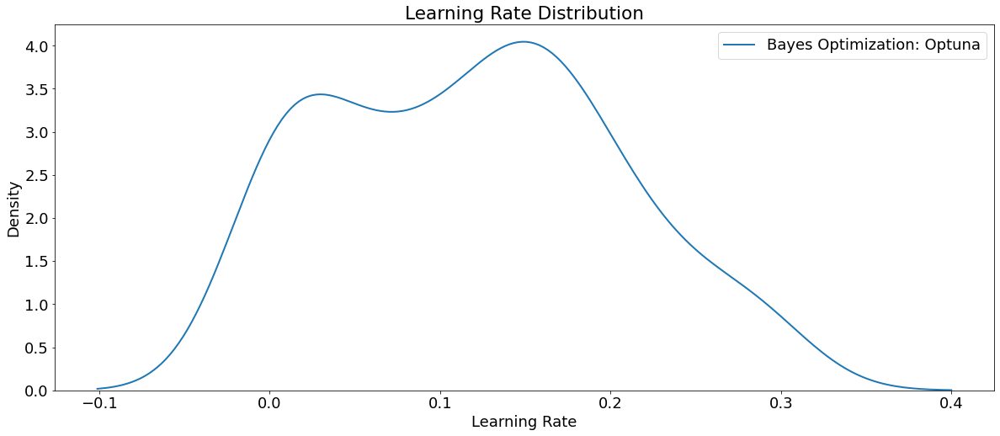

In [ ]:
# Density plots of the learning rate distributions 
plt.figure(figsize=(20,8))
plt.rcParams['font.size'] = 18
sns.kdeplot(trials_df['learning_rate'], label='Bayes Optimization: Optuna', 
            linewidth=2)
plt.legend(loc=1)
plt.xlabel('Learning Rate'); plt.ylabel('Density'); plt.title('Learning Rate Distribution');
plt.show()

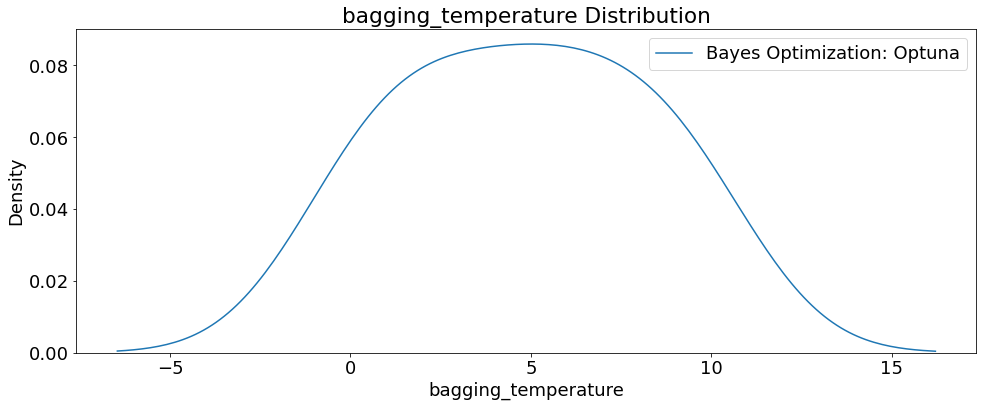

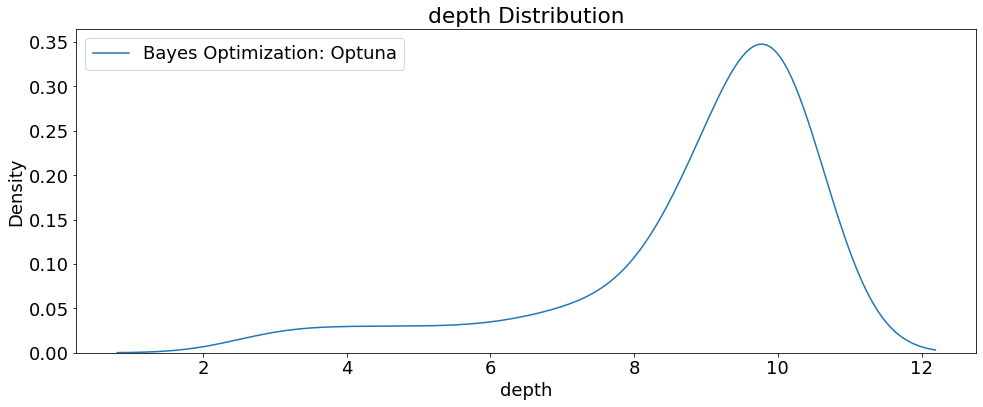

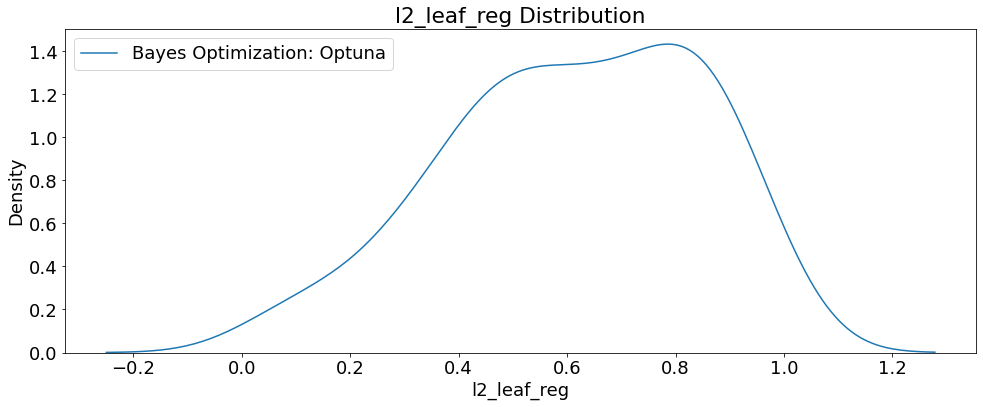

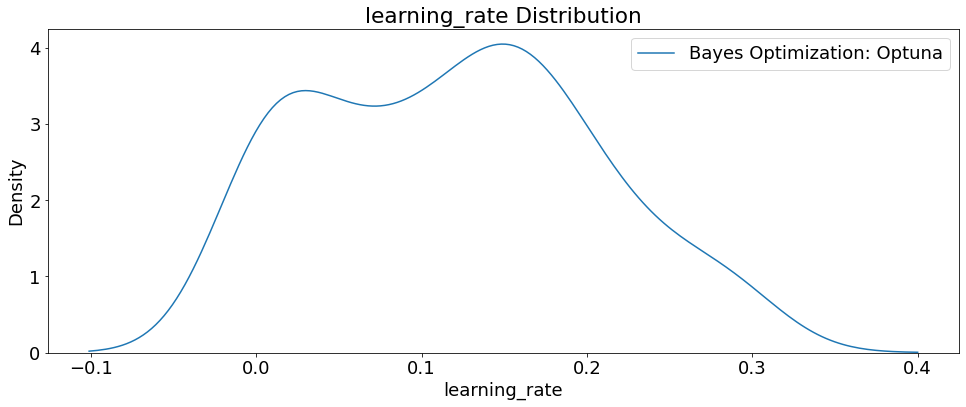

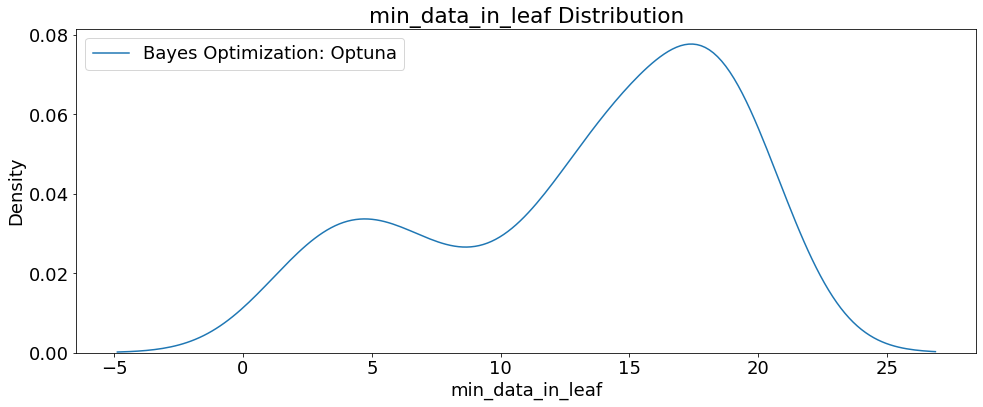

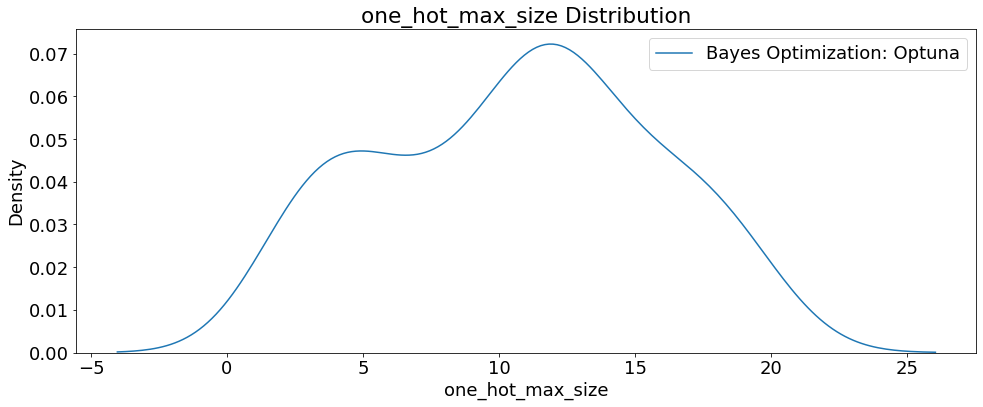

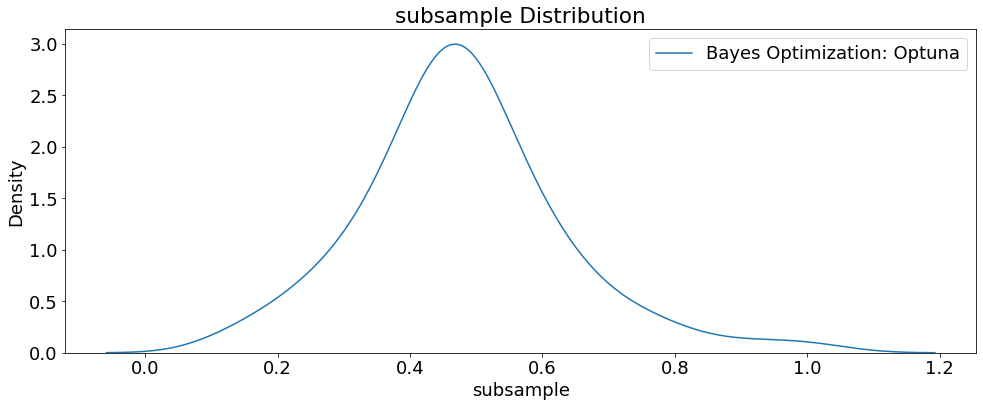

In [ ]:
# Create plots of Hyperparameters that are numeric 
for i, hpo in enumerate(trials_df.columns):
    if hpo not in ['iteration', 'rmse', 'datetime_start', 'datetime_complete',
                   'duration', 'n_estimators', 'state', 'boosting_type',
                   'bootstrap_type']:
        plt.figure(figsize=(14,6))
        # Plot the bayes search distribution
        if hpo != 'loss':
            sns.kdeplot(trials_df[hpo], label='Bayes Optimization: Optuna')
            plt.legend(loc=0)
            plt.title('{} Distribution'.format(hpo))
            plt.xlabel('{}'.format(hpo)); plt.ylabel('Density')
            plt.tight_layout()
            plt.show()

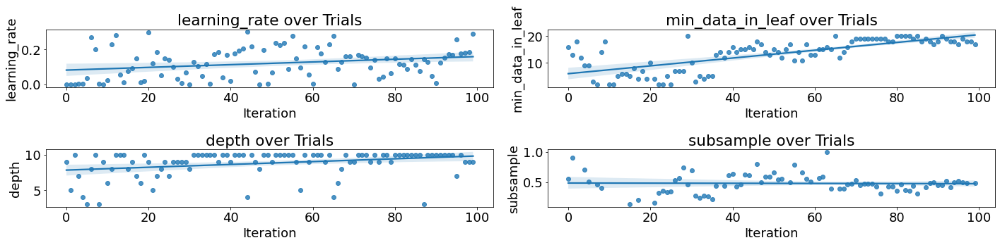

In [ ]:
# Plot quantitive hyperparameters
fig, axs = plt.subplots(2, 2, figsize=(20,5))
i = 0
axs = axs.flatten()
for i, hpo in enumerate(['learning_rate', 'min_data_in_leaf', 
                         'depth', 'subsample']):
  # Scatterplot
  sns.regplot('iteration', hpo, data=trials_df, ax=axs[i]) 
  axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo),  
             title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

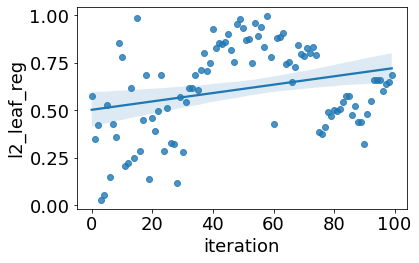

In [ ]:
# Scatterplot of regularization hyperparameters
ax = sns.regplot(x='iteration', y='l2_leaf_reg', data=trials_df)
plt.tight_layout()
plt.show()

In [ ]:
# Visualize parameter importances
fig = optuna.visualization.plot_param_importances(study)
py.plot(fig, filename='paramImportance_Catboost_Optuna_100_GPU_wb_trainValTestPool_P5000_cuml.html')
fig.show()

In [ ]:
# Visualize empirical distribution function
fig = optuna.visualization.plot_edf(study)
py.plot(fig, filename='edf_Catboost_Optuna_100_GPU_wb_trainValTestPool_P5000_cuml.html')
fig.show()

In [ ]:
# Arrange best parameters to fit model for model metrics
params = study.best_params   
params['random_state'] = seed_value
params

{'n_estimators': 449,
 'learning_rate': 0.16029930564599867,
 'depth': 10,
 'l2_leaf_reg': 0.8046709392181282,
 'min_data_in_leaf': 19,
 'one_hot_max_size': 10,
 'boosting_type': 'Plain',
 'bootstrap_type': 'Bernoulli',
 'subsample': 0.4711180149767001,
 'random_state': 42}

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/Catboost/Optuna/Model_PKL/

/notebooks/UsedCarsCarGurus/Models/ML/Catboost/Optuna/Model_PKL


In [ ]:
# Re-create the best model and train on the training data
best_model = CatBoostRegressor(loss_function='RMSE', 
                               task_type='GPU',
                               early_stopping_rounds=10, 
                               rsm=1, 
                               logging_level='Silent', 
                               **params)

# Fit the model
best_model.fit(train_features, train_label)

# Save model
Pkl_Filename = 'Catboost_Optuna_trials100_GPU_wb_trainValTestPool_P5000_cuml.pkl'  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(best_model, file)

# =============================================================================
# # To load saved model
# model = joblib.load('Catboost_Optuna_trials100_GPU_wb_trainValTestPool_P5000_cuml.pkl')
# print(model)
# =============================================================================

In [ ]:
print('\nModel Metrics for Catboost HPO 100 GPU trials')
y_train_pred = best_model.predict(train_features)
y_test_pred = best_model.predict(test_features)

print('MAE train: %.3f, test: %.3f' % (
        mean_absolute_error(train_label, y_train_pred),
        mean_absolute_error(test_label, y_test_pred)))
print('MSE train: %.3f, test: %.3f' % (
        mean_squared_error(train_label, y_train_pred),
        mean_squared_error(test_label, y_test_pred)))
print('RMSE train: %.3f, test: %.3f' % (
        mean_squared_error(train_label, y_train_pred, squared=False),
        mean_squared_error(test_label, y_test_pred, squared=False)))
print('R^2 train: %.3f, test: %.3f' % (
        r2_score(train_label, y_train_pred),
        r2_score(test_label, y_test_pred)))


Model Metrics for Catboost HPO 100 GPU trials
MAE train: 1625.966, test: 1814.343
MSE train: 4709155.792, test: 5977307.972
RMSE train: 2170.059, test: 2444.853
R^2 train: 0.949, test: 0.934


In [ ]:
# Evaluate on the testing data 
print('The best model from optimization scores {:.5f} MSE on the test set.'.format(mean_squared_error(asnumpy(test_label), 
                                                                                                      asnumpy(y_test_pred))))
print('This was achieved using these conditions:')
print(trials_df.iloc[0])

The best model from optimization scores 5977307.97218 MSE on the test set.
This was achieved using these conditions:
iteration                                      72
rmse                                  2459.690044
datetime_start         2023-01-13 14:16:32.466022
datetime_complete      2023-01-13 14:16:52.955566
duration                   0 days 00:00:20.489544
bagging_temperature                           NaN
boosting_type                               Plain
bootstrap_type                          Bernoulli
depth                                          10
l2_leaf_reg                              0.804671
learning_rate                            0.160299
min_data_in_leaf                               19
n_estimators                                  449
one_hot_max_size                               10
subsample                                0.471118
state                                    COMPLETE
Name: 72, dtype: object
